In [1]:
import os

import numpy as np
import pandas as pd

import anndata
import scanpy as sc

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection
from matplotlib import gridspec
import matplotlib as mpl
import seaborn as sns

from collections import defaultdict
import random
import itertools
from numpy import * 

In [2]:
import sys
sys.path.append('/home/yike/phd/dengue/dengue_children') #enter the YK_util file directory
sys.path.append('/home/yike/phd/dengue/dengue_children/paper_figures') #enter the YK_util file directory
import YK_util, optimized_pair_comparison_new, functions_CCC_figure_fra_pair
from YK_util import *
from optimized_pair_comparison_new import *
from functions_CCC_figure_fra_pair import *

ct_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_data_pair_gene_cut_0.tsv', sep='\t', index_col=['cell_subtype', 'gene'])
ct_log2FC = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_log2FC_gene_cut_0.tsv', sep='\t', index_col=0)

cst_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_data_pair_gene_cut_0.tsv', sep='\t', index_col=['cell_subtype', 'gene'])
cst_log2FC = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_log2FC_gene_cut_0.tsv', sep='\t', index_col=0)

In [3]:
path = '/home/yike/phd/dengue/data/mergedata_20211001_Treg.h5ad'
adata = sc.read_h5ad(path)
adata_kid = subsetdata(adata)
adata_kid = normalizedata(adata_kid, log1p=True) # log1p = 2
adata_kid = removegenes(adata_kid)

/usr/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [4]:
print('Load interaction') 

fn_int = '/home/yike/phd/dengue/data/interaction_source_file/omni_DB_inters.tsv'
interactions = pd.read_csv(fn_int, sep='\t')
inter_genes = np.unique(interactions[['genesymbol_intercell_source', 'genesymbol_intercell_target']])
inter_genes = [gene for gene in inter_genes if gene in adata_kid.var_names]

def check_inters(gene):
    inters = interactions[(interactions['genesymbol_intercell_source'] == gene) | 
             (interactions['genesymbol_intercell_target'] == gene)]
    return inters

save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/NK_cells/'
save_figures = '/home/yike/phd/dengue/figures/paper_figure/dataset_20211001/NK_cells/'

# its = []
# for gene in ['KIR2DL4', 'LILRB1', 'LILRB2']:
#     its.append(['HLA-G', gene])
    
# its = pd.DataFrame(its, columns=['genesymbol_intercell_source', 'genesymbol_intercell_target'])
# interactions = pd.concat([interactions, its])
# interactions.to_csv(fn_int, sep='\t', index=False)

Load interaction


In [5]:
from collections import defaultdict
ratio = {}
for cd in ['Healthy', 'dengue', 'DWS', 'S_dengue']:
    adata_cd = adata_kid[(adata_kid.obs['Condition'] == cd)]
    ids = adata_cd.obs['ID'].unique()
    f = []
    for ID in ids:
        n_NK = adata_cd[(adata_cd.obs['cell_type_new'] == 'NK_cells') & (adata_cd.obs['ID'] == ID)].obs.shape[0]
        n_DC = adata_cd[(adata_cd.obs['cell_type_new'] == 'conventional DCs') & (adata_cd.obs['ID'] == ID)].obs.shape[0]
        f.append((n_NK + 1)/(n_DC + 1))
    ratio[cd] = np.median(f)

In [22]:
cts = ['B_cells',
             'T_cells',
             'NK_cells',
             'Monocytes',
             'Plasmablasts',
             'plasmacytoid DCs',
             'conventional DCs',
             'megakaryocytes']

csts = ['naive B cells',
                 'activated B cells',
                 'memory B cells',
                 'XCL_low NK cells',
                 'XCL_high NK cells',
                 'CD8+ effector T cells',
                 'CD8+ naive/memory T cells',
                 'CD4+ T cells',
                 'macrophages',
                 'non_classical monocytes',
                 'classical monocytes',
                 'non_cycling Plasmablasts',
                 'cycling Plasmablasts',
                 ]
    
def pairwise_processing(df_kid, df_adult):
    ###### merge two df
    intersect = [x for x in df_kid.index if x in df_adult.index]
    df_adult.columns = [col+'_a' for col in df_adult.columns]
    df = pd.concat([df_kid.loc[intersect], df_adult.loc[intersect]], axis=1)
    
    ###### define robost genes for kids, adults or both
    ind_kid = df[(df['fra_pair'] >= 39/56) | (df['neg_fra_pair'] >= 39/56)].index
    ind_adult = df[(df['fra_pair_a'] >= 39/56) | (df['neg_fra_pair_a'] >= 39/56)].index
    ind_merge = list(set(ind_kid) & set(ind_adult))
    
    df['outlier'] = 'no'
    df.loc[ind_kid, 'outlier'] = 'x_only'
    df.loc[ind_adult, 'outlier'] = 'y_only'
    df.loc[ind_merge, 'outlier'] = 'both'
    
    ###### calculate marker and distance
    df['x'] = df['med_pair'] - df['med_pair'].mean()
    df['y'] = df['med_pair_a'] - df['med_pair_a'].mean()
    df['r'] = np.sqrt(df['x'] ** 2 + df['y'] ** 2)
    
    ###### set markers for genes
    df_2 = df[df['r'] >= df['r'].quantile(q = 0.95)] 
    r = df_2.sort_values('r').iloc[0]['r']

    df['markers'] = 'no'
        
    df.loc[df_2[(df_2['x'] > 1) & (df_2['y'] > 1)].index, 'markers'] = '1'
    df.loc[df_2[(df_2['x'] < -1) & (df_2['y'] > 1)].index, 'markers'] = '2'
    df.loc[df_2[(df_2['x'] < -1) & (df_2['y'] < -1)].index, 'markers'] = '3'
    df.loc[df_2[(df_2['x'] > 1) & (df_2['y'] < -1)].index, 'markers'] = '4'

    df.loc[df_2[(df_2['x'] > 1) & (df_2['y'] < 1) & (df_2['y'] > -1)].index, 'markers'] = '5'
    df.loc[df_2[(df_2['y'] > 1) & (df_2['x'] < 1) & (df_2['x'] > -1)].index, 'markers'] = '6'
    df.loc[df_2[(df_2['x'] < -1) & (df_2['y'] < 1) & (df_2['y'] > -1)].index, 'markers'] = '7'
    df.loc[df_2[(df_2['y'] < -1) & (df_2['x'] < 1) & (df_2['x'] > -1)].index, 'markers'] = '8'
    return (df, r)

def scatter_pairwise(df, r, marklist, xlim=4.2, name=False):
    ###### plot scatter_pairwise
    import matplotlib as mpl

    fig, ax = plt.subplots(figsize=(4, 4), dpi=300)
    
    sns.scatterplot(data=df, x='med_pair', y='med_pair_a', ax=ax, hue='markers', 
                     hue_order=['1', '2', '3', '4', '5', '6', '7', '8', 'no'],
                     palette=sns.color_palette('hls',8) + ['gray'], 
                     edgecolor='none', s=3)
    sns.set_style('ticks')

    mark_list = marklist
    for gene in mark_list:
        ax.text(df.loc[gene, 'med_pair']-0.6, 
        df.loc[gene, 'med_pair_a'] + 0.005,
        gene, color = 'black',
        fontsize = 4)

    ax.set_xlim(-xlim, xlim)
    ax.set_ylim(-xlim, xlim)

    # Draw 8 slices using Fabio's function 
    x_mean = df['med_pair'].mean()
    y_mean = df['med_pair_a'].mean()
    center = (x_mean, y_mean)
    
    if r >= 1:
        draw_8_slices(ax, center, radius=r)
    else:
        draw_8_slices(ax, center, radius=1)

    #draw_8_slices(ax, center, radius=r)
    ax.set_xlabel('XCL low NK cells', fontsize=10)
    ax.set_ylabel('XCL high NK cells', fontsize=10)

    ax.set_title('Median log2 fold change of \npairwise comparison (SD vs D)', fontsize=10)
    ax.get_legend().remove()
    
    ticklabels = range(-int(xlim), int(xlim)+1, 2)
    ax.set_xticks(ticklabels)
    ax.set_yticks(ticklabels)
    ax.set_xticklabels(ticklabels, fontsize=10)
    ax.set_yticklabels(ticklabels, fontsize=10)
    
    if name is not False:
        filename = save_figures + name
        fig.savefig(filename, bbox_inches = 'tight', dpi=300)
    
    return {'figure': fig, 'ax': ax}

#Fabio's function
def draw_8_slices(ax, center, radius=1):
    def cp(amin, amax, center, ndots=100):
        xc, yc = center
        angles = np.linspace(amin, amax, ndots)
        xcircs, ycircs = xc + radius * np.cos(angles), yc + radius * np.sin(angles)
        return [(xi, yi) for xi, yi in zip(xcircs, ycircs)][::-1]

    def draw_wedge(ax, points, color):
        points = np.array(points)
        center = points.mean(axis=0)
        delta = points - center
        points = center + 0.99 * delta

        rgb = list(mpl.colors.to_rgba(color)[:-1])
        #rgba_edge = tuple(rgb + [0.6])
        rgba_fill = tuple(rgb + [0.2])
        ax.add_artist(plt.Polygon(
            points, edgecolor='none', facecolor=rgba_fill, lw=0.2,
            clip_on=False,
            ))

    xc, yc = center
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()

    # Cross
    for x in [xc]:
        ax.axvline(x, ls='--', color='k', lw=0.2, zorder=0.5)
        
    for y in [yc]:
        ax.axhline(y, ls='--', color='k', lw=0.2, zorder=0.5)
    
    colors = sns.color_palette('pastel', 9)
    
    # Circle
    rgb = list(mpl.colors.to_rgba(colors[7]))[:-1]
    circle = plt.Circle(center, radius, facecolor=tuple(rgb + [0.2]), edgecolor=tuple(rgb + [0.6]), lw=0.5, ls='--')
    ax.add_artist(circle)

    # Wedges
    #1. Intersections with axes border
    xbords, ybords = [], []
    xbords.append(xmax)
    ybords.append(yc + 1)
    xbords.append(xc + 1)
    ybords.append(ymax)
    xbords.append(xc - 1)
    ybords.append(ymax)
    xbords.append(xmin)
    ybords.append(yc + 1)
    xbords.append(xmin)
    ybords.append(yc - 1)
    xbords.append(xc - 1)
    ybords.append(ymin)
    xbords.append(xc + 1)
    ybords.append(ymin)
    xbords.append(xmax)
    ybords.append(yc - 1)

    bords = np.vstack([xbords, ybords]).T
    
    # 2. wedges functions
    def wedges_1(radius, ax):
        # intersections with circle
        angles = np.array([np.arcsin(1/radius), np.arccos(1/radius), np.pi-np.arccos(1/radius), 
                           np.pi - np.arcsin(1/radius), np.pi+np.arcsin(1/radius), 
                           np.pi+np.arccos(1/radius), 2*np.pi-np.arccos(1/radius), 
                           2*np.pi-np.arcsin(1/radius)])

        xcircs, ycircs = xc + radius * np.cos(angles), yc + radius * np.sin(angles)
        circs = np.vstack([xcircs, ycircs]).T
        
        # draw wedges
        draw_wedge(ax, [circs[0], bords[0], (xmax, ymax), bords[1], circs[1]] + cp(angles[0], angles[1], center), color=colors[0])
        draw_wedge(ax, [circs[1], bords[1], bords[2], circs[2]] + cp(angles[1], angles[2], center), color=colors[1])
        draw_wedge(ax, [circs[2], bords[2], (xmin, ymax), bords[3], circs[3]] + cp(angles[2], angles[3], center), color=colors[2])
        draw_wedge(ax, [circs[3], bords[3], bords[4], circs[4]] + cp(angles[3], angles[4], center), color=colors[3])
        draw_wedge(ax, [circs[4], bords[4], (xmin, ymin), bords[5], circs[5]] + cp(angles[4], angles[5], center), color=colors[4])
        draw_wedge(ax, [circs[5], bords[5], bords[6], circs[6]] + cp(angles[5], angles[6], center), color=colors[5])
        draw_wedge(ax, [circs[6], bords[6], (xmax, ymin), bords[7], circs[7]] + cp(angles[6], angles[7], center), color=colors[6])
        draw_wedge(ax, [circs[7], bords[7], bords[0], circs[0]] + cp(angles[7], 2*np.pi+angles[0], center), color=colors[8])
    
    def wedges_2(radius, ax):
        # intersections with circle
        angles = np.array([np.arcsin(1/radius), np.arccos(1/radius), np.pi-np.arccos(1/radius), 
                           np.pi - np.arcsin(1/radius), np.pi+np.arcsin(1/radius), 
                           np.pi+np.arccos(1/radius), 2*np.pi-np.arccos(1/radius), 
                           2*np.pi-np.arcsin(1/radius)])

        xcircs, ycircs = xc + radius * np.cos(angles), yc + radius * np.sin(angles)
        circs = np.vstack([xcircs, ycircs]).T
        
        # draw wedges
        draw_wedge(ax, [circs[1], (xc+1, yc+1), bords[0], bords[7], (xc+1, yc-1), circs[6]]
                    + cp(angles[6], 2*np.pi, center)[::-1] + cp(0, angles[1], center)[::-1], color=colors[0])
        draw_wedge(ax, [circs[0], (xc+1, yc+1), bords[1], bords[2], (xc-1, yc+1), circs[3]] + cp(angles[0], angles[3], center), color=colors[2])
        draw_wedge(ax, [circs[2], (xc-1, yc+1), bords[3], bords[4], (xc-1, yc-1), circs[5]] + cp(angles[2], angles[5], center), color=colors[4])
        draw_wedge(ax, [circs[4], (xc-1, yc-1), bords[5], bords[6], (xc+1, yc-1), circs[7]] + cp(angles[4], angles[7], center), color=colors[6])
        
        # 4 squres
        dots = [
            [[xc+1, yc+1], [xmax, yc+1], [xmax, ymax], [xc+1, ymax]],
            [[xc-1, yc+1], [xc-1, ymax], [xmin, ymax], [xmin, yc+1]],
            [[xc-1, yc-1], [xmin, yc-1], [xmin, ymin], [xc-1, ymin]],
            [[xc+1, yc-1], [xmax, yc-1], [xmax, ymin], [xc+1, ymin]],
        ]
        cls = [colors[1], colors[3], colors[5],  colors[8]]
        for dot, color in zip(dots, cls):
            rgb = list(mpl.colors.to_rgba(color)[:-1])
            #rgba_edge = tuple(rgb + [0.6])
            rgba_fill = tuple(rgb + [0.2])
            e = mpatches.Polygon(np.array(dot), facecolor=rgba_fill, edgecolor='none', lw=0.2)
            ax.add_patch(e)
            
        # 4 triangles:
        draw_wedge(ax, [circs[1], (xc+1, yc+1), circs[0]] + cp(angles[1], angles[0], center), color=colors[7])
        draw_wedge(ax, [circs[3], (xc-1, yc+1), circs[2]] + cp(angles[3], angles[2], center), color=colors[7])
        draw_wedge(ax, [circs[5], (xc-1, yc-1), circs[4]] + cp(angles[5], angles[4], center), color=colors[7])
        draw_wedge(ax, [circs[7], (xc+1, yc-1), circs[6]] + cp(angles[7], angles[6], center), color=colors[7])
        
    # 3. draw wedges
    if radius >= np.sqrt(2):
        wedges_1(radius, ax)
    elif (radius < np.sqrt(2)):
        wedges_2(radius, ax)

######## boxplot
def pairwise_boxplot(FCs_data, pair_data, genes, title, path=False):
    box_data = FCs_data[genes]
    box_data = pd.melt(box_data)
    
    colors = []
    for i, gene in enumerate(genes):
        if (pair_data.loc[gene]['med_pair'] >= 1) & (pair_data.loc[gene]['fra_pair'] >= 39/56) & (pair_data.loc[gene]['S_fra'] >= 0.1):
            colors.append('Brown')
        elif (pair_data.loc[gene]['med_pair'] <= -1) & (pair_data.loc[gene]['neg_fra_pair'] >= 39/56) & (pair_data.loc[gene]['NS_fra'] >= 0.1):
            colors.append('CornflowerBlue')
        else:
            colors.append('gray')

    fig, ax = plt.subplots(dpi=300, figsize=(3, len(genes)*0.1 + 0.5))
    sns.boxplot(data = box_data, y = 'variable', x = 'value', palette = colors, orient = 'h', linewidth=1, ax=ax)
    sns.set_style('ticks')
    
    ax.set(ylabel = None, xlim = (-15, 15))
    ax.set_yticklabels(genes, fontsize=6)
    

    ax.set_title(title, fontsize=8)
    ax.set_xlabel('diff log2 fold change', fontsize=8)
    
    xticklabels = range(-15, 16, 5)
    ax.set_xticks(xticklabels)
    ax.set_xticklabels(xticklabels, fontsize=6)
    
    for x in [-1, 0, 1]:
        ax.axvline(x, c='black', ls='-.', lw=1, zorder=0.5)
    
    if path is not False:
        fig.savefig(save_figures + path, bbox_inches='tight')
        
    return {'figure': fig, 'ax': ax}

def heatmap_cst(g_list, cst_order, title, vs_type='SD vs D', save_fd=False):
    
    df = cst_pair.reset_index().set_index('gene').loc[g_list][['cell_subtype', 'med_pair']]

    #cst_order=['XCL_low NK cells', 'XCL_high NK cells']

    df_new = pd.DataFrame(np.zeros([len(df.index.unique()), len(cst_order)]), columns=cst_order, index=g_list)

    for idx in df_new.index:    
        for col in df_new.columns:
            df_new.at[idx, col] = df.loc[idx][df.loc[idx]['cell_subtype'] == col]['med_pair'][0]

    fig, ax = plt.subplots(figsize=[0.5 * len(g_list), 0.5 + 0.5 * len(cst_order)], dpi=300)
    cmap = sns.diverging_palette(245, 5, as_cmap=True)
    ax = sns.heatmap(df_new.T, cmap=cmap, center=0, yticklabels=True, square=True,
                     cbar_kws={'label': 'Pairwise log2 fold change\n[%s]'%vs_type})
    ax.set_title(title, x=0.5, y=1.05)
    ax.set_xlabel(None)
    ylabels = [label.get_text().replace('_', ' ') for label in ax.get_yticklabels()]
    ax.set_yticklabels(ylabels)

    if save_fd is not False:
        fig.savefig(save_figures + save_fd, bbox_inches='tight')

    return {'figure': fig, 'ax': ax}

def com_mushrooms(genes, cst_plots, vmax=3):

    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin = -1
    # vmax = 3
    threshold = 0.05

    #save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/'
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_fra_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_avg_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)

    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_fra_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_avg_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)

    if len(cst_plots) < 5:
        length = 5
    else:
        length = len(cst_plots)

    fig = plt.figure(figsize=(2 + 0.5 * len(genes), 1 + length * 0.6), dpi=300)
    grid = plt.GridSpec(1 , len(genes) + 1, wspace=0.15, hspace=0.1)

    # fig, axs = plt.subplots(1, len(genes) + 1, 
    #                         figsize=((1 + 0.48 * len(genes)), (1 + length)* 0.6), dpi=300)

    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']

    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]
    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[0: len(cst_plots), i: i+1]))

    axs.append(plt.subplot(grid[0: 5, len(genes): len(genes) + 1])) # size_bar
    #axs.append(plt.subplot(grid[0: 2, len(genes) + 1: len(genes) + 2])) # color_bar

    for gene, ax in zip(genes, axs[:-1]):
        datap = []
        yticklabels = []
        for cst in cst_plots:
            avgs = []
            yticklabels.append(cst.replace('_', ' '))
            for k, cond in enumerate(conditions):
                if cst in cell_types:
                    fr = frac_ct.loc[(cst, cond, gene)]
                    av = np.log10(avg_ct.loc[(cst, cond, gene)] + 0.1)
                elif cst in cell_subtypes:
                    fr = frac_cst.loc[(cst, cond, gene)]
                    av = np.log10(avg_cst.loc[(cst, cond, gene)] + 0.1)
                avgs.append(av)
                r = 0.5 * fr**0.3
                color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                theta0, theta1 = 180 * (k > 0), 180 + 180 * (k > 0)
                datap.append({
                    'r': r,
                    'facecolor': color,
                    'center': (0, len(yticklabels)-1),
                    'theta': (theta0, theta1),
                    'ax': ax,
                })
            if avgs[0] - avgs[1] > threshold:
                datap[-2]['edgecolor'] = 'red'
                datap[-1]['edgecolor'] = 'none'
            elif avgs[0] - avgs[1] < -threshold:
                datap[-1]['edgecolor'] = 'red'
                datap[-2]['edgecolor'] = 'none'
            else:
                datap[-1]['edgecolor'] = 'none'
                datap[-2]['edgecolor'] = 'none'   

        ax.set_title(gene, fontsize=8)

        if ax == axs[0]:
            ax.set_yticks(np.arange(len(cst_plots)))
            ax.set_yticklabels(yticklabels, fontsize=10)
        else:
            ax.set_yticks([])
            ax.set_yticklabels([])

        ax.set_ylim(-0.6, len(cst_plots) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

        for datum in datap:
            ax = datum['ax']
            r = datum['r']
            color = datum['facecolor']
            center = datum['center']
            theta0, theta1 = datum['theta']
            ec = datum['edgecolor']

            h = Wedge(
                center, r, theta0, theta1, facecolor=color, edgecolor=ec
            )
            ax.add_artist(h)
            ax.set_aspect(1)

    axs[-1].set_ylim(-0.6, 5 - 0.4)        
    c = [(0.5, i) for i in range(5)]
    radius = [0.5 * fr**0.3 for fr in [0.05, 0.1, 0.2, 0.4, 0.8]]
    for c, r in zip(c, radius):
        e = Wedge(c, r, 0, 180, facecolor='gray',)
        axs[-1].add_artist(e)
    axs[-1].set_aspect(1)
    axs[-1].set_yticks([])
    axs[-1].set_yticks(range(5))
    axs[-1].set_yticklabels(['5', '10', '20', '40', '80'])
    axs[-1].yaxis.tick_right()
    axs[-1].yaxis.set_label_position('right')
    axs[-1].set_ylabel('Gene exp frac')
    axs[-1].set_xticks([])
    axs[-1].spines['bottom'].set_visible(False)
    axs[-1].spines['top'].set_visible(False)
    axs[-1].spines['right'].set_visible(False)
    axs[-1].spines['left'].set_visible(False)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.98, 0.4, 0.01, 0.3]) 
    # The dimensions [left, bottom, width, height] of the new Axes.
    # All quantities are in fractions of figure width and height.
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[-1], cax=position, 
                        label='Gene exp \n(log10[cpm+0.1])')
    #cbar.set_ticks(range(-1, vmax+1))
    #cbar.set_ticklabels(range(-1, vmax+1))

    fig.tight_layout()
    
    return {'figure': fig, 'axs': axs}

def com_flowers(genes, cst_plots, vmax=3):

    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin = -1
    # vmax = 3
    threshold = 0.05

    #save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/'
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_fra_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_avg_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)

    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_fra_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_avg_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)

    if len(cst_plots) < 5:
        length = 5
    else:
        length = len(cst_plots)

    fig = plt.figure(figsize=(2 + 0.5 * len(genes), 1 + length * 0.6), dpi=300)
    grid = plt.GridSpec(1 , len(genes) + 1, wspace=0.15, hspace=0.1)

    # fig, axs = plt.subplots(1, len(genes) + 1, 
    #                         figsize=((1 + 0.48 * len(genes)), (1 + length)* 0.6), dpi=300)

    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']

    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]
    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[0: len(cst_plots), i: i+1]))

    axs.append(plt.subplot(grid[0: 5, len(genes): len(genes) + 1])) # size_bar
    #axs.append(plt.subplot(grid[0: 2, len(genes) + 1: len(genes) + 2])) # color_bar

    for gene, ax in zip(genes, axs[:-1]):
        datap = []
        yticklabels = []
        for cst in cst_plots:
            avgs = []
            yticklabels.append(cst.replace('_', ' '))
            for k, cond in enumerate(['DWS', 'S_dengue', 'dengue', 'Healthy']): 
                fr = [frac_cst, frac_ct][cst in cell_types].loc[(cst, cond, gene)]
                av = np.log10([avg_cst, avg_ct][cst in cell_types].loc[(cst, cond, gene)] + 0.1)
   
                avgs.append(av)   
                r = 0.5 * fr ** 0.3
                color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                theta0, theta1 = 90 * k, 90 * (k + 1)
                datap.append({
                    'r': r,
                    'facecolor': color,
                    'center': (0, len(yticklabels)-1),
                    'theta': (theta0, theta1),
                    'ax': ax,
                }) 
                
            if avgs[1] - avgs[2] > threshold:
                datap[-3]['edgecolor'] = 'red'
                for kk in [-1, -2, -4]:
                    datap[kk]['edgecolor'] = 'none'
            elif avgs[1] - avgs[2] < -threshold:
                datap[-2]['edgecolor'] = 'red'
                for kk in [-1, -3, -4]:
                    datap[kk]['edgecolor'] = 'none'
            else:
                for kk in [-1, -2, -3, -4]:
                    datap[kk]['edgecolor'] = 'none'   

        ax.set_title(gene, fontsize=8)

        if ax == axs[0]:
            ax.set_yticks(np.arange(len(cst_plots)))
            ax.set_yticklabels(yticklabels, fontsize=10)
        else:
            ax.set_yticks([])
            ax.set_yticklabels([])

        ax.set_ylim(-0.6, len(cst_plots) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

        for datum in datap:
            ax = datum['ax']
            r = datum['r']
            color = datum['facecolor']
            center = datum['center']
            theta0, theta1 = datum['theta']
            ec = datum['edgecolor']

            h = Wedge(
                center, r, theta0, theta1, facecolor=color, edgecolor=ec
            )
            ax.add_artist(h)
            ax.set_aspect(1)

    axs[-1].set_ylim(-0.6, 5 - 0.4)        
    c = [(0.5, i) for i in range(5)]
    radius = [0.5 * fr**0.3 for fr in [0.05, 0.1, 0.2, 0.4, 0.8]]
    for c, r in zip(c, radius):
        e = Wedge(c, r, 0, 90, facecolor='gray',)
        axs[-1].add_artist(e)
    axs[-1].set_aspect(1)
    axs[-1].set_yticks([])
    axs[-1].set_yticks(range(5))
    axs[-1].set_yticklabels(['5', '10', '20', '40', '80'])
    axs[-1].yaxis.tick_right()
    axs[-1].yaxis.set_label_position('right')
    axs[-1].set_ylabel('Gene exp frac')
    axs[-1].set_xticks([])
    axs[-1].spines['bottom'].set_visible(False)
    axs[-1].spines['top'].set_visible(False)
    axs[-1].spines['right'].set_visible(False)
    axs[-1].spines['left'].set_visible(False)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.98, 0.4, 0.01, 0.3]) 
    # The dimensions [left, bottom, width, height] of the new Axes.
    # All quantities are in fractions of figure width and height.
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[-1], cax=position, 
                        label='Gene exp \n(log10[cpm+0.1])')
    #cbar.set_ticks(range(-1, vmax+1))
    #cbar.set_ticklabels(range(-1, vmax+1))

    fig.tight_layout()
    
    return {'figure': fig, 'axs': axs}

def s_mushrooms(genes, vmax=3):
    '''
    genes = [{'ITGAX': ['B_cells', 'NK_cells'],
          'ITGB2': ['cDCs'],
          'ICAM1': ['Plasmablasts']},
         {'CCL4L2': ['Monocytes'], 'VSIR': ['pDCs']}]
    '''
    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    #save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/'

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin = -1
    threshold = 0.05
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_fra_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_avg_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)

    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_fra_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_avg_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)

    yl = sum([len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes])
    fig = plt.figure(figsize=((1 + 0.8 * 2) * 0.6, (1 + yl)* 0.6), dpi=300)

    grid = plt.GridSpec(yl , 2, wspace=0.1, hspace=0.1)
    
    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']
    
    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]

    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
    size_bar = plt.subplot(grid[0: 5, 1: 2])

    datap = []
    for genesi, ax in zip(genes, axs):
        cts = list(genesi.values())
        gs = list(genesi.keys())
        yticklabels = []
        for i, (csts, gene) in enumerate(zip(cts, gs)):
            for cst in csts:
                avgs = []
                yticklabels.append(gene + ' in\n' + cst.replace('_', ' '))
                for k, cond in enumerate(conditions):
                    fr = [frac_cst, frac_ct][cst in cell_types].loc[(cst, cond, gene)]
                    av = np.log10([avg_cst, avg_ct][cst in cell_types].loc[(cst, cond, gene)] + 0.1)
                    avgs.append(av)
                    r = 0.5 * fr**0.3
                    color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                    theta0, theta1 = 180 * (k > 0), 180 + 180 * (k > 0)
                    datap.append({
                        'r': r,
                        'facecolor': color,
                        'center': (0, len(yticklabels)-1),
                        'theta': (theta0, theta1),
                        'ax': ax,
                    })
                if avgs[0] - avgs[1] > threshold:
                    datap[-2]['edgecolor'] = 'red'
                    datap[-1]['edgecolor'] = 'none'
                elif avgs[0] - avgs[1] < -threshold:
                    datap[-1]['edgecolor'] = 'red'
                    datap[-2]['edgecolor'] = 'none'
                else:
                    datap[-1]['edgecolor'] = 'none'
                    datap[-2]['edgecolor'] = 'none'   


        ax.set_yticks(np.arange(len(list(itertools.chain.from_iterable(genesi.values())))))
        ax.set_yticklabels(yticklabels)
        ax.set_ylim(-0.6, len(list(itertools.chain.from_iterable(genesi.values()))) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

    for datum in datap:
        ax = datum['ax']
        r = datum['r']
        color = datum['facecolor']
        center = datum['center']
        theta0, theta1 = datum['theta']
        ec = datum['edgecolor']

        h = Wedge(
            center, r, theta0, theta1, facecolor=color, edgecolor=ec
        )
        ax.add_artist(h)
        ax.set_aspect(1)

    size_bar.set_ylim(-0.6, 5 - 0.4)        
    c = [(0.5, i) for i in range(5)]
    radius = [0.5 * fr**0.3 for fr in [0.05, 0.1, 0.2, 0.4, 0.8]]
    for c, r in zip(c, radius):
        e = Wedge(c, r, 0, 180, facecolor='gray',)
        size_bar.add_artist(e)
    size_bar.set_aspect(1)
    size_bar.set_yticks([])
    size_bar.set_yticks(range(5))
    size_bar.set_yticklabels(['5', '10', '20', '40', '80'])
    size_bar.yaxis.tick_right()
    size_bar.yaxis.set_label_position('right')
    size_bar.set_ylabel('Gene exp frac')
    size_bar.set_xticks([])
    size_bar.spines['bottom'].set_visible(False)
    size_bar.spines['top'].set_visible(False)
    size_bar.spines['right'].set_visible(False)
    size_bar.spines['left'].set_visible(False)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.98, 0.4, 0.05, 2/yl])
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=position, ax=axs[-1], label='Gene exp \n(log10[cpm+0.1])')

    fig.tight_layout()
    
    return {'figure': fig, 'axs': ax}


def s_flowers(genes, vmax=3):
    '''
    genes = [{'ITGAX': ['B_cells', 'NK_cells'],
          'ITGB2': ['cDCs'],
          'ICAM1': ['Plasmablasts']},
         {'CCL4L2': ['Monocytes'], 'VSIR': ['pDCs']}]
    '''
    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    #save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/'

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin = -1
    threshold = 0.05
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_fra_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_avg_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)

    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_fra_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_avg_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)

    yl = sum([len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes])
    fig = plt.figure(figsize=((1 + 0.8 * 2) * 0.6, (1 + yl)* 0.6), dpi=300)

    grid = plt.GridSpec(yl , 2, wspace=0.1, hspace=0.1)
    
    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']
    
    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]

    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
    size_bar = plt.subplot(grid[0: 5, 1: 2])

    datap = []
    for genesi, ax in zip(genes, axs):
        cts = list(genesi.values())
        gs = list(genesi.keys())
        yticklabels = []
        for i, (csts, gene) in enumerate(zip(cts, gs)):
            for cst in csts:
                avgs = []
                yticklabels.append(gene + ' in\n' + cst.replace('_', ' '))
                for k, cond in enumerate(['DWS', 'S_dengue', 'dengue', 'Healthy']): 
                    fr = [frac_cst, frac_ct][cst in cell_types].loc[(cst, cond, gene)]
                    av = np.log10([avg_cst, avg_ct][cst in cell_types].loc[(cst, cond, gene)] + 0.1)

                    avgs.append(av)   
                    r = 0.5 * fr ** 0.3
                    color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                    theta0, theta1 = 90 * k, 90 * (k + 1)
                    datap.append({
                        'r': r,
                        'facecolor': color,
                        'center': (0, len(yticklabels)-1),
                        'theta': (theta0, theta1),
                        'ax': ax,
                        'edgecolor': 'white'
                    }) 

                if avgs[1] - avgs[2] > threshold:
                    datap[-3]['edgecolor'] = 'red'
                    for kk in [-1, -2, -4]:
                        datap[kk]['edgecolor'] = 'none'
                elif avgs[1] - avgs[2] < -threshold:
                    datap[-2]['edgecolor'] = 'red'
                    for kk in [-1, -3, -4]:
                        datap[kk]['edgecolor'] = 'none'
                else:
                    for kk in [-1, -2, -3, -4]:
                        datap[kk]['edgecolor'] = 'none'   

        ax.set_yticks(np.arange(len(list(itertools.chain.from_iterable(genesi.values())))))
        ax.set_yticklabels(yticklabels)
        ax.set_ylim(-0.6, len(list(itertools.chain.from_iterable(genesi.values()))) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

    for datum in datap:
        ax = datum['ax']
        r = datum['r']
        color = datum['facecolor']
        center = datum['center']
        theta0, theta1 = datum['theta']
        ec = datum['edgecolor']

        h = Wedge(
            center, r, theta0, theta1, facecolor=color, edgecolor=ec
        )
        ax.add_artist(h)
        ax.set_aspect(1)

    size_bar.set_ylim(-0.6, 5 - 0.4)        
    c = [(0.5, i) for i in range(5)]
    radius = [0.5 * fr**0.3 for fr in [0.05, 0.1, 0.2, 0.4, 0.8]]
    for c, r in zip(c, radius):
        e = Wedge(c, r, 0, 90, facecolor='gray',)
        size_bar.add_artist(e)
    size_bar.set_aspect(1)
    size_bar.set_yticks([])
    size_bar.set_yticks(range(5))
    size_bar.set_yticklabels(['5', '10', '20', '40', '80'])
    size_bar.yaxis.tick_right()
    size_bar.yaxis.set_label_position('right')
    size_bar.set_ylabel('Gene exp frac')
    size_bar.set_xticks([])
    size_bar.spines['bottom'].set_visible(False)
    size_bar.spines['top'].set_visible(False)
    size_bar.spines['right'].set_visible(False)
    size_bar.spines['left'].set_visible(False)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.98, 0.4, 0.05, 2/yl])
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=position, ax=axs[-1], label='Gene exp \n(log10[cpm+0.1])')

    fig.tight_layout()
    
    return {'figure': fig, 'axs': ax}

def get_inters_fra_pair(sd_genes, cts, med_pair_cut_off, fra_pair_cut_off, fra_exp_cut_off):    
    fn_int = '/home/yike/phd/dengue/data/interaction_source_file/omni_DB_inters.tsv'
    interactions = pd.read_csv(fn_int, sep='\t')[['genesymbol_intercell_source', 'genesymbol_intercell_target']]
    genes = np.unique(interactions)
    genes = [gene for gene in genes if gene in adata_kid.var_names]

    #NK_data = pd.read_csv(save_tabels + 'data_SD_low_vs_high.tsv', sep='\t', index_col='gene')
    ct_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/ct_data_pair_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype', 'gene'])
    cst_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_data_pair_gene_cut_0.tsv', 
                           sep='\t', index_col=['cell_subtype', 'gene'])
    
    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']
    
    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]
    
    res = []
    for _, row in interactions.iterrows():
        ga = row['genesymbol_intercell_source']
        gb = row['genesymbol_intercell_target']
        if (ga not in genes) | (gb not in genes):
            continue

        if (ga in sd_genes) | (gb in sd_genes):
            NK_g = [gb, ga][ga in sd_genes]
            ct_g = [ga, gb][ga in sd_genes]

            for ct in cts:
                data_ct = [ct_pair, cst_pair][ct not in cell_types]
                ct_med = {gene: data_ct.loc[ct, gene]['med_pair'] for gene in [ga, gb]}
                ct_fra_pair = {gene: data_ct.loc[ct, gene]['fra_pair'] for gene in [ga, gb]}
                ct_neg_fra_pair = {gene: data_ct.loc[ct, gene]['neg_fra_pair'] for gene in [ga, gb]}
                ct_fra = {(gene, cd): data_ct.loc[ct, gene][cd+'_fra'] for gene in [ga, gb] for cd in ['S', 'NS']}

                NK_inf = ([NK_g] +  
                          #NK_data.loc[NK_g][['log2_fold_change', 'low_fra', 'high_fra', 'low_avg', 'high_avg']].tolist() +
                cst_pair.loc['XCL_low NK cells', NK_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist() + 
                cst_pair.loc['XCL_high NK cells', NK_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist()
                         )
                ct_inf = [ct_g, ct] + data_ct.loc[ct, ct_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist()

                if (((data_ct.loc[ct, ct_g]['med_pair'] >= med_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['fra_pair'] >= fra_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['S_fra'] >= fra_exp_cut_off)) |
                    ((data_ct.loc[ct, ct_g]['med_pair'] <= -med_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['neg_fra_pair'] >= fra_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['NS_fra'] >= fra_exp_cut_off))):

                    res.append(NK_inf + ct_inf)

    res = pd.DataFrame(res, columns=[
        'NK_gene', 
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_neg_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 'XCL_low_log2FC', 'XCL_low_pvalue',
        
        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_neg_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 'XCL_high_log2FC', 'XCL_high_pvalue',
        
        'im_gene', 'im_ct', 'im_med_pair', 'im_fra_pair','im_neg_fra_pair','im_SD_fra', 'im_D_fra',
        'im_SD_avg', 'im_D_avg', 'im_log2FC', 'im_pvalue']
                      )

    res.loc[(((res['XCL_low_med_pair'] >= 1)) &
             (((res['XCL_high_med_pair'] < 1) & (res['XCL_high_med_pair'] > -1)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_low_up'
    
    res.loc[(((res['XCL_low_med_pair'] <= -1)) &
             (((res['XCL_high_med_pair'] < 1) & (res['XCL_high_med_pair'] > -1)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_low_down'
    
    res.loc[(((res['XCL_low_med_pair'] >= 1)) &
             (((res['XCL_high_med_pair'] < 1) & (res['XCL_high_med_pair'] > -1)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_low(up)_mix'
    
    res.loc[(((res['XCL_low_med_pair'] <= -1)) &
             (((res['XCL_high_med_pair'] < 1) & (res['XCL_high_med_pair'] > -1)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_low(down)_mix'
    
    res.loc[(((res['XCL_high_med_pair'] >= 1)) &
             (((res['XCL_low_med_pair'] < 1) & (res['XCL_low_med_pair'] > -1)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_high_up'
    
    res.loc[(((res['XCL_high_med_pair'] <= -1)) &
             (((res['XCL_low_med_pair'] < 1) & (res['XCL_low_med_pair'] > -1)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_high_down'
    
    res.loc[(((res['XCL_high_med_pair'] >= 1)) &
             (((res['XCL_low_med_pair'] < 1) & (res['XCL_low_med_pair'] > -1)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_high(up)_mix'
    
    res.loc[(((res['XCL_high_med_pair'] <= -1)) &
             (((res['XCL_low_med_pair'] < 1) & (res['XCL_low_med_pair'] > -1)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_high(down)_mix'

    return res 

# plot to show genes in NK cell subtypes

/usr/lib/python3.9/site-packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)
/usr/lib/python3.9/site-packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)


{'figure': <Figure size 1200x1200 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Median log2 fold change of \npairwise comparison (SD vs D)'}, xlabel='XCL low NK cells', ylabel='XCL high NK cells'>}

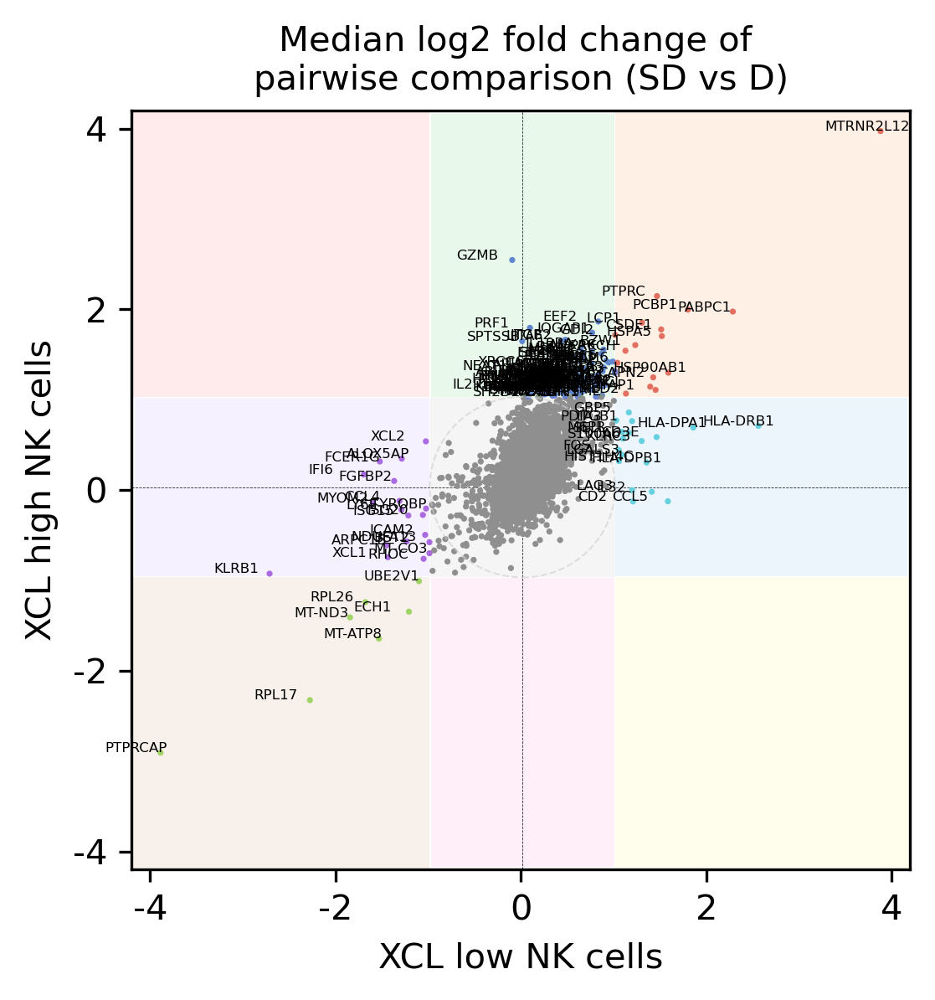

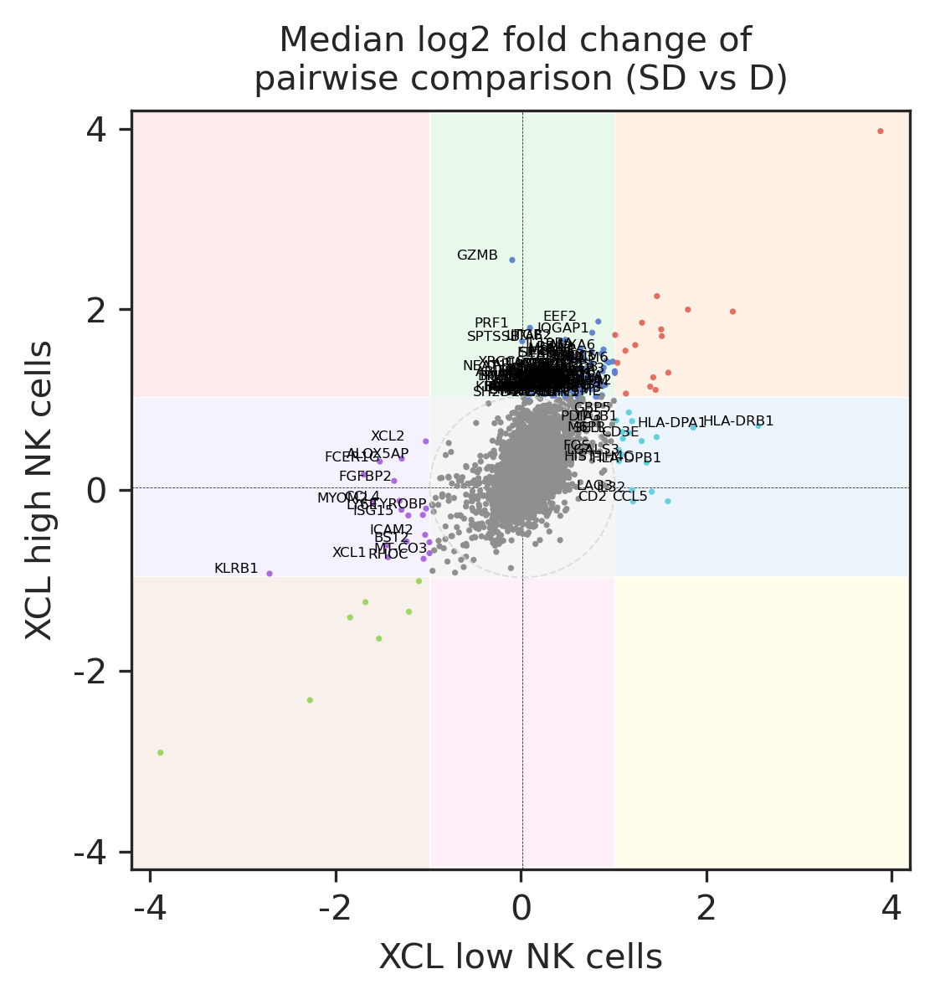

In [8]:
df, r = pairwise_processing(cst_pair.loc['XCL_low NK cells'], cst_pair.loc['XCL_high NK cells'])
mark_list = {}
for m in ['1', '2', '3', '4', '5', '6', '7', '8']:   
    mark_list[m] = df[df['markers'] == m].sort_values('r', ascending=False).index.tolist()

import itertools
marklist = list(itertools.chain.from_iterable(mark_list.values()))

######################## filter to get DEGs
low_df = df[(df['outlier'].isin(['both', 'x_only'])) & 
            (
                ((df['markers'].isin(['5'])) & (df['S_fra'] >= 0.1)) | 
                ((df['markers'].isin(['7'])) & (df['NS_fra'] >= 0.1))
            )
              ]
high_df = df[(df['outlier'].isin(['both', 'y_only'])) & 
             (
                 ((df['markers'].isin(['6'])) & (df['S_fra_a'] >= 0.1)) | 
                 ((df['markers'].isin(['8'])) & (df['NS_fra_a'] >= 0.1))
             )
            ]
low_genes = low_df.index.tolist()
high_genes = high_df.index.tolist()
DEGs = low_genes + high_genes

scatter_pairwise(df, r, marklist, name='low_high_NK_cells.png')
scatter_pairwise(df, r, DEGs, name='DEGs_NK_cells.png')

# DEGs in XCL high or XCL low NK cells

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x630 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Upregulated XCL low NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

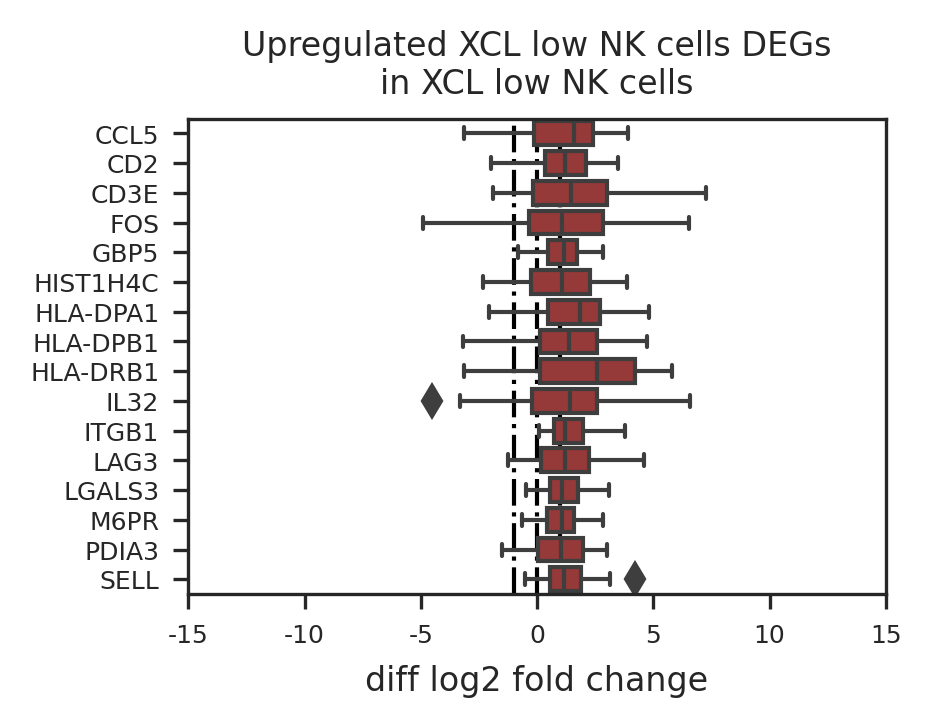

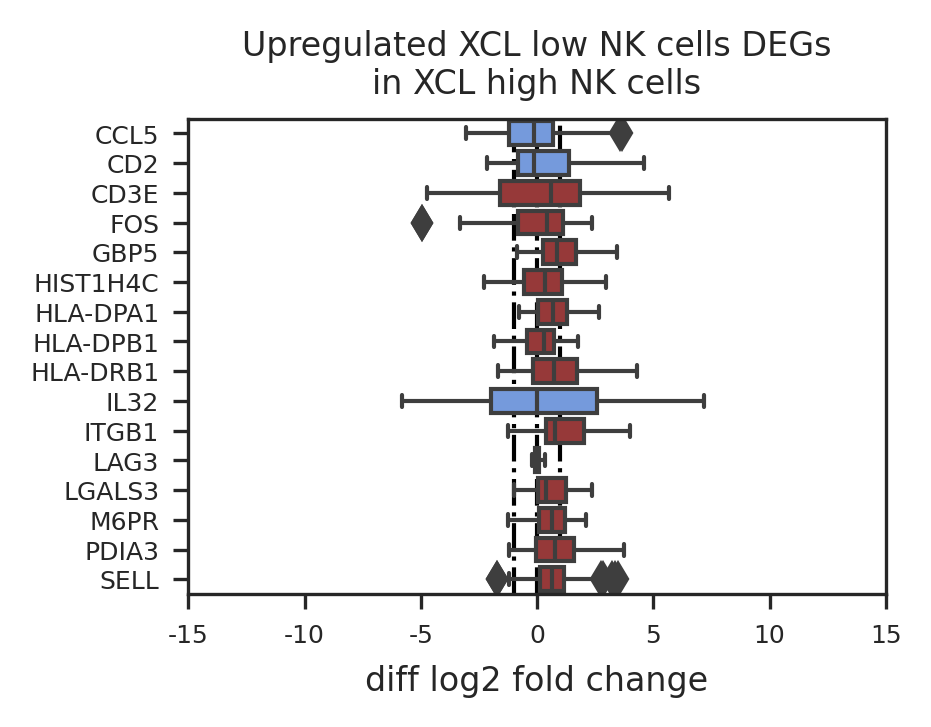

In [9]:
mark_list = []
for m in ['5']:   
    mark_list += df[df['markers'] == m].index.tolist()

mark_list = [g for g in mark_list if g in low_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Upregulated XCL low NK cells DEGs\nin XCL low NK cells', path='up_DEGS_XCL_low_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Upregulated XCL low NK cells DEGs\nin XCL high NK cells', path='up_DEGS_XCL_low_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'mush_up_DEGs_low.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'flow_up_DEGs_low.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Upregulated DEGs in XCL low NK cells', save_fd='heatmap_up_DEGs_low.png')

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x600 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Downregulated XCL low NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

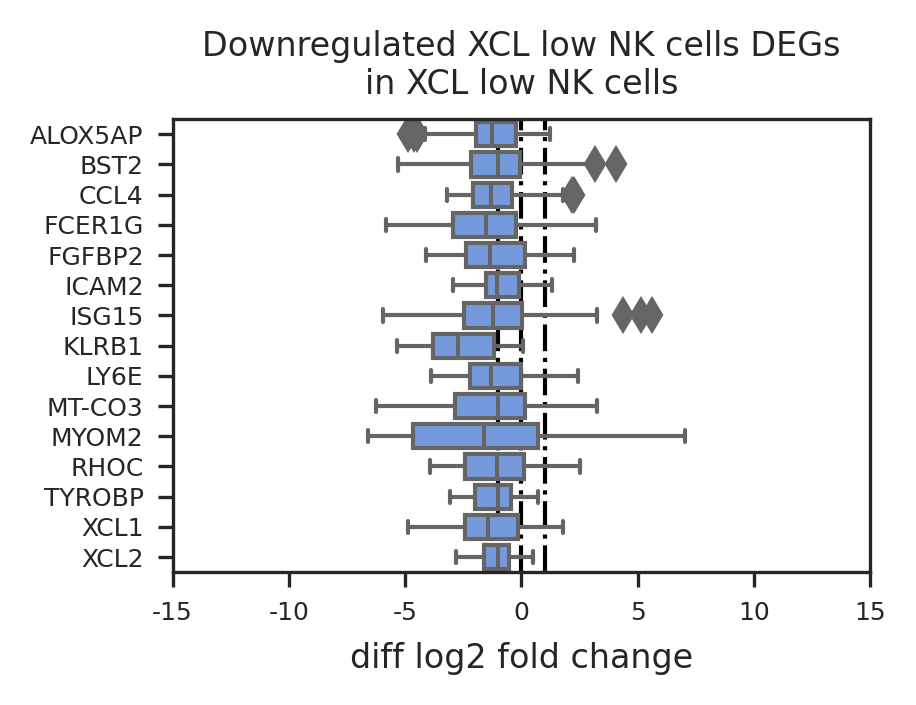

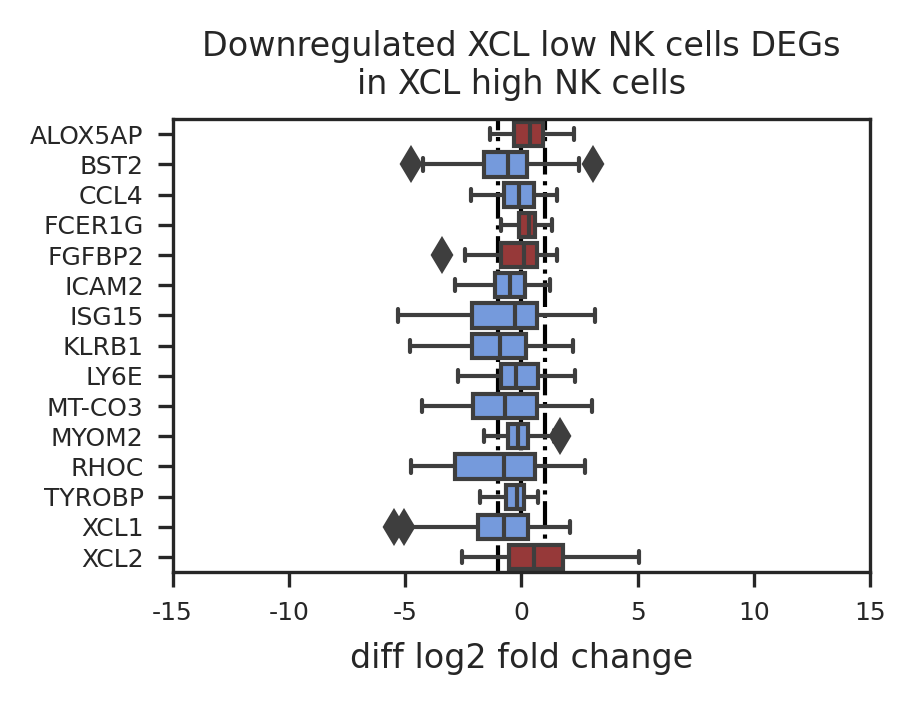

In [10]:
mark_list = []
for m in ['7']:   
    mark_list += df[df['markers'] == m].index.tolist() 
    
mark_list = [g for g in mark_list if g in low_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Downregulated XCL low NK cells DEGs\nin XCL low NK cells', path='down_DEGS_XCL_low_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Downregulated XCL low NK cells DEGs\nin XCL high NK cells', path='down_DEGS_XCL_low_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'mush_down_DEGs_low.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'flow_down_DEGs_low.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Downregulated DEGs\nin XCL low NK cells', save_fd='heatmap_down_DEGs_low.png')

{'figure': <Figure size 1800x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'MHC class II genes'}>}

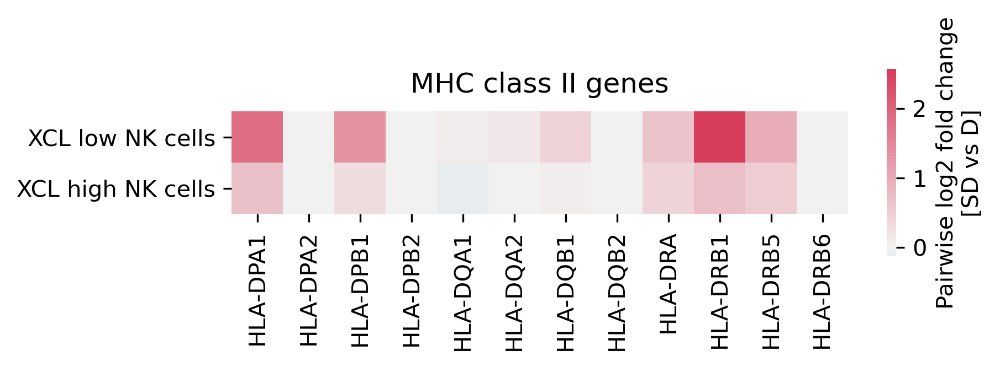

In [155]:
MHC_II = ['HLA-DPA1', 'HLA-DPA2', 'HLA-DPB1', 'HLA-DPB2', 
          'HLA-DQA1', 'HLA-DQA2',  'HLA-DQB1', 'HLA-DQB2', 
          'HLA-DRA','HLA-DRB1', 'HLA-DRB5', 'HLA-DRB6',]
heatmap_cst(MHC_II, ['XCL_low NK cells', 'XCL_high NK cells'], 'MHC class II genes', save_fd=False)

{'figure': <Figure size 1800x1650 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'MHC class II genes'}>}

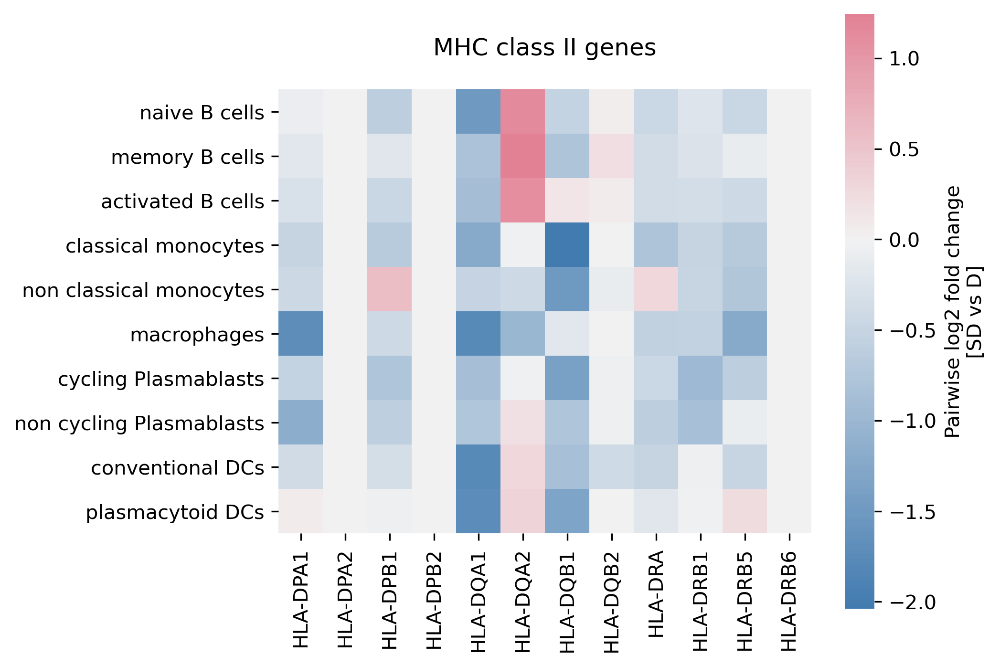

In [154]:
cst_order = ['naive B cells',
             'memory B cells',
             'activated B cells',

              'classical monocytes',
            'non_classical monocytes',
              'macrophages',
              'cycling Plasmablasts',
 'non_cycling Plasmablasts',
 'conventional DCs',
 'plasmacytoid DCs',
 ]

heatmap_cst(MHC_II, cst_order, 'MHC class II genes', vs_type='SD vs D', save_fd=False)

{'figure': <Figure size 1050x1950 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'MHC class II genes'}>}

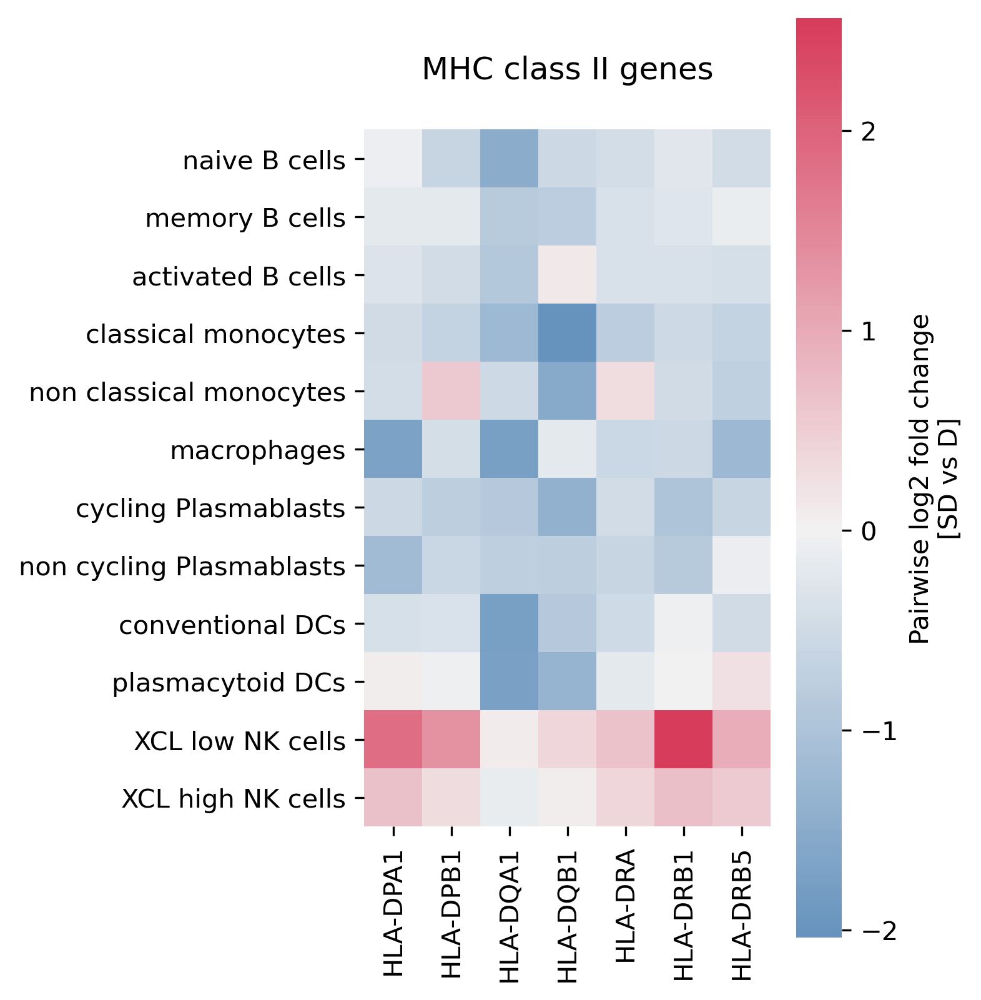

In [46]:
cst_order = ['naive B cells',
             'memory B cells',
             'activated B cells',

             'classical monocytes',
             'non_classical monocytes',
             'macrophages',
             
             'cycling Plasmablasts',
             'non_cycling Plasmablasts',
             
             'conventional DCs',
             'plasmacytoid DCs',
             
             'XCL_low NK cells', 
             'XCL_high NK cells'
             ]

gs = ['HLA-DPA1', 'HLA-DPB1', 
          'HLA-DQA1', 'HLA-DQB1', 
          'HLA-DRA','HLA-DRB1', 'HLA-DRB5', ]
heatmap_cst(gs, cst_order, 'MHC class II genes', vs_type='SD vs D', save_fd=False)

{'figure': <Figure size 600x2400 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'MHC class I genes'}>}

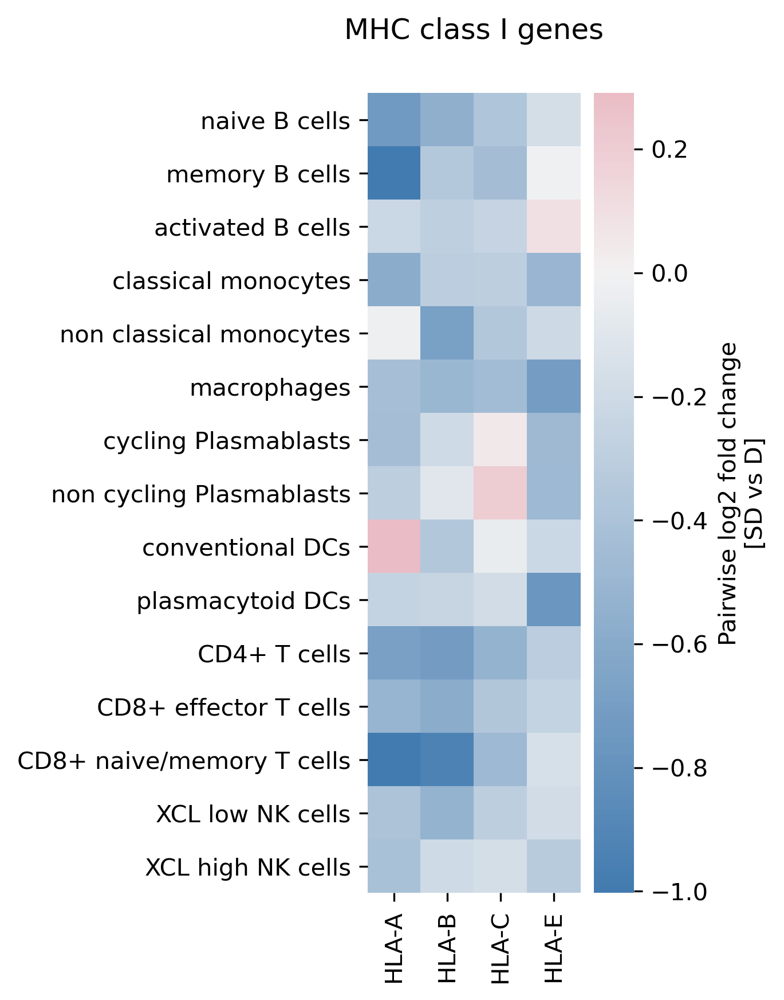

In [179]:
cst_order = ['naive B cells',
             'memory B cells',
             'activated B cells',

              'classical monocytes',
              'non_classical monocytes',
              'macrophages',
             
             'cycling Plasmablasts',
             'non_cycling Plasmablasts',
             'conventional DCs',
             'plasmacytoid DCs',
             
             'CD4+ T cells',
             'CD8+ effector T cells',
             'CD8+ naive/memory T cells',
             
             'XCL_low NK cells',
             'XCL_high NK cells',   
 ]

heatmap_cst(['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E', ], cst_order, 'MHC class I genes', vs_type='SD vs D', save_fd=False)

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x2970 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Upregulated XCL high NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

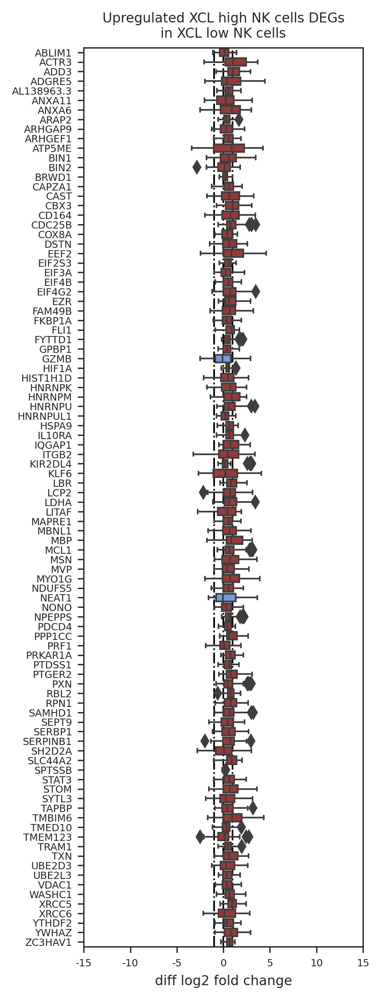

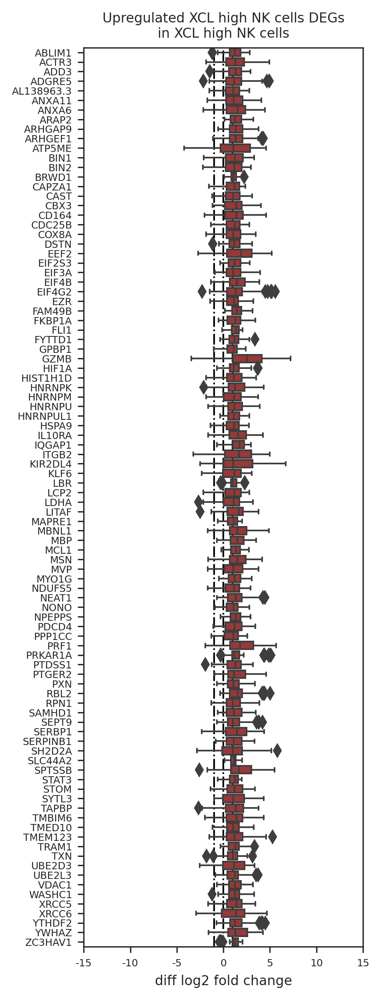

In [11]:
mark_list = []
for m in ['6']:   
    mark_list += df[df['markers'] == m].index.tolist()    
    
mark_list = [g for g in mark_list if g in high_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Upregulated XCL high NK cells DEGs\nin XCL low NK cells', path='up_DEGS_XCL_high_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Upregulated XCL high NK cells DEGs\nin XCL high NK cells', path='up_DEGS_XCL_high_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Upregulated DEGs in XCL high NK cells', save_fd='heatmap_up_DEGs_high.png')

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x660 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Cytokine signaling in immune system\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

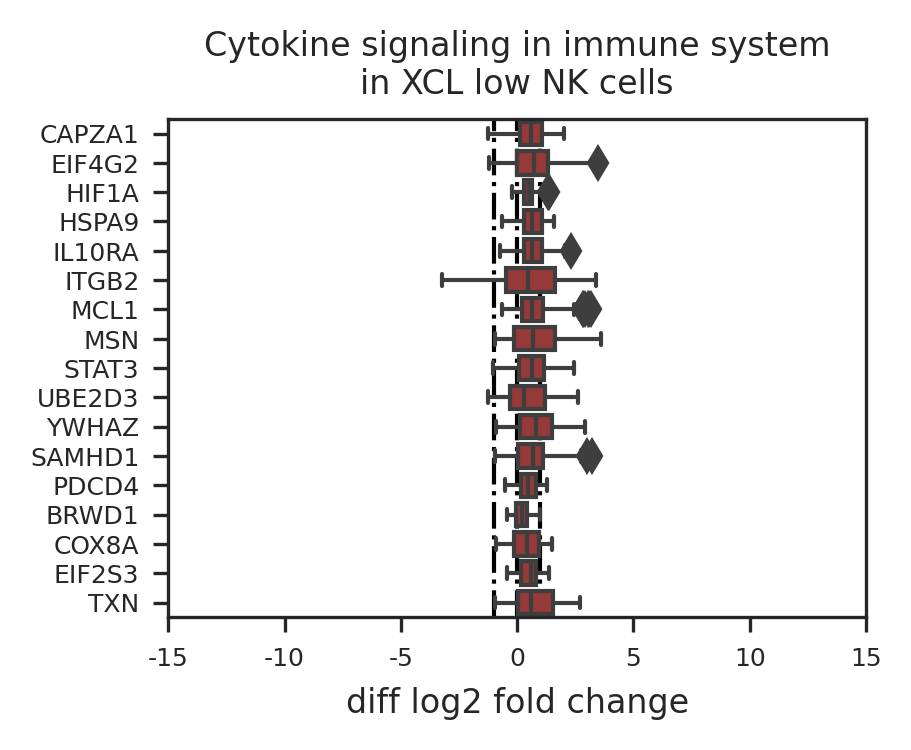

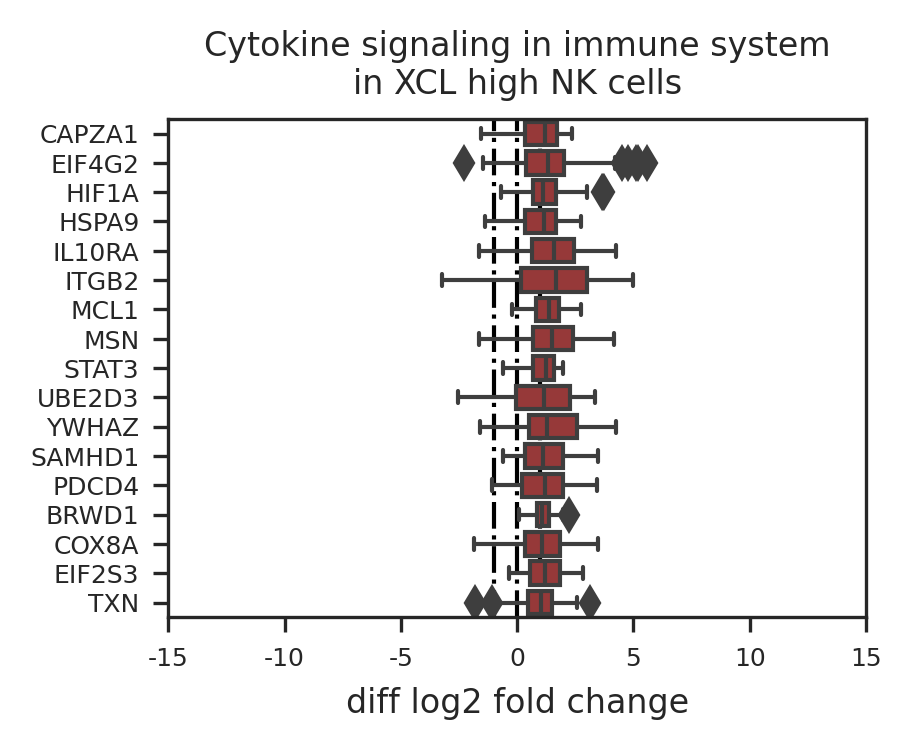

In [12]:
cytokine_sig = ['CAPZA1','EIF4G2','HIF1A','HSPA9','IL10RA','ITGB2','MCL1','MSN','STAT3','UBE2D3','YWHAZ','SAMHD1','PDCD4','BRWD1','COX8A','EIF2S3','H1-3','TXN']
cyto_gs = [g for g in cytokine_sig if g in high_genes]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cyto_gs, 'Cytokine signaling in immune system\nin XCL low NK cells', path='cyto_sig_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cyto_gs, 'Cytokine signaling in immune system\nin XCL high NK cells', path='cyto_sig_high.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(cyto_gs, cst_plots)['figure']
g.savefig(save_figures + 'mush_cyto_sig.png', bbox_inches='tight')

g = com_flowers(cyto_gs, cst_plots)['figure']
g.savefig(save_figures + 'flow_cyto_sig.png', bbox_inches='tight')

heatmap_cst(cyto_gs, 'Cytokine signaling in immune system', save_fd='cyto_sig_pathway.png')

# interacting genes

In [14]:
inter_df = df.loc[[g for g in df.index if g in inter_genes]]

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x510 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Upregulated XCL low NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

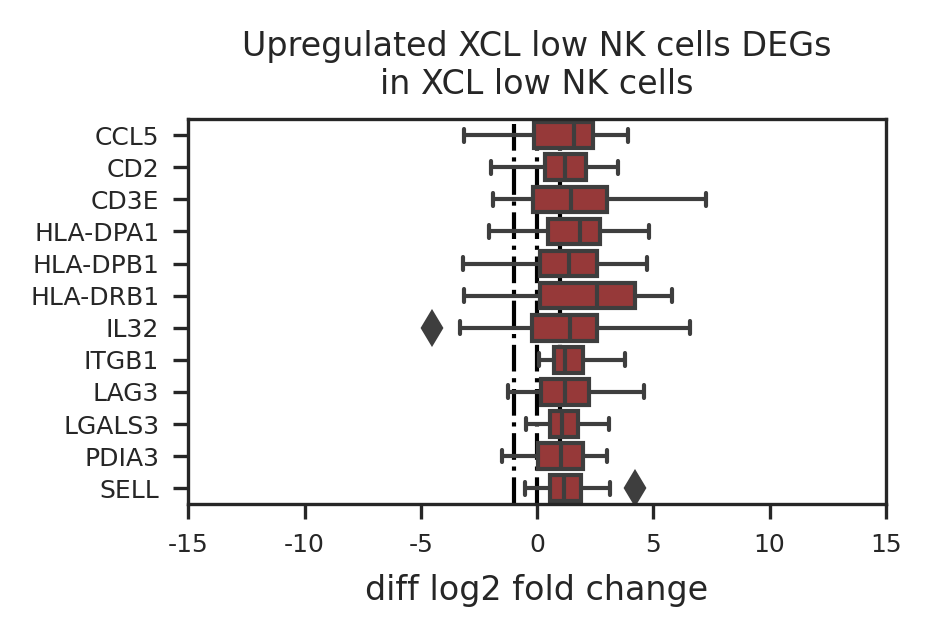

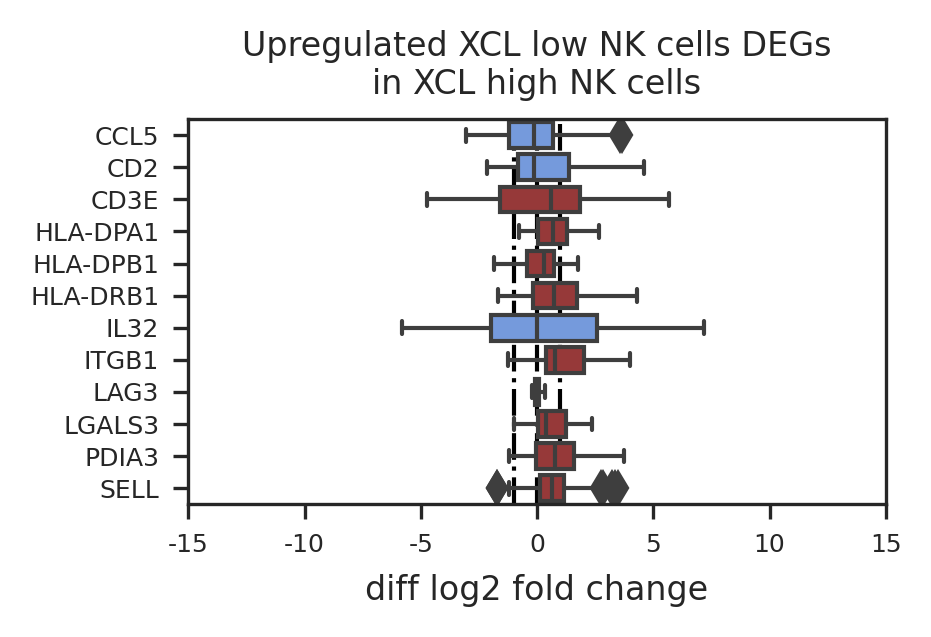

In [15]:
mark_list = []
for m in ['5']:   
    mark_list += inter_df[inter_df['markers'] == m].index.tolist()

mark_list = [g for g in mark_list if g in low_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Upregulated XCL low NK cells DEGs\nin XCL low NK cells', path='interacting_genes/up_DEGS_XCL_low_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Upregulated XCL low NK cells DEGs\nin XCL high NK cells', path='interacting_genes/up_DEGS_XCL_low_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_low.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_low.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Upregulated DEGs in XCL low NK cells', save_fd='interacting_genes/heatmap_up_DEGs_low.png')

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x420 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Downregulated XCL low NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

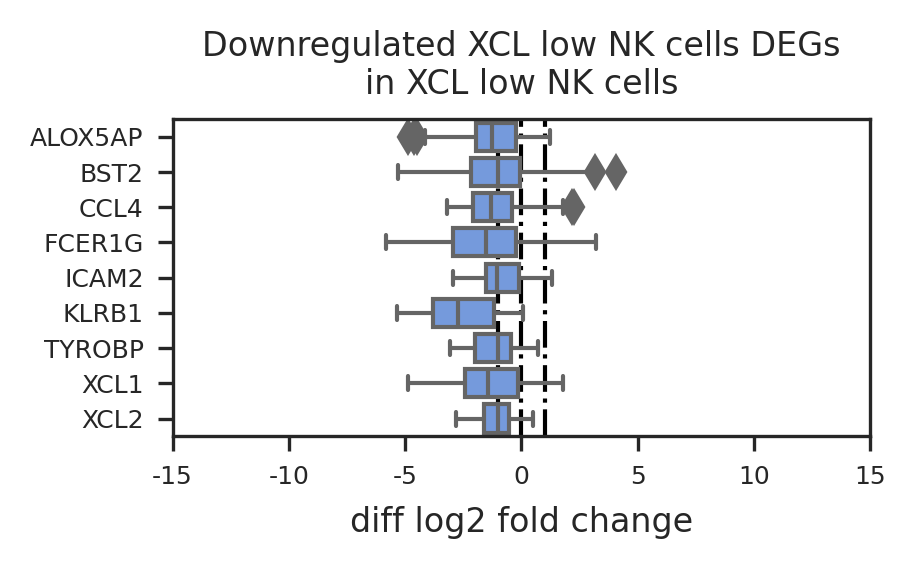

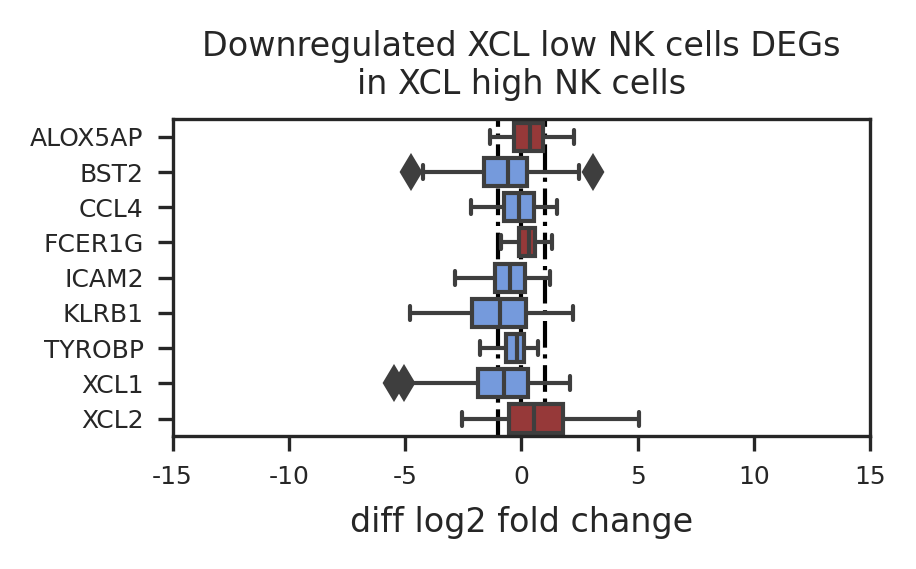

In [16]:
mark_list = []
for m in ['7']:   
    mark_list += inter_df[inter_df['markers'] == m].index.tolist() 
    
mark_list = [g for g in mark_list if g in low_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Downregulated XCL low NK cells DEGs\nin XCL low NK cells', path='interacting_genes/down_DEGS_XCL_low_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Downregulated XCL low NK cells DEGs\nin XCL high NK cells', path='interacting_genes/down_DEGS_XCL_low_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/mush_down_DEGs_low.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/flow_down_DEGs_low.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Downregulated DEGs\nin XCL low NK cells', save_fd='interacting_genes/heatmap_down_DEGs_low.png')

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x330 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Upregulated XCL high NK cells DEGs\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

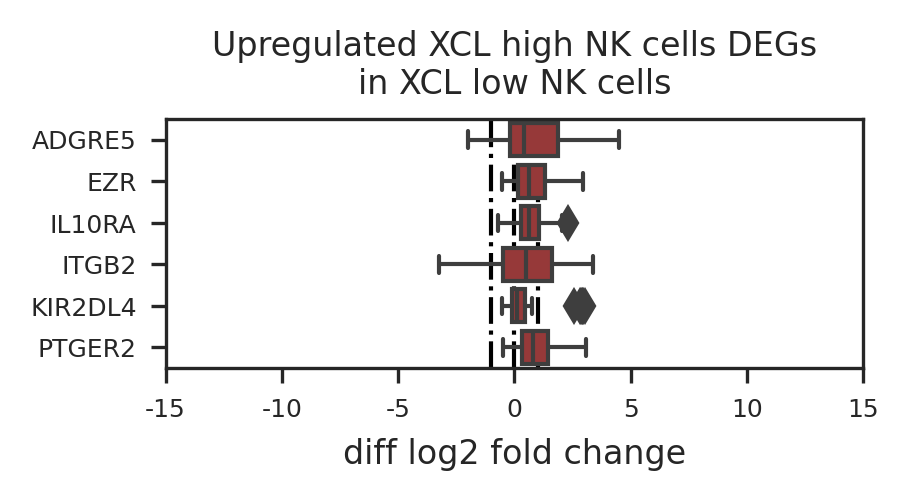

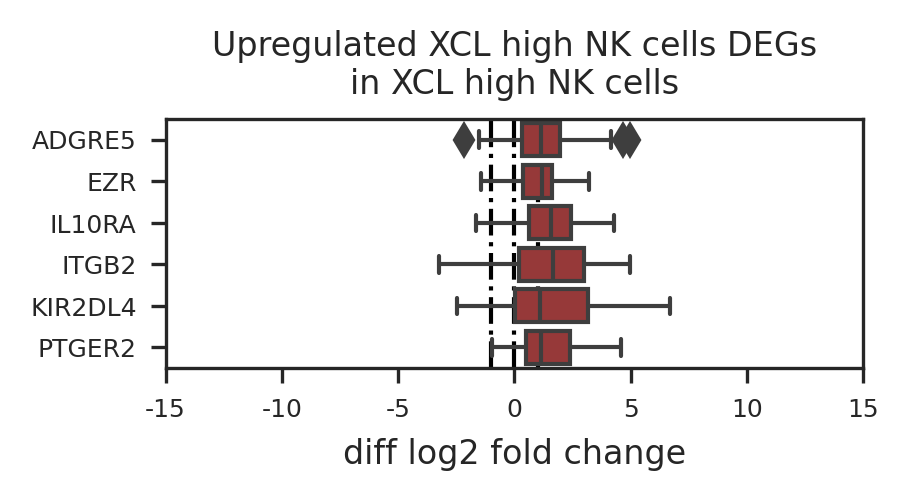

In [17]:
mark_list = []
for m in ['6']:   
    mark_list += inter_df[inter_df['markers'] == m].index.tolist()    
    
mark_list = [g for g in mark_list if g in high_genes]
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 
                 'Upregulated XCL high NK cells DEGs\nin XCL low NK cells', path='interacting_genes/up_DEGS_XCL_high_NK.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 
                 'Upregulated XCL high NK cells DEGs\nin XCL high NK cells', path='interacting_genes/up_DEGS_XCL_high_NK2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Upregulated DEGs in XCL high NK cells', save_fd='interacting_genes/heatmap_up_DEGs_high.png')

In [ ]:
##### fractiong of interacting genes vs DEGS

<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]
<ipython-input-7-202f60e954e4>:248: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  colors = [['Brown', 'CornflowerBlue'][median < 0] for median in medians]


{'figure': <Figure size 900x630 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Interacting genes in\nXCL high NK cells'}, xlabel='diff log2 fold change'>}

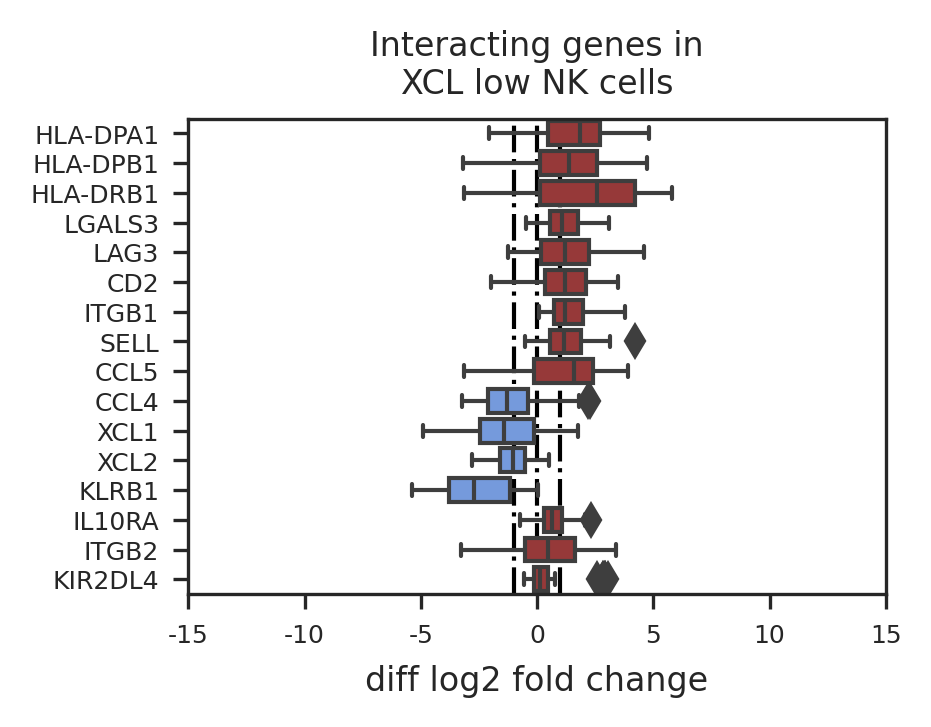

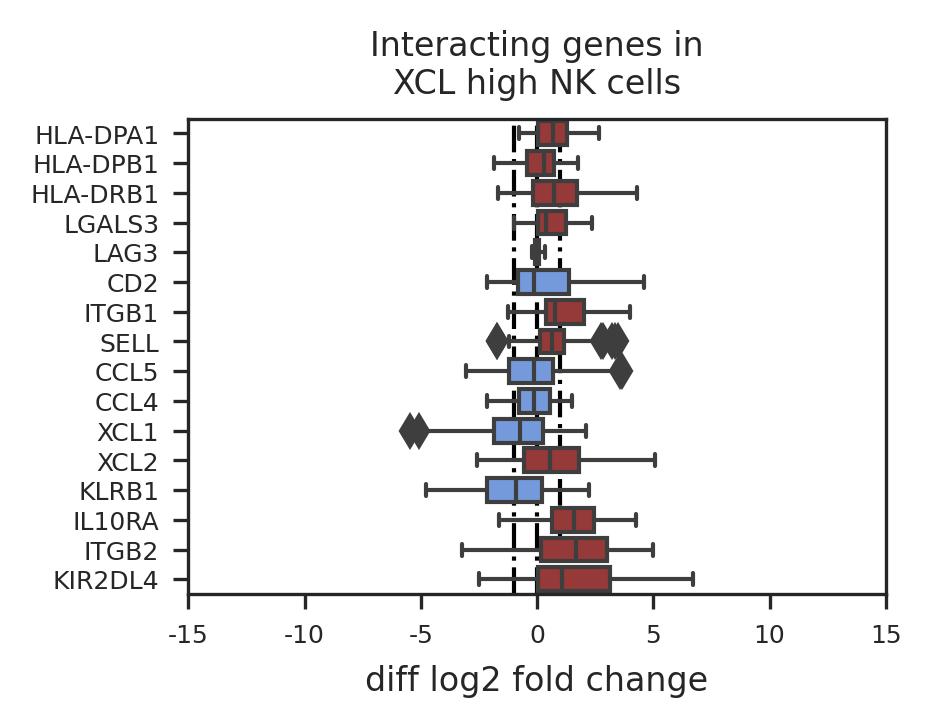

In [18]:
mark_list = [#'ALOX5AP', 'CD3E', 'FCER1G', 
             'HLA-DPA1', 'HLA-DPB1', 'HLA-DRB1', 'LGALS3', 'LAG3',
             'CD2', 'ITGB1', 'SELL', #'ICAM2', 
             'CCL5', 
             'CCL4', 
             'XCL1', 'XCL2', 'KLRB1', 
             'IL10RA', 'ITGB2', 'KIR2DL4'
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], mark_list, 'Interacting genes in\nXCL low NK cells', path='interacting_genes/inter_gs.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], mark_list, 'Interacting genes in\nXCL high NK cells', path='interacting_genes/inter_gs2.png')

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/mush_inter_gs.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'interacting_genes/flow_inter_gs.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Interacting genes', save_fd='interacting_genes/heatmap_inter_gs.png')

# activating and inhibitory receptors in NK cells

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1800x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Activating receptors'}>}

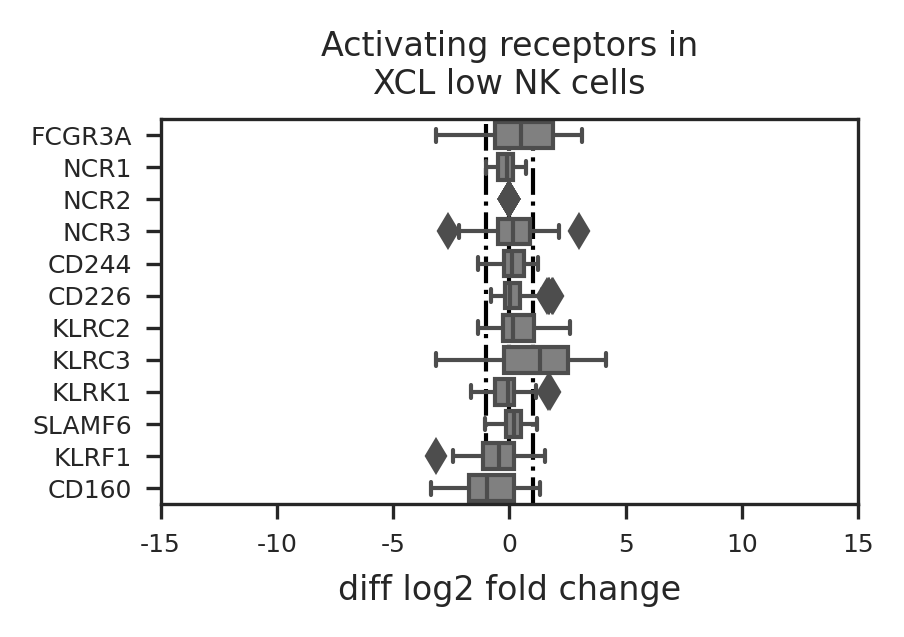

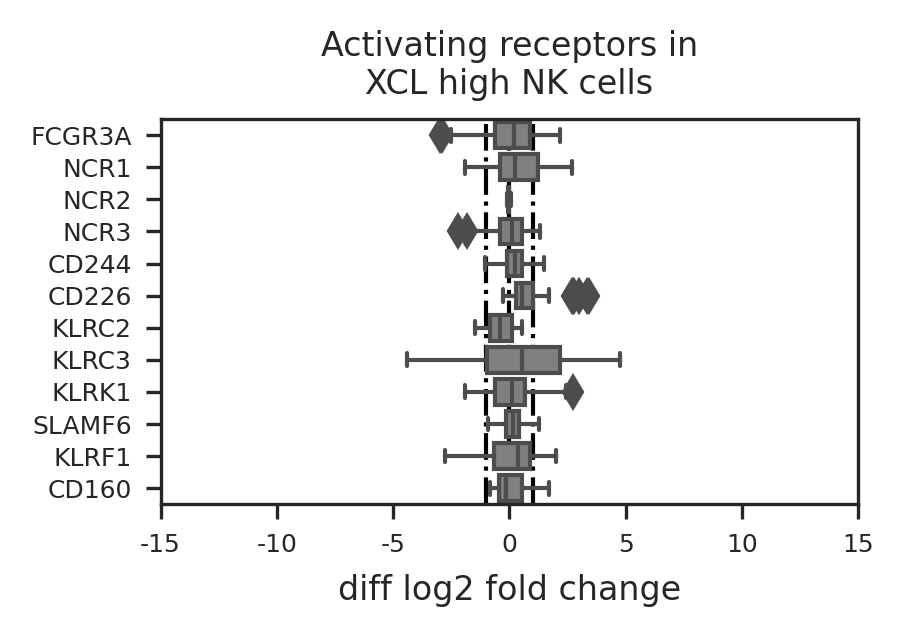

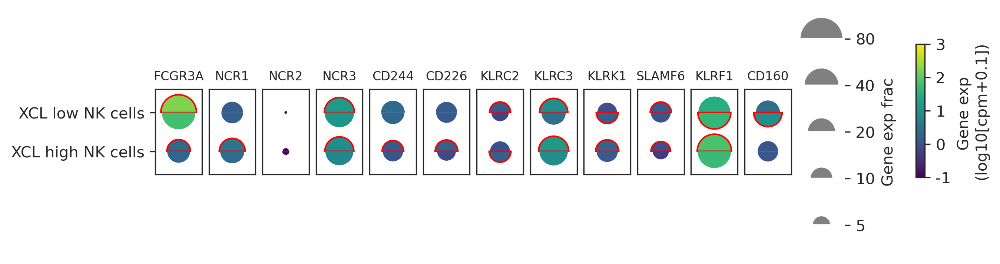

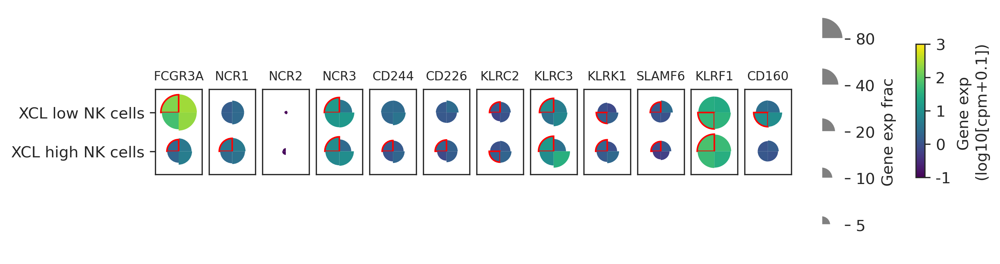

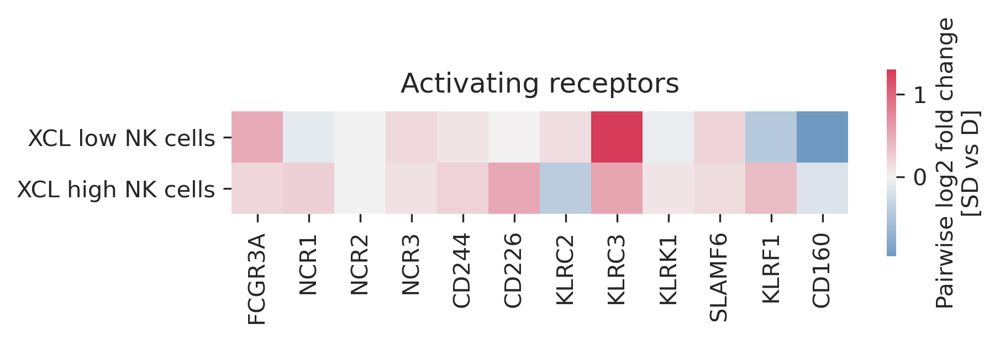

In [140]:
mark_list = [
    'FCGR3A', 'NCR1', 'NCR2', 'NCR3', 'CD244',
    'CD226', 'KLRC2', 'KLRC3', 'KLRK1', 'SLAMF6',
    'KLRF1', 'CD160'  
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 mark_list, 'Activating receptors in\nXCL low NK cells', path='receptors/Act_rcp_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 mark_list, 'Activating receptors in\nXCL high NK cells', path='receptors/Act_rcp_high.png')

cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'receptors/mush_act_rcp_gs.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'receptors/flow_act_rcp_gs.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Activating receptors', 
            save_fd='receptors/heatmap_act_rcp.png')

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 2400x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Inhibitory receptors'}>}

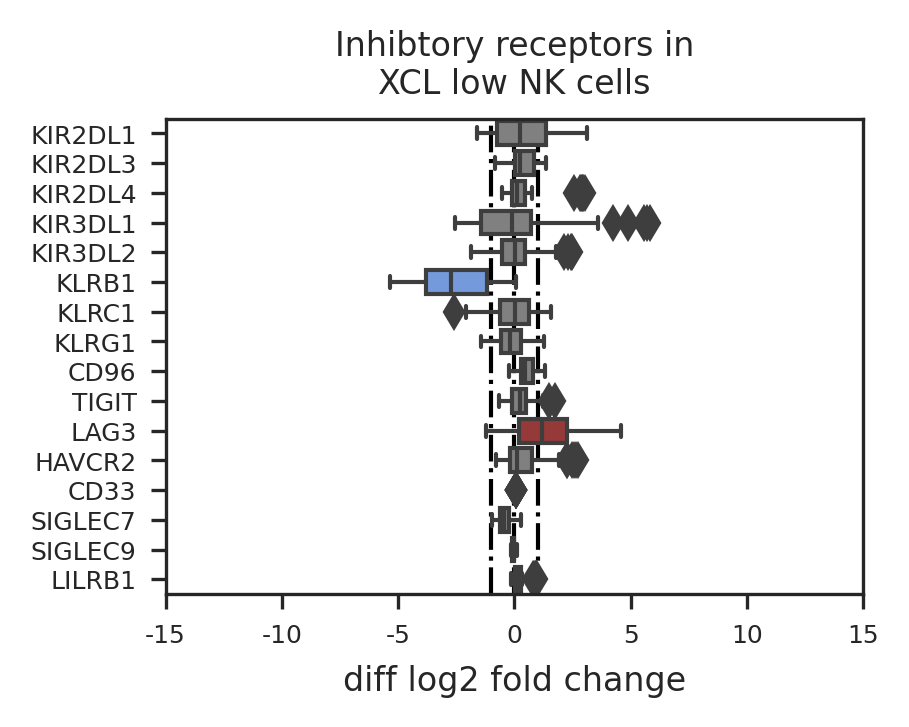

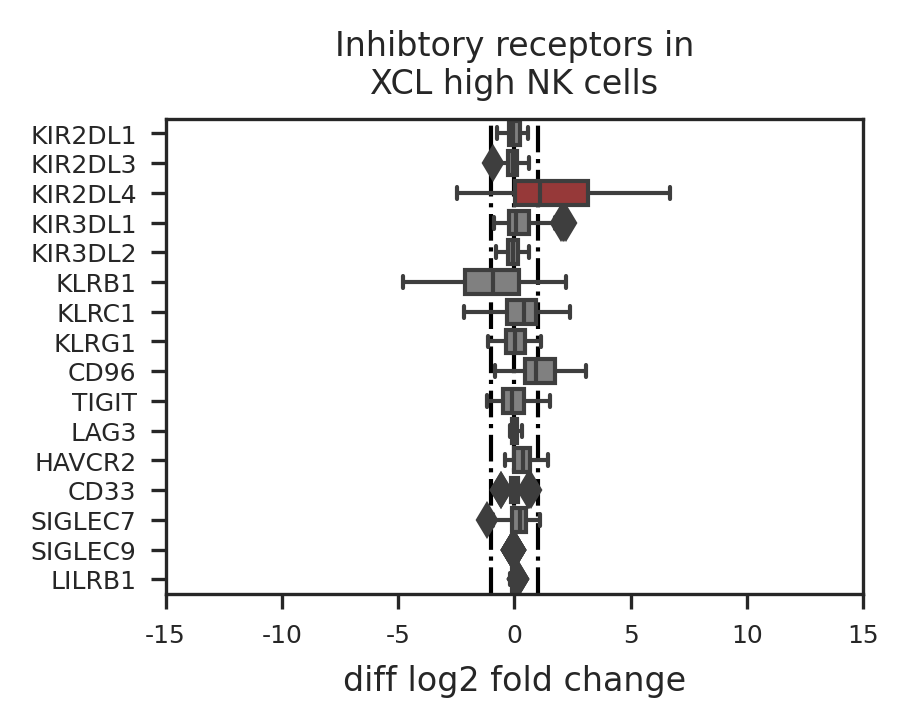

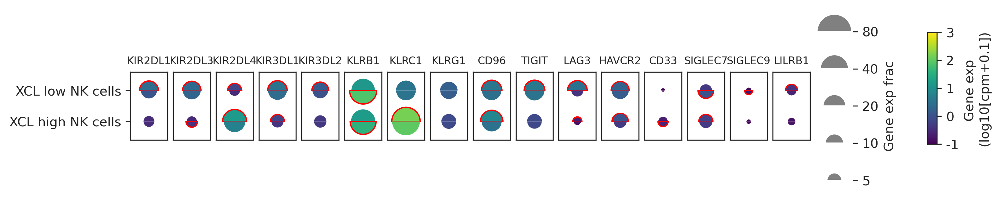

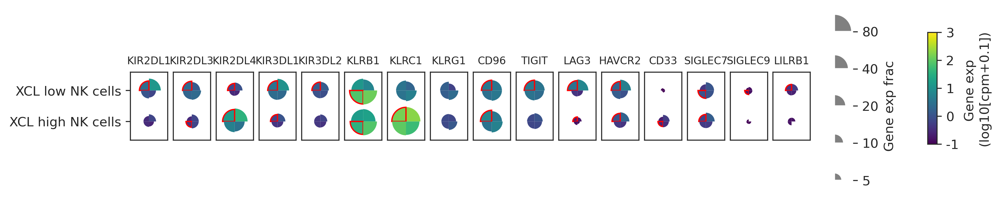

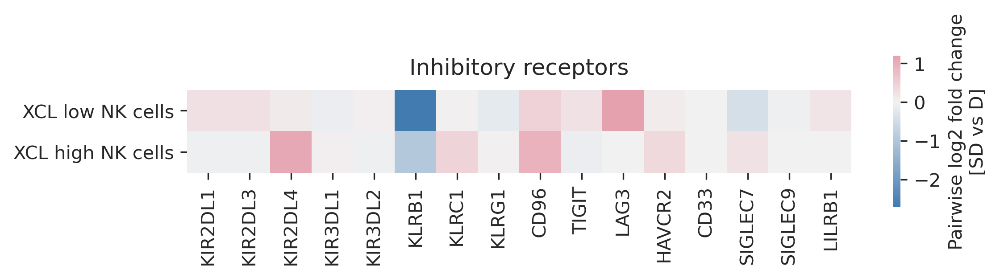

In [142]:
mark_list = [
    'KIR2DL1', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2',
    'KLRB1', 'KLRC1', 'KLRG1', 'CD96', 'TIGIT', 'LAG3', 'HAVCR2', 
    'CD33', 'SIGLEC7', 'SIGLEC9', 'LILRB1'
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 mark_list, 'Inhibtory receptors in\nXCL low NK cells', path='receptors/Int_rcp_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 mark_list, 'Inhibtory receptors in\nXCL high NK cells', path='receptors/Int_rcp_high.png')

cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'receptors/mush_int_rcp_gs.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots)['figure']
g.savefig(save_figures + 'receptors/flow_int_rcp_gs.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Inhibitory receptors', 
            save_fd='receptors/heatmap_int_rcp.png')

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1350x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Killing genes'}>}

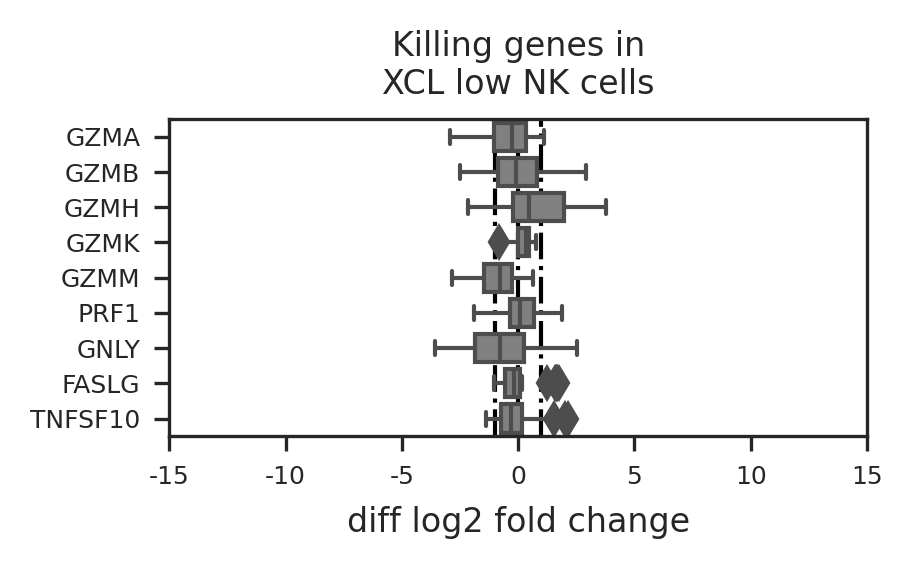

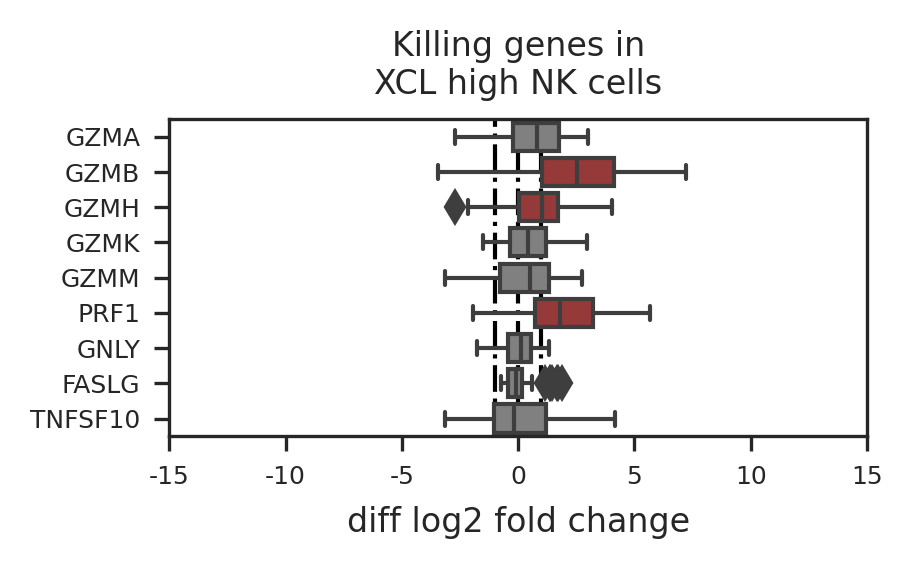

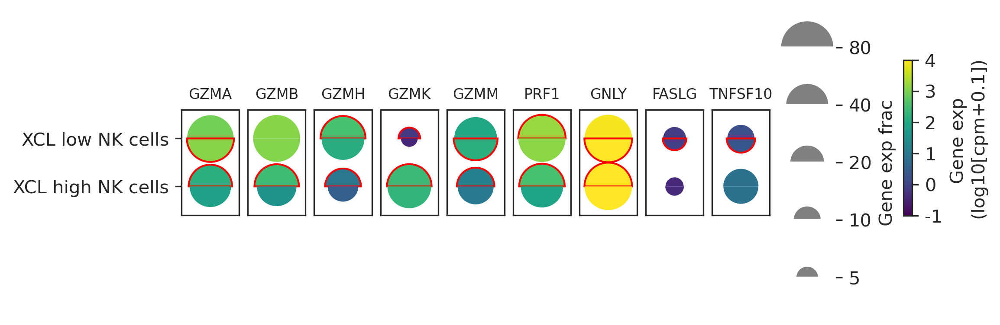

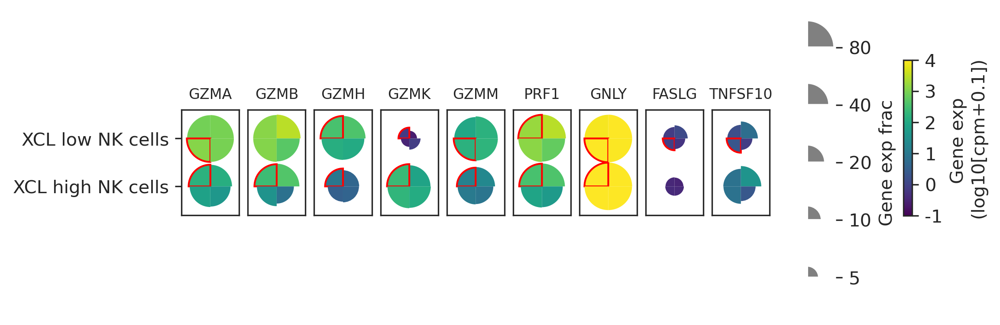

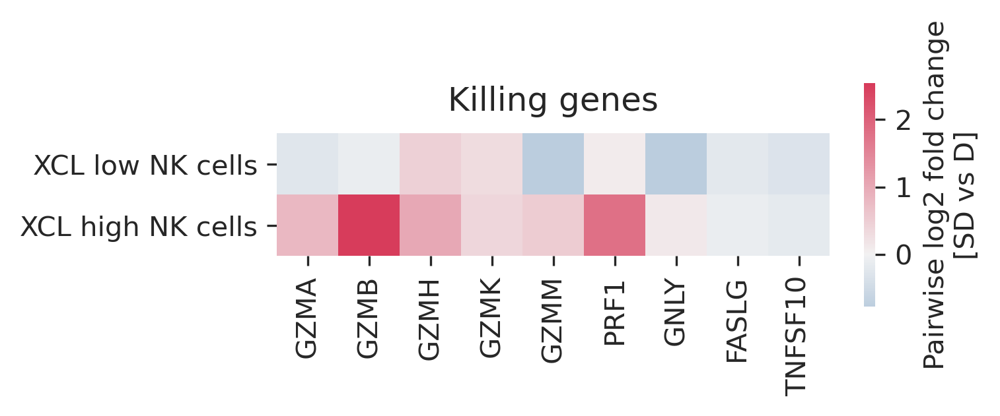

In [151]:
mark_list = [
'GZMA', 'GZMB', 'GZMH', 'GZMK', 'GZMM', 'PRF1', 'GNLY', 'FASLG', 'TNFSF10'
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 mark_list, 'Killing genes in\nXCL low NK cells', path='receptors/kill_gs_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 mark_list, 'Killing genes in\nXCL high NK cells', path='receptors/kill_gs_high.png')

cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/mush_kill_gs.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/flow_kill_gs.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Killing genes', 
            save_fd='receptors/heatmap_kill_gs.png')

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 2850x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Other markers'}>}

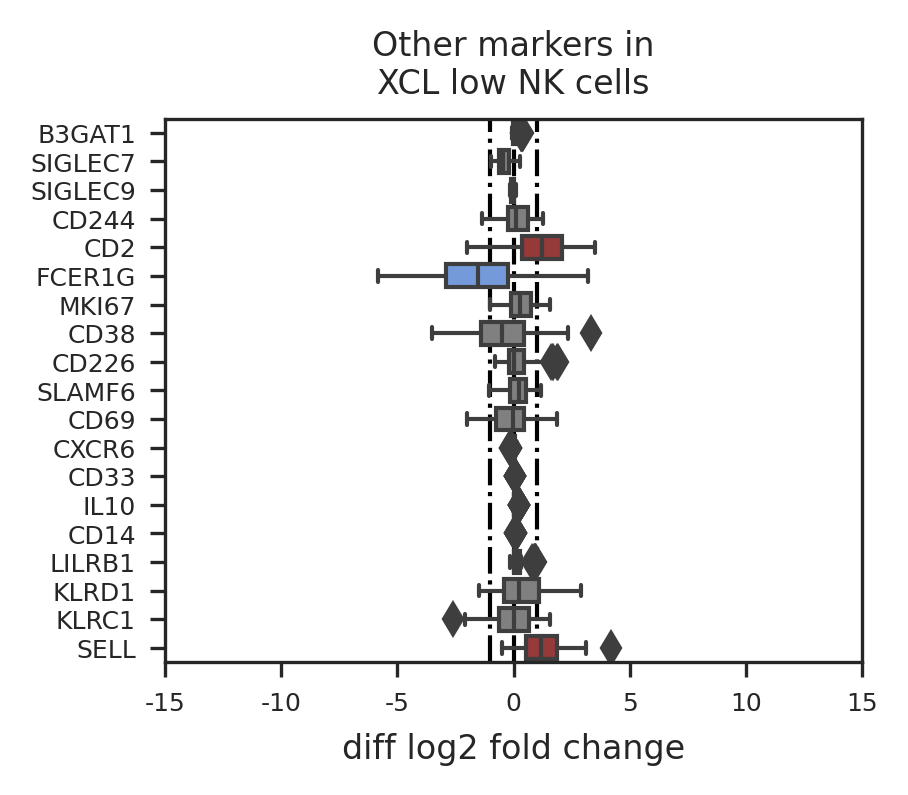

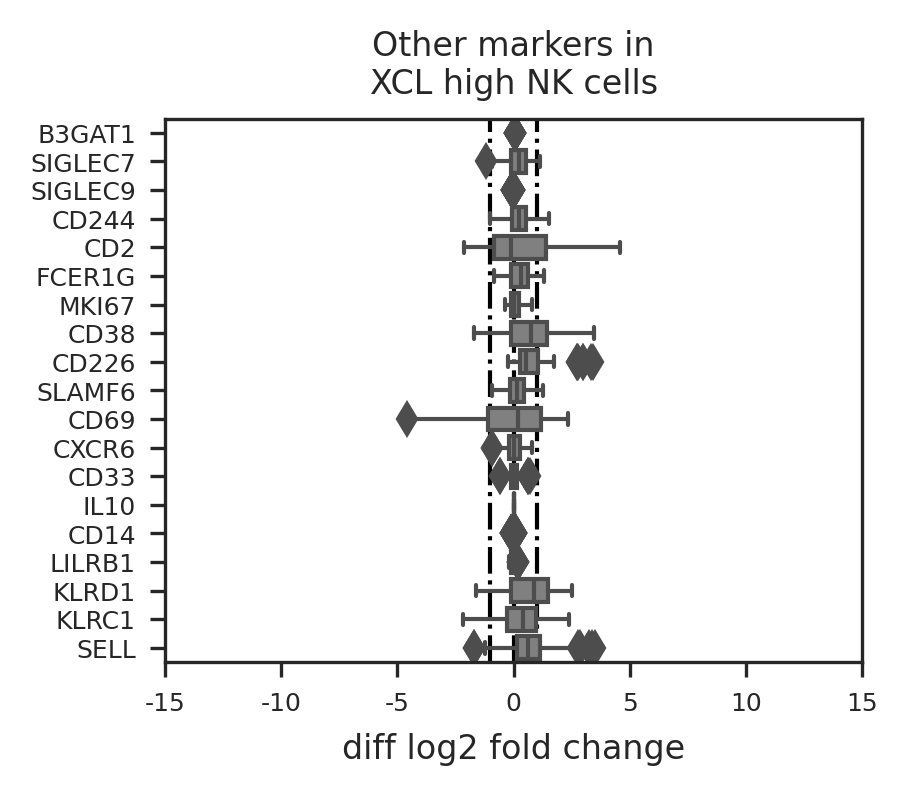

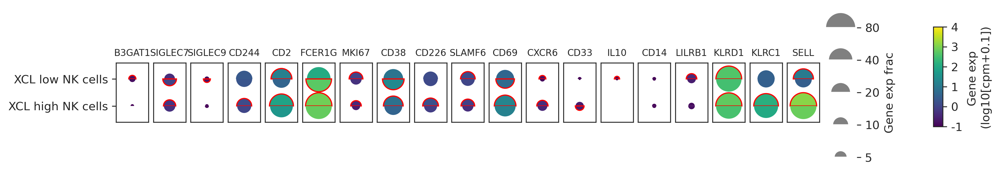

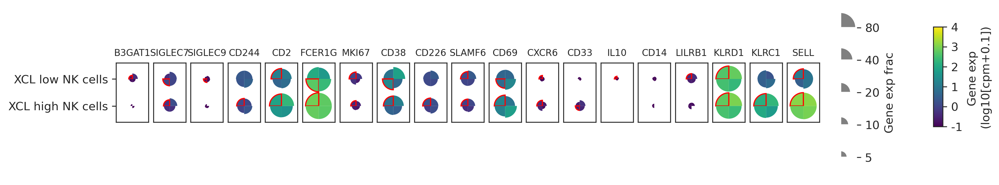

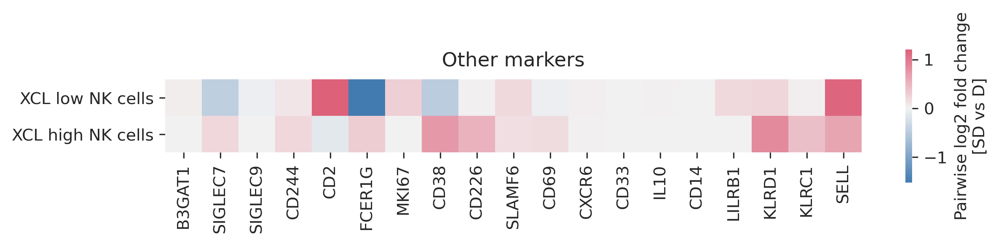

In [158]:
mark_list = [
    'B3GAT1', 'SIGLEC7', 'SIGLEC9', 'CD244', 'CD2', 'FCER1G', 'MKI67',
    'CD38', 'CD226', 'SLAMF6', 'CD69', 'CXCR6', 'CD33',
    'IL10', 'CD14', 'LILRB1', 'KLRD1', 'KLRC1', 'SELL'
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 mark_list, 'Other markers in\nXCL low NK cells', path='receptors/other_markers_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 mark_list, 'Other markers in\nXCL high NK cells', path='receptors/other_markers_high.png')

cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/mush_other_markers.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/flow_other_markers.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Other markers', 
            save_fd='receptors/heatmap_other_markers.png')

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1350x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Cytokines'}>}

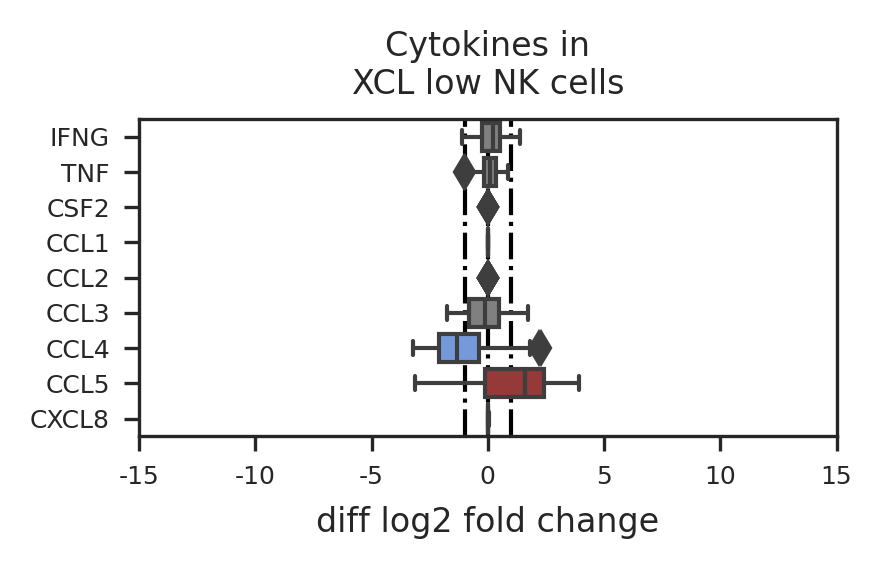

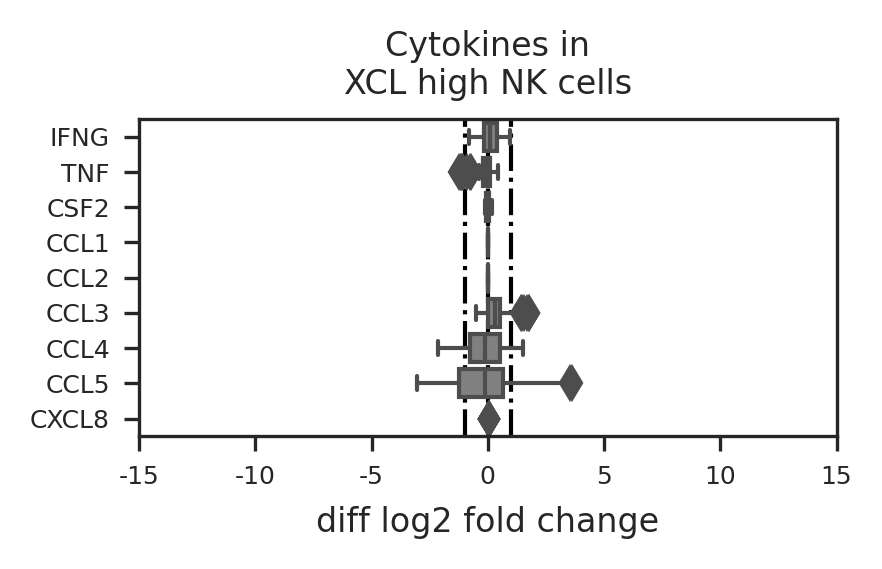

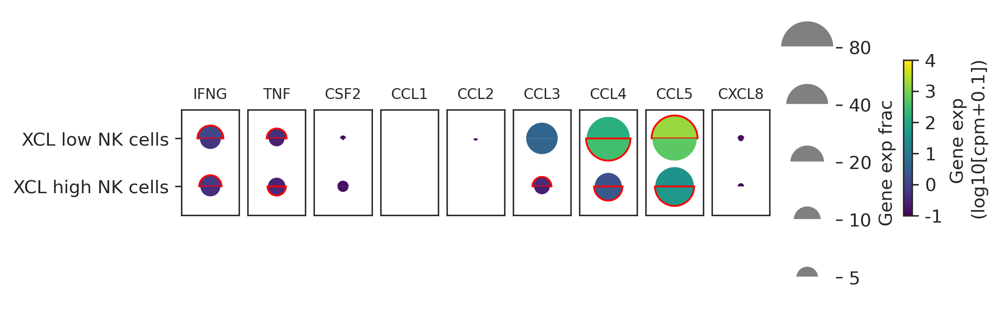

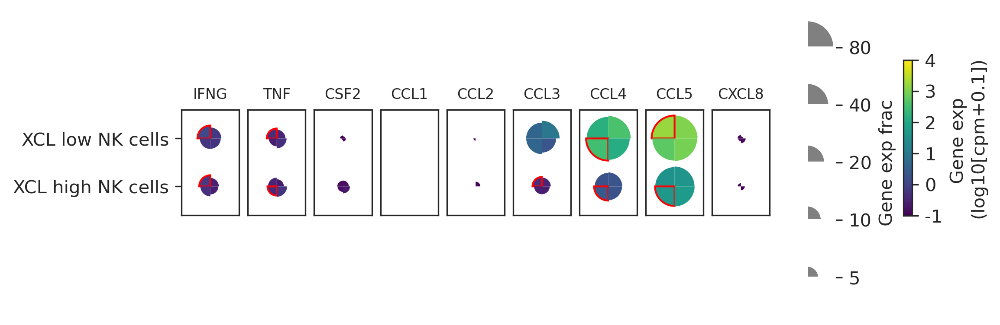

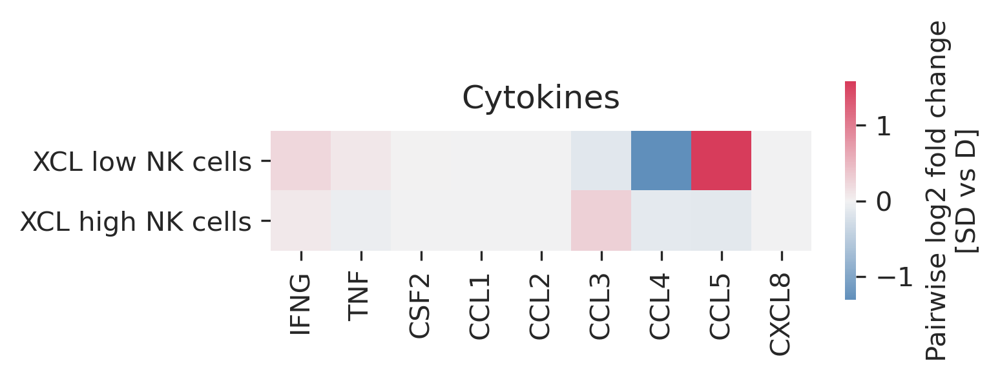

In [159]:
mark_list = [
'IFNG', 'TNF', 'CSF2', 'CCL1', 'CCL2', 'CCL3', 'CCL4', 'CCL5', 'CXCL8'
]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 mark_list, 'Cytokines in\nXCL low NK cells', path='receptors/cytokines_low.png')
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 mark_list, 'Cytokines in\nXCL high NK cells', path='receptors/cytokines_high.png')

cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/mush_cytokines.png', bbox_inches='tight')

g = com_flowers(mark_list, cst_plots, vmax=4)['figure']
g.savefig(save_figures + 'receptors/flow_cytokines.png', bbox_inches='tight')

heatmap_cst(mark_list, ['XCL_low NK cells', 'XCL_high NK cells'], 'Cytokines', 
            save_fd='receptors/heatmap_cytokines.png')

<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 450x2100 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Genes'}>}

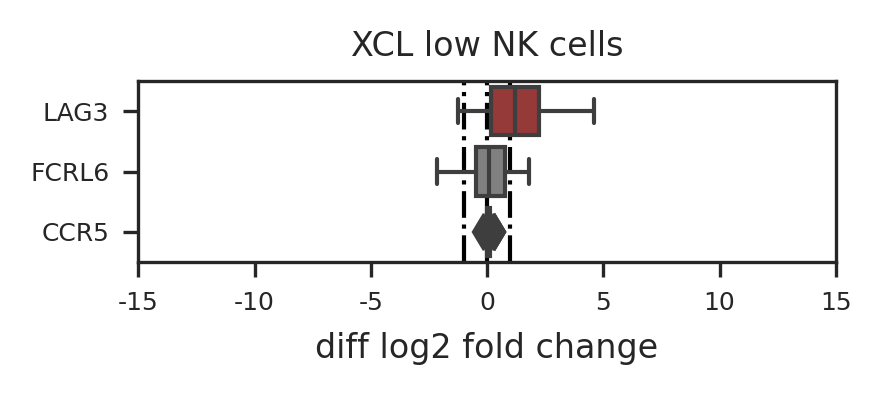

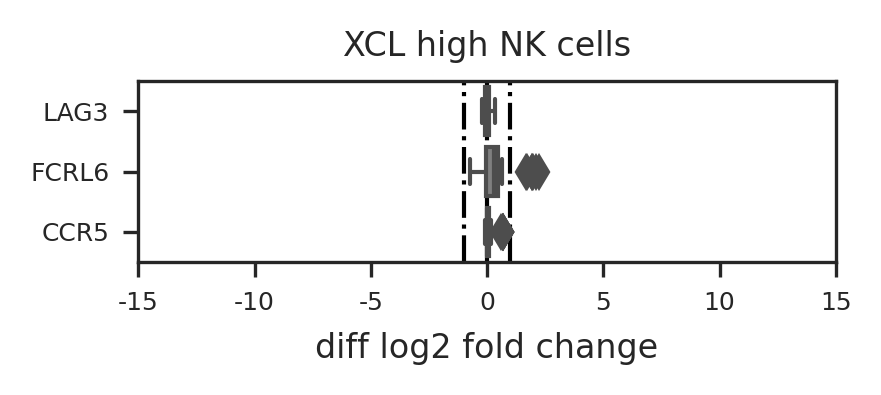

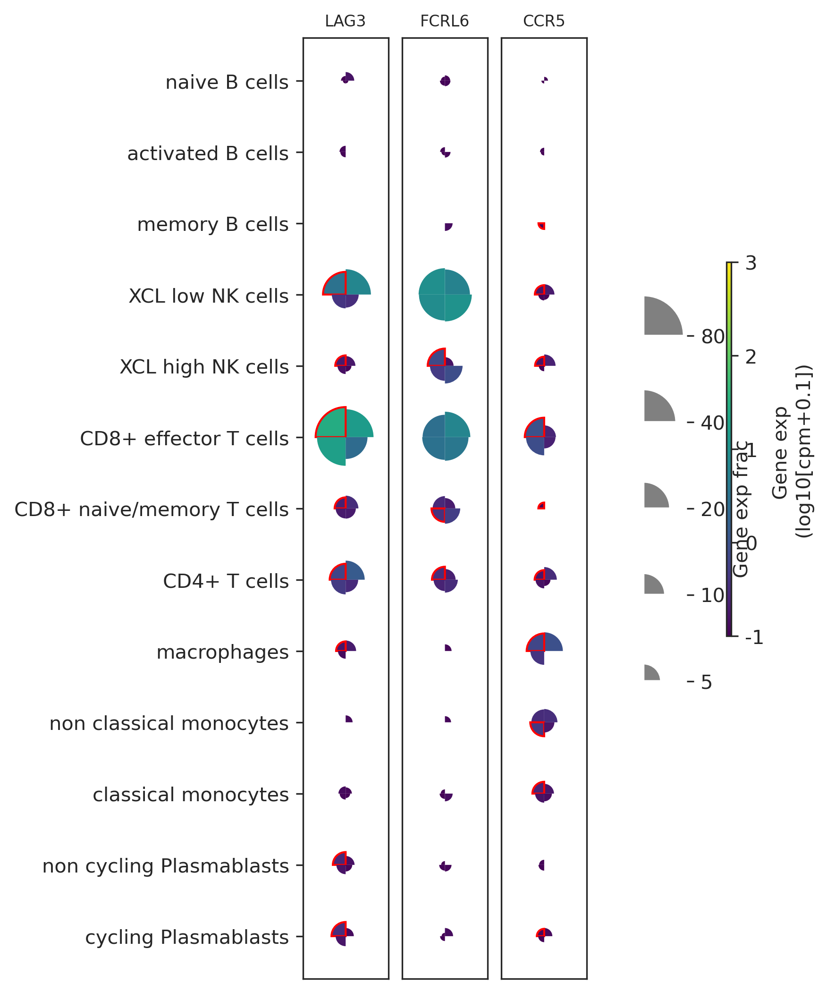

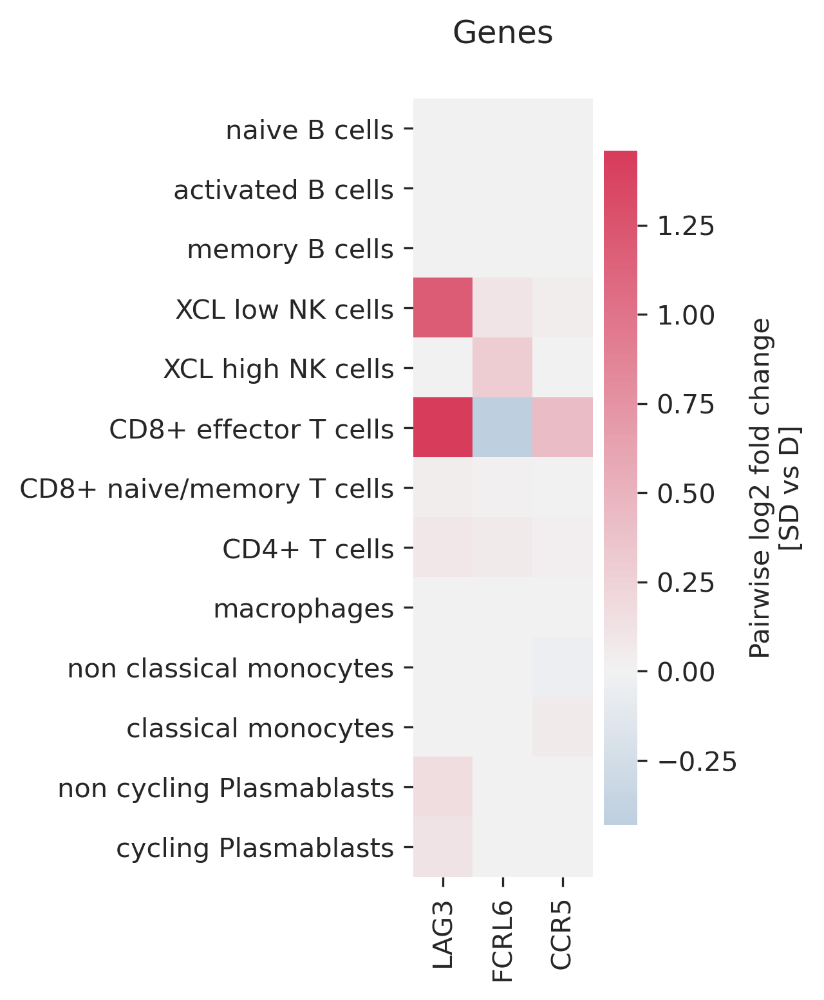

In [160]:
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 ['LAG3', 'FCRL6', 'CCR5'], 'XCL low NK cells', path=False)
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 ['LAG3', 'FCRL6', 'CCR5'], 'XCL high NK cells', path=False)

com_flowers(['LAG3', 'FCRL6', 'CCR5'], csts)['figure']

csts_r = csts.reverse()
heatmap_cst(['LAG3', 'FCRL6', 'CCR5'], csts, 'Genes', 
            save_fd=False)

In [161]:
cst_pair.reset_index().set_index('gene').loc['CCR5']

,cell_subtype,med_pair,fra_pair,neg_fra_pair,S_fra,NS_fra,S_avg,NS_avg,log2_fold_change,statistic,pvalue
gene,,,,,,,,,,,
CCR5,naive B cells,0.000000,0.000000,0.142857,0.000000,0.000208,0.000000,0.001172,-0.001690,0.000208,1.000000
CCR5,XCL_low NK cells,0.047765,0.821429,0.178571,0.011543,0.002495,0.066748,0.015394,0.071180,0.009048,0.921064
CCR5,CD4+ T cells,0.030806,0.625000,0.339286,0.012432,0.008917,0.076319,0.053764,0.030554,0.004493,1.000000
CCR5,XCL_high NK cells,0.000000,0.464286,0.107143,0.010638,0.001848,0.062468,0.010114,0.072901,0.008790,1.000000
CCR5,CD8+ effector T cells,0.418847,0.781250,0.218750,0.132113,0.106366,0.907958,0.736882,0.135530,0.025747,0.596188
CCR5,macrophages,0.000000,0.387755,0.204082,0.093750,0.042424,0.576318,0.303072,0.274641,0.051326,0.975919
CCR5,non_classical monocytes,-0.037656,0.277778,0.500000,0.033333,0.043716,0.206171,0.322719,-0.133072,0.023388,1.000000
CCR5,CD8+ naive/memory T cells,0.000000,0.375000,0.000000,0.002406,0.000000,0.013541,0.000000,0.019404,0.002406,1.000000
CCR5,non_cycling Plasmablasts,-0.000061,0.312500,0.500000,0.001521,0.002253,0.007840,0.011367,-0.005041,0.001002,1.000000


# interactions involving NK DEGs with other cells types

### get interactions

In [91]:
sd_genes = low_genes + high_genes

cts = ['B_cells', 'NK_cells', 'T_cells', 'Monocytes', 'Plasmablasts', 
       'plasmacytoid DCs', 'conventional DCs', 'megakaryocytes']

res = get_inters_fra_pair(sd_genes, cts, med_pair_cut_off=1, fra_pair_cut_off=39/56, fra_exp_cut_off=0.05)
res = res[['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_med_pair', 'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]]
res.to_csv(save_tabels + 'NK_DEGs_inters.tsv', sep='\t', index=False)

In [92]:
sd_genes = low_genes + high_genes

csts = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]

cst_res = get_inters_fra_pair(sd_genes, csts, med_pair_cut_off=1, fra_pair_cut_off=0.7, fra_exp_cut_off=0.05)
cst_res = cst_res[['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_med_pair', 'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]]
cst_res.to_csv(save_tabels + 'NK_DEGs_cst_inters.tsv', sep='\t', index=False)

In [93]:
res = pd.read_csv(save_tabels + 'NK_DEGs_inters.tsv', sep='\t')
cst_res = pd.read_csv(save_tabels + 'NK_DEGs_cst_inters.tsv', sep='\t')

In [94]:
cols = ['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_high_med_pair', 'im_med_pair',
           
        'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]
res = res[cols]
cst_res = cst_res[cols]

In [95]:
low_inters = res[res['inter_type'].isin(['NK_low_up', 'NK_low_down', 'NK_low(up)_mix', 'NK_low(down)_mix'])]
high_inters = res[res['inter_type'].isin(['NK_high_up', 'NK_high_down', 'NK_high(up)_mix', 'NK_high(down)_mix'])]

cst_low_inters = cst_res[cst_res['inter_type'].isin(['NK_low_up', 'NK_low_down', 'NK_low(up)_mix', 'NK_low(down)_mix'])]
cst_high_inters = cst_res[cst_res['inter_type'].isin(['NK_high_up', 'NK_high_down', 'NK_high(up)_mix', 'NK_high(down)_mix'])]

In [96]:
# print(str(len(low_genes)) + ' DEGs in XCL low NK cells')
# print(str(len(high_genes)) + ' DEGs in XCL high NK cells')

print(str(low_inters.shape[0]) + ' inters between XCL low NK cells and immune cell types')
print(str(high_inters.shape[0]) + ' inters between XCL high NK cells and immune cell types')

print(str(cst_low_inters.shape[0]) + ' inters between XCL low NK cells and immune cell subtypes')
print(str(cst_high_inters.shape[0]) + ' inters between XCL high NK cells and immune cell subtypes')

35 inters between XCL low NK cells and immune cell types
7 inters between XCL high NK cells and immune cell types
51 inters between XCL low NK cells and immune cell subtypes
9 inters between XCL high NK cells and immune cell subtypes


### randimization

In [107]:
low_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(low_inters['inter_type'], 
                                               low_inters['NK_gene'], 
                                               low_inters['im_ct'], 
                                               low_inters['im_gene'])
          ]

high_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(high_inters['inter_type'], 
                                               high_inters['NK_gene'], 
                                               high_inters['im_ct'], 
                                               high_inters['im_gene'])
          ]

cst_low_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_low_inters['inter_type'], 
                                               cst_low_inters['NK_gene'], 
                                               cst_low_inters['im_ct'], 
                                               cst_low_inters['im_gene'])
          ]

cst_high_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_high_inters['inter_type'], 
                                               cst_high_inters['NK_gene'], 
                                               cst_high_inters['im_ct'], 
                                               cst_high_inters['im_gene'])
          ]

for its, name, inters in zip([low_its, high_its, cst_low_its, cst_high_its], 
                     ['low', 'high', 'cst_low', 'cst_high'],
                     [low_inters, high_inters, cst_low_inters, cst_high_inters]):
    ran_res = randomization(its, adata_kid)
    ran_res.to_csv(save_tabels + 'randomization_' + name + '_inters.tsv', sep='\t')

    ran_ct_filter = ran_filter(ran_res, its)
    ran_ct_filter.to_csv(save_tabels + 'filtered_randomization_' + name + '_inters.tsv', sep='\t', index=False)
    
    ran_ct_filter.set_index(['ga', 'csta', 'gb', 'cstb'], inplace=True)
    inters.set_index(['NK_gene', 'im_gene', 'im_ct'], inplace=True)
    res_sig = inters.loc[[(ga, gb, ctb) for ga, cta, gb, ctb in ran_ct_filter.index]]
    res_sig = res_sig[~res_sig.duplicated()]
    res_sig.to_csv(save_tabels + 'filtered_sig_' + name + '_inters.tsv', sep='\t')

0


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attrib

0


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


0


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attrib

0


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [108]:
sig_res = {}
for name in ['low', 'high', 'cst_low', 'cst_high']:
    sig_res[name] = pd.read_csv(save_tabels + 'filtered_sig_' + name + '_inters.tsv', sep='\t')
    list_sorted = [['NK_high_up', 'NK_high_down', 'NK_high(up)_mix', 'NK_high(down)_mix'], ['NK_low_up', 'NK_low_down', 'NK_low(up)_mix', 'NK_low(down)_mix']]['low' in name] 
    sig_res[name]['inter_type'] = sig_res[name]['inter_type'].astype('category').cat.set_categories(list_sorted)
    sig_res[name].sort_values(['inter_type', 'NK_gene'], ascending=True, inplace=True)

In [109]:
show_its = {}
for key in sig_res.keys():
    low_its = [{'ga': NK_g, 
            'csta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'cstb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(sig_res[key]['inter_type'], 
                                               sig_res[key]['NK_gene'], 
                                               sig_res[key]['im_ct'], 
                                               sig_res[key]['im_gene'])
          ]

    show_its[key] = genes_transfer(low_its)

### show significant interactions

In [112]:
low_inters = pd.read_csv(save_tabels + 'filtered_sig_' + 'low' + '_inters.tsv', sep='\t')
high_inters = pd.read_csv(save_tabels + 'filtered_sig_' + 'high' + '_inters.tsv', sep='\t')
cst_low_inters = pd.read_csv(save_tabels + 'filtered_sig_' + 'cst_low' + '_inters.tsv', sep='\t')
cst_high_inters = pd.read_csv(save_tabels + 'filtered_sig_' + 'cst_high' + '_inters.tsv', sep='\t')

In [113]:
list_sorted = ['NK_low_up', 'NK_low_down', 'NK_low(up)_mix', 'NK_low(down)_mix']
low_inters['inter_type'] = low_inters['inter_type'].astype('category').cat.set_categories(list_sorted)
low_inters.sort_values(['inter_type', 'NK_gene'], ascending=True)

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
14,CCL5,CCR2,Plasmablasts,NK_low_up,1.585944,-0.123928,1.200132,0.696429,0.861006,0.766447,...,1.253572,0.303571,1.565957,1.957319e-159,0.571429,-0.352734,1.957955e-01,0.171875,1.047787,1.423465e-73
18,CCL5,CXCR3,Plasmablasts,NK_low_up,1.585944,-0.123928,1.105572,0.696429,0.861006,0.766447,...,5.326076,0.303571,1.565957,1.957319e-159,0.571429,-0.352734,1.957955e-01,0.281250,0.670967,5.559940e-30
31,HLA-DPA1,LAG3,NK_cells,NK_low_up,1.859809,0.691999,1.076243,0.892857,0.679317,0.419578,...,0.294634,0.107143,2.612343,1.319439e-219,0.232143,0.831899,3.315563e-03,0.178571,1.430614,1.259294e-86
32,HLA-DPB1,LAG3,NK_cells,NK_low_up,1.355807,0.304889,1.076243,0.767857,0.617647,0.363544,...,0.294634,0.232143,2.475041,4.670255e-210,0.482143,0.366084,3.130837e-01,0.178571,1.430614,1.259294e-86
26,HLA-DRB1,LAG3,NK_cells,NK_low_up,2.562538,0.710563,1.076243,0.767857,0.540797,0.211434,...,0.294634,0.232143,3.329670,0.000000e+00,0.303571,1.136881,2.390566e-05,0.178571,1.430614,1.259294e-86
0,ITGB1,RAC1,Plasmablasts,NK_low_up,1.199121,0.763414,1.024279,1.000000,0.436591,0.260095,...,2.829548,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.296875,1.315615,1.265357e-117
1,ITGB1,RAC1,megakaryocytes,NK_low_up,1.199121,0.763414,2.007521,1.000000,0.436591,0.260095,...,14.877586,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.250000,2.854614,2.962285e-03
2,ITGB1,TLN1,conventional DCs,NK_low_up,1.199121,0.763414,1.575989,1.000000,0.436591,0.260095,...,9.901542,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.222222,1.805271,4.236305e-05
3,ITGB1,THBS1,megakaryocytes,NK_low_up,1.199121,0.763414,2.547584,1.000000,0.436591,0.260095,...,9.038667,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.000000,2.151885,2.191465e-02
4,ITGB1,VCAN,Monocytes,NK_low_up,1.199121,0.763414,3.084326,1.000000,0.436591,0.260095,...,20.344275,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.214286,3.377654,1.741369e-105


In [114]:
list_sorted = ['NK_high_up', 'NK_high_down', 'NK_high(up)_mix', 'NK_high(down)_mix']
high_inters['inter_type'] = high_inters['inter_type'].astype('category').cat.set_categories(list_sorted)
high_inters.sort_values(['inter_type', 'NK_gene'], ascending=True)

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
6,ADGRE5,CD55,conventional DCs,NK_high_up,0.400961,1.157795,1.057574,0.642857,0.385990,0.294351,...,8.044935,0.357143,0.801285,2.337807e-27,0.214286,1.079834,1.936314e-05,0.250000,0.673904,3.392501e-01
4,EZR,RAC1,Plasmablasts,NK_high_up,0.609081,1.170614,1.024279,0.821429,0.272296,0.183303,...,2.829548,0.178571,0.762924,8.007386e-26,0.142857,1.178985,9.568775e-07,0.296875,1.315615,1.265357e-117
5,EZR,RAC1,megakaryocytes,NK_high_up,0.609081,1.170614,2.007521,0.821429,0.272296,0.183303,...,14.877586,0.178571,0.762924,8.007386e-26,0.142857,1.178985,9.568775e-07,0.250000,2.854614,2.962285e-03
0,ITGB2,S100A8,Monocytes,NK_high_up,0.478988,1.663869,2.614053,0.642857,0.839184,0.799569,...,2940.938721,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.125000,3.006245,1.792401e-111
1,ITGB2,S100A8,conventional DCs,NK_high_up,0.478988,1.663869,1.985987,0.642857,0.839184,0.799569,...,7.516013,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.277778,2.136562,2.772933e-03
2,ITGB2,S100A9,Monocytes,NK_high_up,0.478988,1.663869,2.095529,0.642857,0.839184,0.799569,...,684.473755,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.267857,2.774022,3.443780e-95
3,ITGB2,SPON2,NK_cells,NK_high(up)_mix,0.478988,1.663869,-1.365555,0.642857,0.839184,0.799569,...,268.115295,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.803571,-1.657421,7.843318e-110


In [115]:
list_sorted = ['NK_low_up', 'NK_low_down', 'NK_low(up)_mix', 'NK_low(down)_mix']
cst_low_inters['inter_type'] = cst_low_inters['inter_type'].astype('category').cat.set_categories(list_sorted)
cst_low_inters.sort_values(['inter_type', 'NK_gene'], ascending=True)

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
16,CCL5,CCR2,cycling Plasmablasts,NK_low_up,1.585944,-0.123928,1.240434,0.696429,0.861006,0.766447,...,1.836927,0.303571,1.565957,1.957319e-159,0.571429,-0.352734,1.957955e-01,0.071429,1.307519,2.973249e-19
6,CD2,FYN,CD8+ effector T cells,NK_low_up,1.209448,-0.125429,1.347017,0.821429,0.425364,0.249093,...,10.959249,0.178571,1.619369,1.536917e-100,0.517857,0.903880,2.234058e-03,0.265625,0.313959,1.165318e-02
4,CD3E,FYN,CD8+ effector T cells,NK_low_up,1.464006,0.586699,1.347017,0.696429,0.602625,0.253857,...,10.959249,0.303571,3.663883,0.000000e+00,0.392857,1.176701,5.109675e-05,0.265625,0.313959,1.165318e-02
39,HLA-DPA1,LAG3,XCL_low NK cells,NK_low_up,1.859809,0.691999,1.200509,0.892857,0.679317,0.419578,...,0.311872,0.107143,2.612343,1.319439e-219,0.232143,0.831899,3.315563e-03,0.196429,1.634887,1.863960e-102
40,HLA-DPA1,LAG3,CD8+ effector T cells,NK_low_up,1.859809,0.691999,1.458214,0.892857,0.679317,0.419578,...,17.636307,0.107143,2.612343,1.319439e-219,0.232143,0.831899,3.315563e-03,0.281250,0.682620,9.828043e-06
41,HLA-DPB1,LAG3,XCL_low NK cells,NK_low_up,1.355807,0.304889,1.200509,0.767857,0.617647,0.363544,...,0.311872,0.232143,2.475041,4.670255e-210,0.482143,0.366084,3.130837e-01,0.196429,1.634887,1.863960e-102
42,HLA-DPB1,LAG3,CD8+ effector T cells,NK_low_up,1.355807,0.304889,1.458214,0.767857,0.617647,0.363544,...,17.636307,0.232143,2.475041,4.670255e-210,0.482143,0.366084,3.130837e-01,0.281250,0.682620,9.828043e-06
32,HLA-DRB1,LAG3,XCL_low NK cells,NK_low_up,2.562538,0.710563,1.200509,0.767857,0.540797,0.211434,...,0.311872,0.232143,3.329670,0.000000e+00,0.303571,1.136881,2.390566e-05,0.196429,1.634887,1.863960e-102
33,HLA-DRB1,LAG3,CD8+ effector T cells,NK_low_up,2.562538,0.710563,1.458214,0.767857,0.540797,0.211434,...,17.636307,0.232143,3.329670,0.000000e+00,0.303571,1.136881,2.390566e-05,0.281250,0.682620,9.828043e-06
0,ITGB1,FYN,CD8+ effector T cells,NK_low_up,1.199121,0.763414,1.347017,1.000000,0.436591,0.260095,...,10.959249,0.000000,1.645901,8.509408e-101,0.160714,1.075335,2.354492e-05,0.265625,0.313959,1.165318e-02


In [116]:
list_sorted = ['NK_high_up', 'NK_high_down', 'NK_high(up)_mix', 'NK_high(down)_mix']
cst_high_inters['inter_type'] = cst_high_inters['inter_type'].astype('category').cat.set_categories(list_sorted)
cst_high_inters.sort_values(['inter_type', 'NK_gene'], ascending=True)

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
0,ITGB2,FYN,CD8+ effector T cells,NK_high_up,0.478988,1.663869,1.347017,0.642857,0.839184,0.799569,...,10.959249,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.265625,0.313959,1.165318e-02
1,ITGB2,S100A8,macrophages,NK_high_up,0.478988,1.663869,6.535582,0.642857,0.839184,0.799569,...,57.315849,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.020408,5.602067,4.780197e-22
2,ITGB2,S100A8,classical monocytes,NK_high_up,0.478988,1.663869,1.351899,0.642857,0.839184,0.799569,...,15615.589844,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.142857,1.075522,8.160444e-60
3,ITGB2,S100A9,macrophages,NK_high_up,0.478988,1.663869,4.483443,0.642857,0.839184,0.799569,...,43.116615,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.081633,4.145314,5.608572e-19
4,ITGB2,S100A9,classical monocytes,NK_high_up,0.478988,1.663869,1.154402,0.642857,0.839184,0.799569,...,2877.347412,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.285714,1.137091,2.333933e-66
5,IL10RA,PTPN6,cycling Plasmablasts,NK_high(up)_mix,0.647035,1.568896,-1.239661,0.857143,0.258381,0.159823,...,8.978827,0.142857,0.854815,1.384552e-31,0.125000,1.671345,7.232666e-12,0.785714,-1.340173,5.619101e-21
7,ITGB2,FCER2,naive B cells,NK_high(up)_mix,0.478988,1.663869,-1.092027,0.642857,0.839184,0.799569,...,16.611191,0.357143,0.516979,7.477294e-29,0.232143,1.600079,7.223086e-11,0.767857,-0.636030,1.069327e-09
6,KIR2DL4,HLA-A,memory B cells,NK_high(up)_mix,0.108000,1.086464,-1.002861,0.642857,0.072423,0.028925,...,1053.323486,0.357143,0.406749,1.718545e-06,0.250000,1.332506,4.555413e-06,0.732143,-0.415830,3.228526e-03


### mushroom plots and flower plots

In [102]:
def genes_transfer(genes):    
    new_genes = []
    for i, gene in enumerate(genes):
        new_genes.append({})
        for g, cst in zip([gene['ga'], gene['gb']], [gene['csta'], gene['cstb']]):
            if isinstance(cst, list):
                new_genes[i][g].append(cst)
            else:
                new_genes[i][g] = [cst]
                
#     inters = []
#     f_genes = []
#     for inter in new_genes:
#         it = list(inter.keys())
#         if it not in inters:
#             inters.append(it)
#             f_genes.append(inter)
#         else:
#             for j, itj in enumerate(inters):
#                 if it == itj:
#                     if inter[it[0]][0] not in f_genes[j][it[0]]:
#                         f_genes[j][it[0]].append(inter[it[0]][0])
#                     if inter[it[1]][0] not in f_genes[j][it[1]]:
#                         f_genes[j][it[1]].append(inter[it[1]][0])            
    return new_genes

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

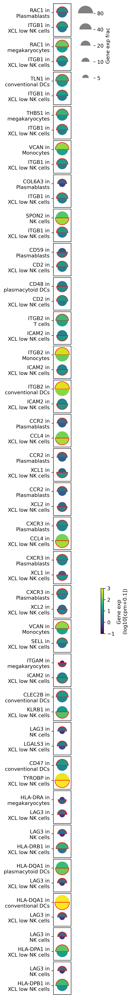

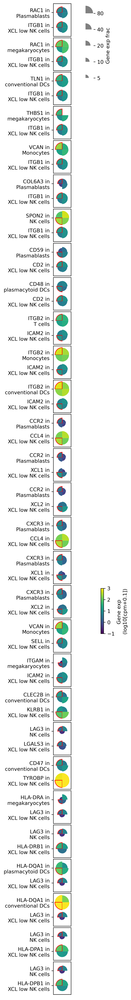

In [64]:
low_its = [{'ga': NK_g, 
            'csta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'cstb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(low_inters['inter_type'], 
                                               low_inters['NK_gene'], 
                                               low_inters['im_ct'], 
                                               low_inters['im_gene'])
          ]

l_its = genes_transfer(low_its)

s_mushrooms(l_its)['figure'].savefig(save_figures + 'mush_NK_low_inters.png', bbox_inches = 'tight')
s_flowers(l_its)['figure'].savefig(save_figures + 'flow_NK_low_inters.png', bbox_inches = 'tight')

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

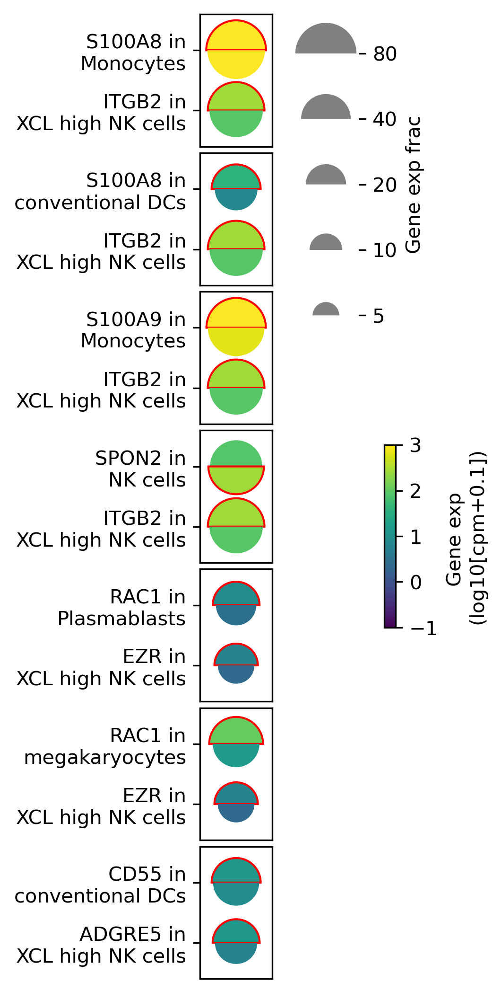

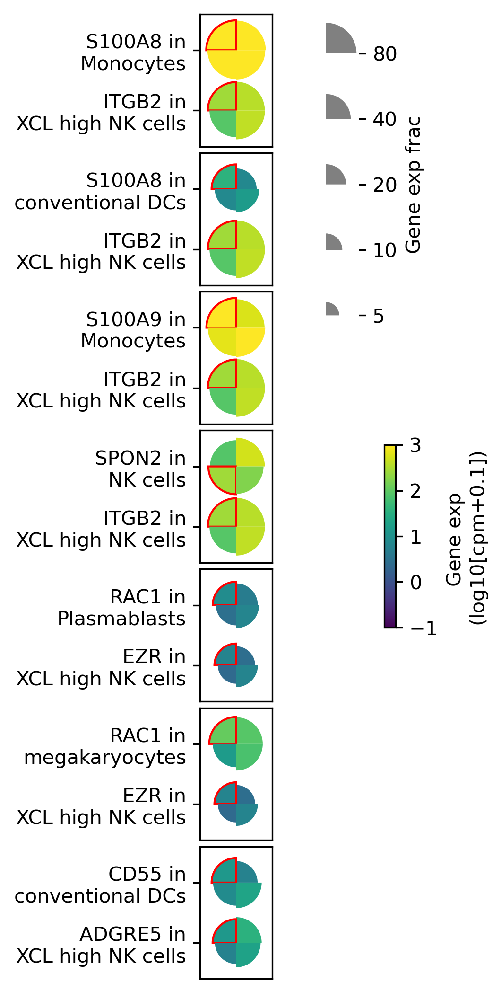

In [65]:
high_its = [{'ga': NK_g, 
            'csta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'cstb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(high_inters['inter_type'], 
                                               high_inters['NK_gene'], 
                                               high_inters['im_ct'], 
                                               high_inters['im_gene'])
          ]

h_its = genes_transfer(high_its)

s_mushrooms(h_its)['figure'].savefig(save_figures + 'mush_NK_high_inters.png', bbox_inches = 'tight')
s_flowers(h_its)['figure'].savefig(save_figures + 'flow_NK_high_inters.png', bbox_inches = 'tight')

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

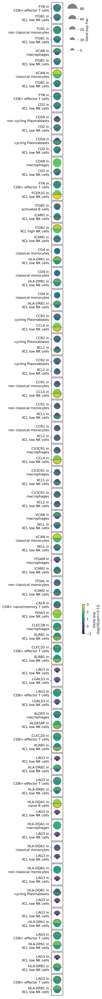

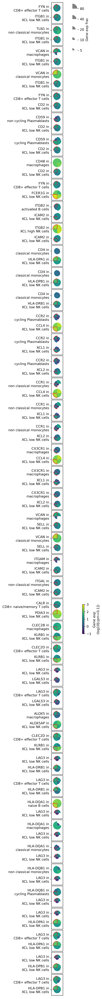

In [66]:
cst_low_its = [{'ga': NK_g, 
            'csta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'cstb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_low_inters['inter_type'], 
                                               cst_low_inters['NK_gene'], 
                                               cst_low_inters['im_ct'], 
                                               cst_low_inters['im_gene'])
          ]

cst_l_its = genes_transfer(cst_low_its)

s_mushrooms(cst_l_its)['figure'].savefig(save_figures + 'mush_NK_low_cst_inters.png', bbox_inches='tight')
s_flowers(cst_l_its)['figure'].savefig(save_figures + 'flow_NK_low_cst_inters.png', bbox_inches='tight')

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

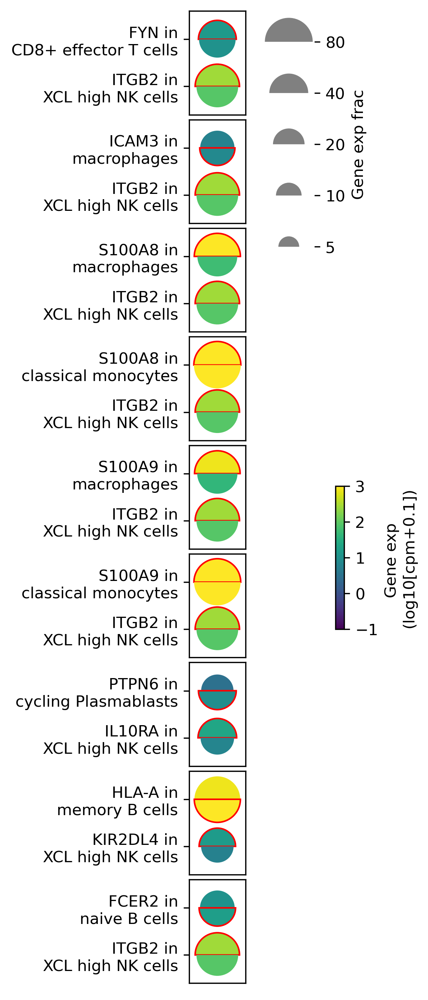

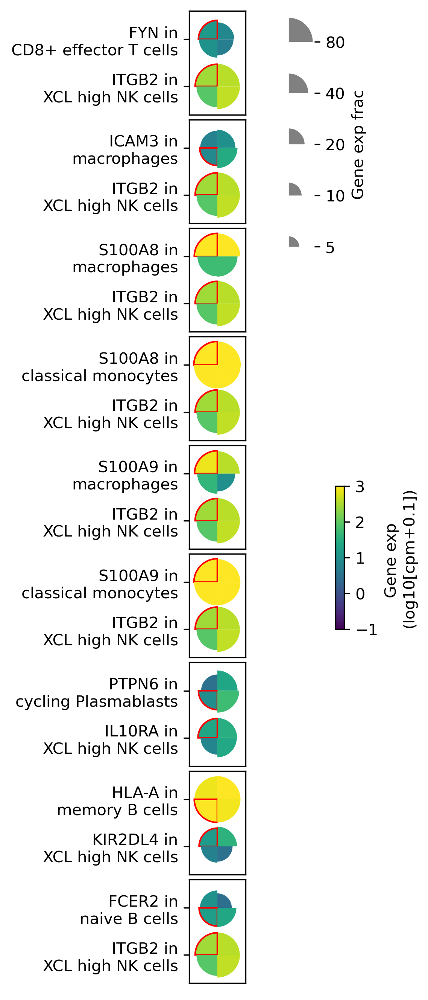

In [67]:
cst_high_its = [{'ga': NK_g, 
            'csta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'cstb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_high_inters['inter_type'], 
                                               cst_high_inters['NK_gene'], 
                                               cst_high_inters['im_ct'], 
                                               cst_high_inters['im_gene'])
          ]

cst_h_its = genes_transfer(cst_high_its)

s_mushrooms(cst_h_its)['figure'].savefig(save_figures + 'mush_NK_high_cst_inters.png', bbox_inches = 'tight')
s_flowers(cst_h_its)['figure'].savefig(save_figures + 'flow_NK_high_cst_inters.png', bbox_inches = 'tight')

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

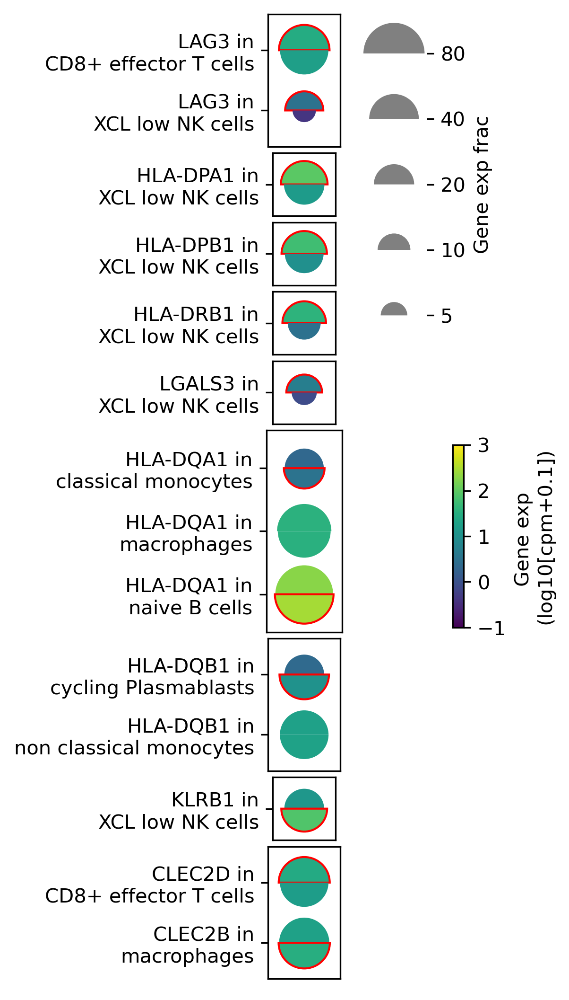

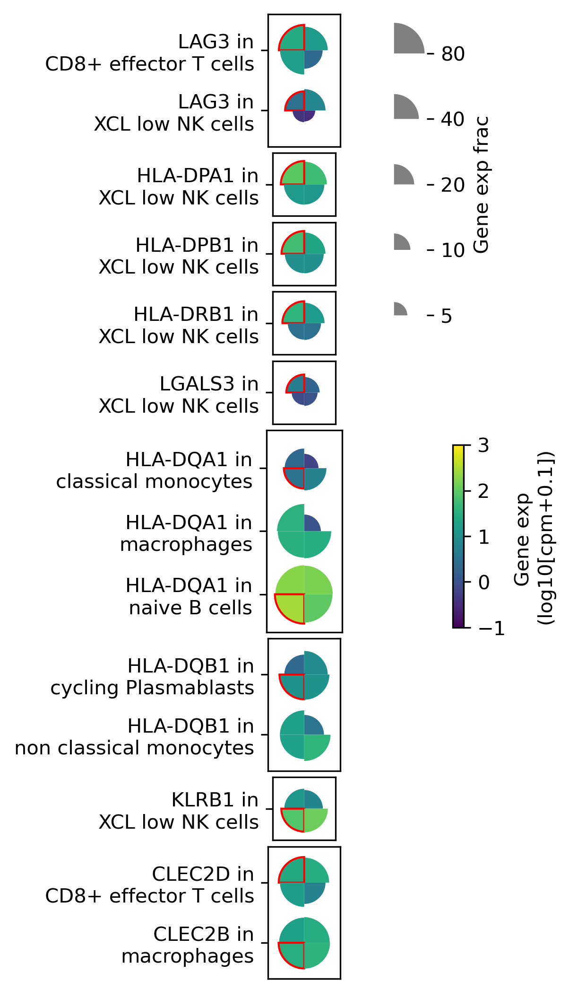

In [115]:
# gs = [{['LAG3': ['NK_cells']]},
#       {'HLA-DPA1': ['XCL_low NK cells']},
#      {'HLA-DPB1': ['XCL_low NK cells']},
#      {'HLA-DRB1': ['XCL_low NK cells']},
#      {'LGALS3': ['XCL_low NK cells']},
#       {'LAG3': ['XCL_low NK cells']},
#      {'HLA-DQA1': ['plasmacytoid DCs']},
#      {'HLA-DQA1': ['conventional DCs']},
      
#      {'KLRB1': ['XCL_low NK cells'], 'CLEC2B': ['conventional DCs']},]

gs = [
 {'LAG3': ['XCL_low NK cells', 'CD8+ effector T cells']}, 
    
 {'HLA-DPA1': ['XCL_low NK cells']},
 {'HLA-DPB1': ['XCL_low NK cells']},
 {'HLA-DRB1': ['XCL_low NK cells'],},
 {'LGALS3': ['XCL_low NK cells']},
    
 {'HLA-DQA1': ['naive B cells', 'macrophages', 'classical monocytes']},
 {'HLA-DQB1': ['non_classical monocytes', 'cycling Plasmablasts']},

 {'KLRB1': ['XCL_low NK cells'],},
 {'CLEC2B': ['macrophages'], 'CLEC2D': ['CD8+ effector T cells']},]

s_mushrooms(gs)['figure'].savefig(save_figures + 'mushs/mush_low.png', bbox_inches = 'tight')
s_flowers(gs)['figure'].savefig(save_figures + 'mushs/flow_low.png', bbox_inches = 'tight')

<ipython-input-152-cb787540275f>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-152-cb787540275f>:893: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 468x720 with 3 Axes>, 'axs': <AxesSubplot:>}

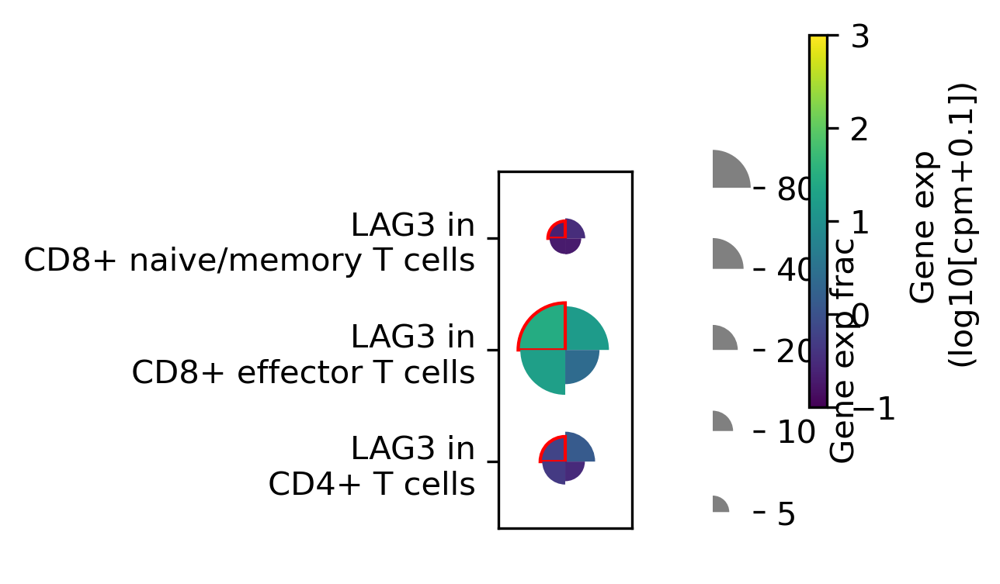

In [227]:
# s_mushrooms([{'HLA-DRA': ['XCL_low NK cells'], 'HLA-DRB1': ['XCL_low NK cells']},
#             {'HLA-DPA1': ['XCL_low NK cells'], 'HLA-DPB1': ['XCL_low NK cells']},
#             {'LGALS3': ['XCL_low NK cells']},]
#            )
s_flowers([{'LAG3': ['CD4+ T cells', 'CD8+ effector T cells', 'CD8+ naive/memory T cells']},]
           )

<ipython-input-41-4c65e3d36739>:832: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-41-4c65e3d36739>:917: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-41-4c65e3d36739>:684: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

{'figure': <Figure size 468x360 with 3 Axes>, 'axs': <AxesSubplot:>}

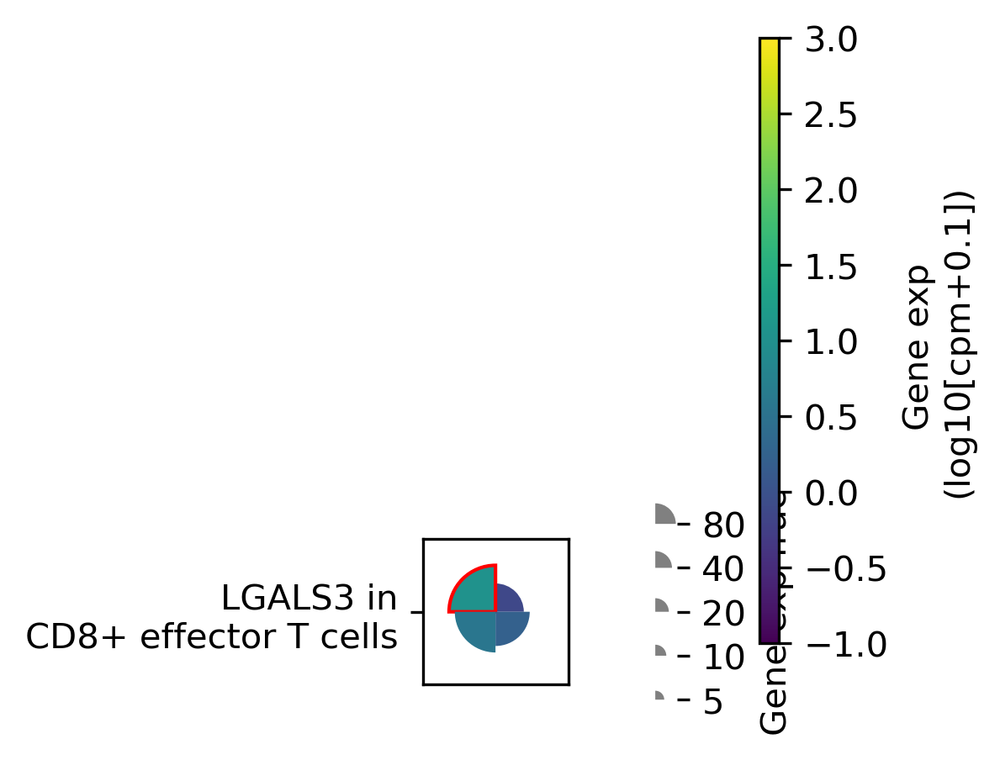

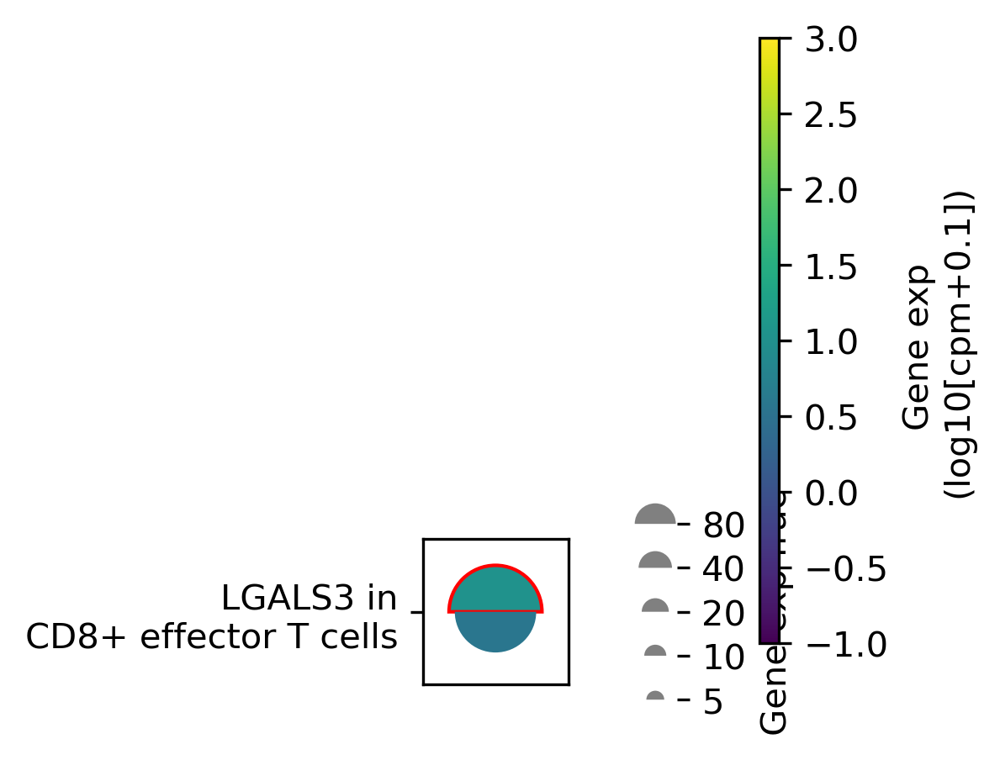

In [47]:
s_flowers([{'LGALS3': ['CD8+ effector T cells']},])
s_mushrooms([{'LGALS3': ['CD8+ effector T cells']},])

<ipython-input-152-cb787540275f>:594: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1800x1200 with 10 Axes>,
 'axs': [<AxesSubplot:title={'center':'KIR2DL1'}>,
  <AxesSubplot:title={'center':'KIR2DL3'}>,
  <AxesSubplot:title={'center':'KIR2DL4'}>,
  <AxesSubplot:title={'center':'KIR3DL1'}>,
  <AxesSubplot:title={'center':'KIR3DL2'}>,
  <AxesSubplot:title={'center':'KIR3DL3'}>,
  <AxesSubplot:title={'center':'KIR3DX1'}>,
  <AxesSubplot:title={'center':'IL10'}>,
  <AxesSubplot:ylabel='Gene exp frac'>]}

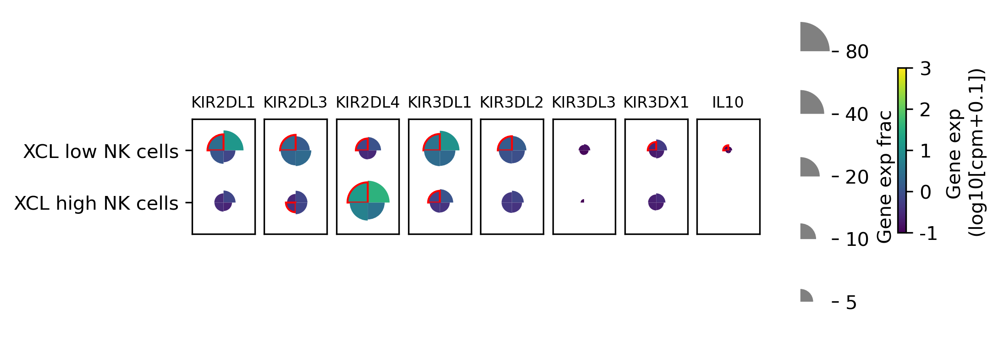

In [171]:
KIR_gs = ['KIR2DL1', 'KIR2DL3', 'KIR2DL4',
          'KIR3DL1', 'KIR3DL2', 'KIR3DL3', 'KIR3DX1', 'IL10']
com_flowers(KIR_gs, ['XCL_high NK cells','XCL_low NK cells', ])

<ipython-input-166-1d11af09386b>:625: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 600x2400 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'MHC class I genes'}>}

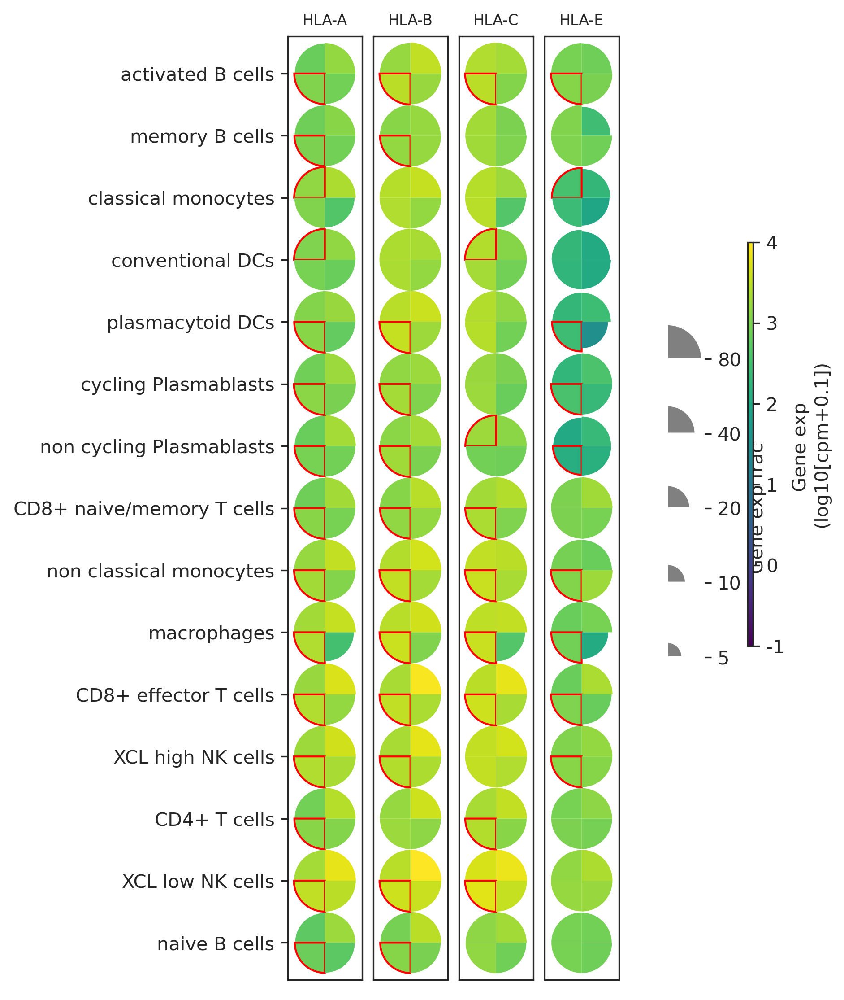

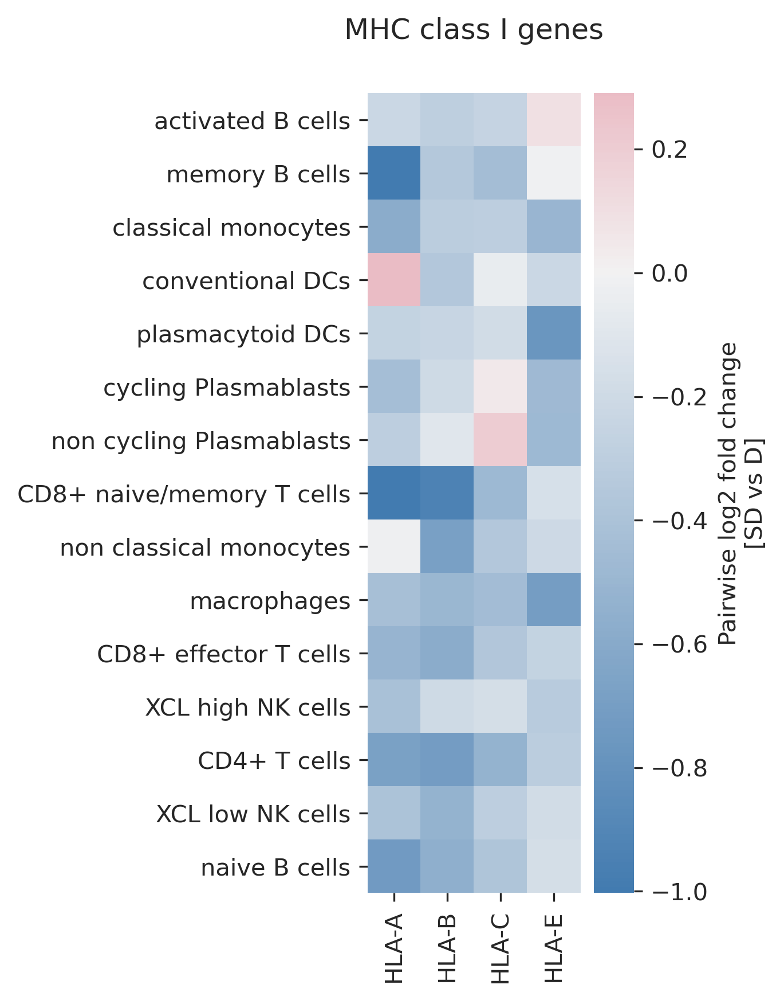

In [170]:
csts = adata_kid.obs['cell_subtype_new'].unique().tolist()
csts.remove('doublets')
csts.remove('megakaryocytes')
#csts.remove('plasmacytoid DCs')
#csts.remove('conventional DCs')
csts.remove('unknown')

com_flowers(['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E'], csts, vmax=4)

csts.reverse()
heatmap_cst(['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E'], csts, 'MHC class I genes', save_fd=False)

<ipython-input-152-cb787540275f>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-152-cb787540275f>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-152-cb787540275f>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values(

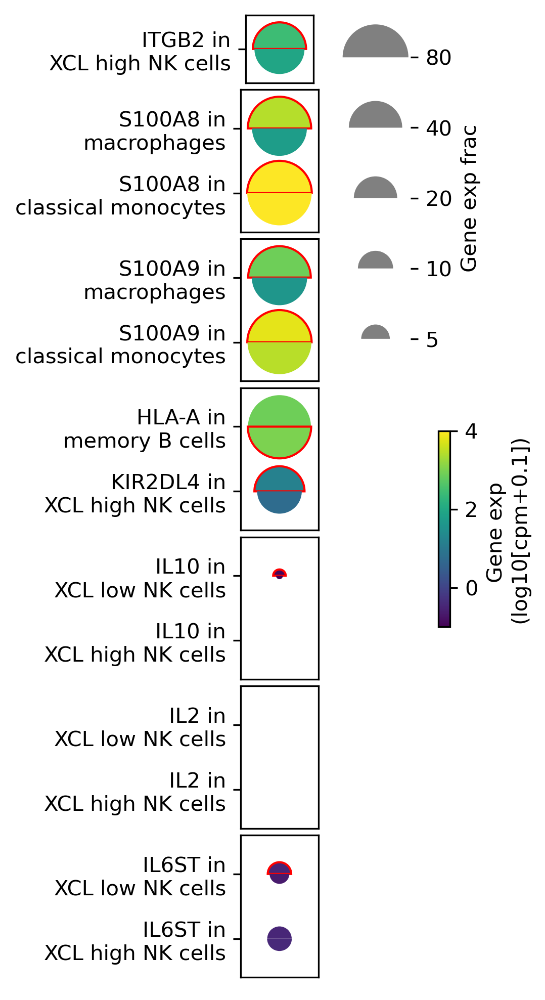

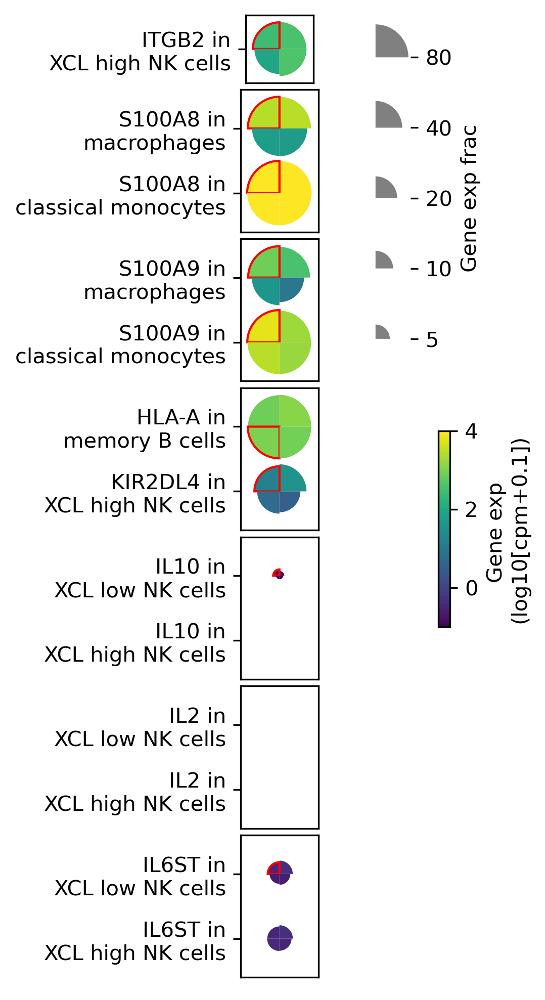

In [170]:
gs =[{'ITGB2': ['XCL_high NK cells']},
     {'S100A8': ['classical monocytes', 'macrophages']},
     {'S100A9': ['classical monocytes', 'macrophages']},
     {'KIR2DL4': ['XCL_high NK cells'], 'HLA-A': ['memory B cells']},
    {'IL10': ['XCL_high NK cells', 'XCL_low NK cells']},
     {'IL2': ['XCL_high NK cells', 'XCL_low NK cells']},
     {'IL6ST': ['XCL_high NK cells', 'XCL_low NK cells']},
    ]
s_mushrooms(gs, vmax=4)['figure'].savefig(save_figures + 'mushs/mush_high.png', bbox_inches = 'tight')
s_flowers(gs, vmax=4)['figure'].savefig(save_figures + 'mushs/flow_high.png', bbox_inches = 'tight')

<ipython-input-20-4043faa4f909>:660: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
<ipython-input-20-4043faa4f909>:741: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-20-4043faa4f909>:808: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))

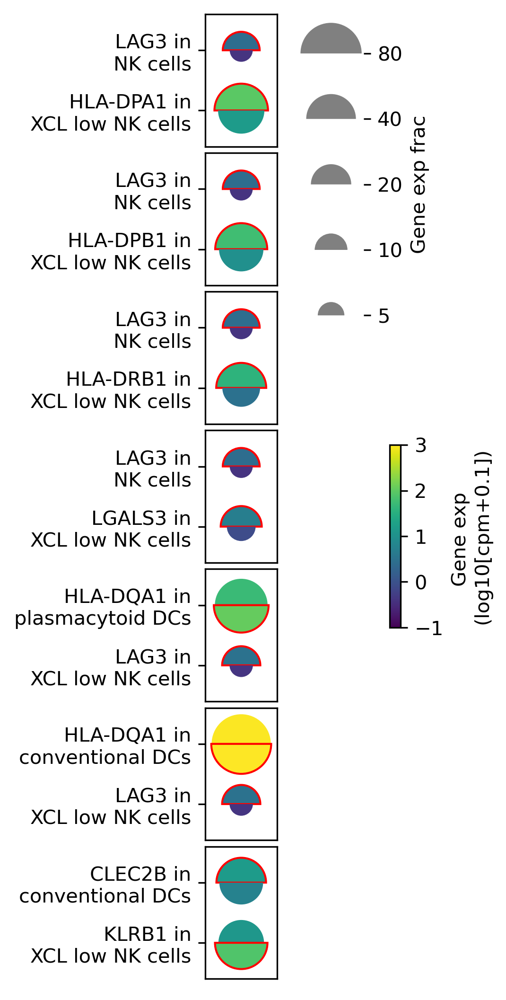

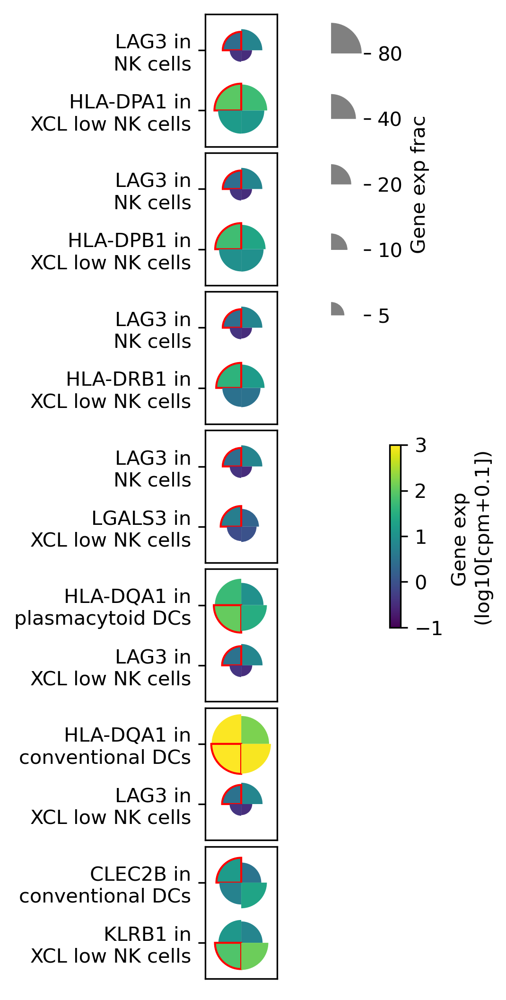

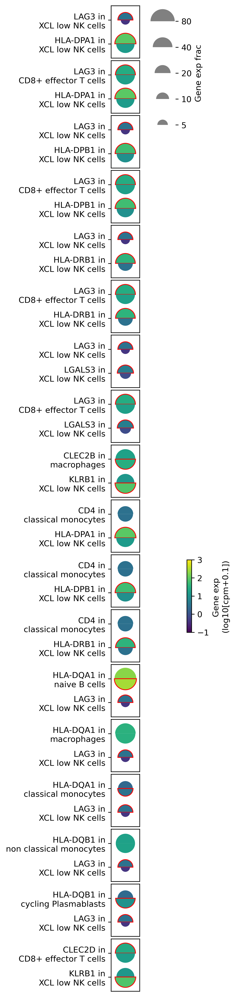

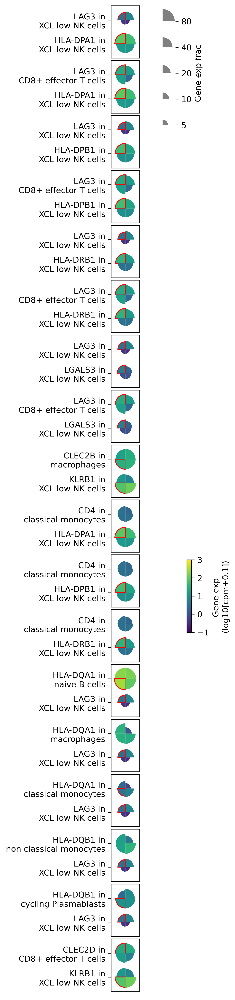

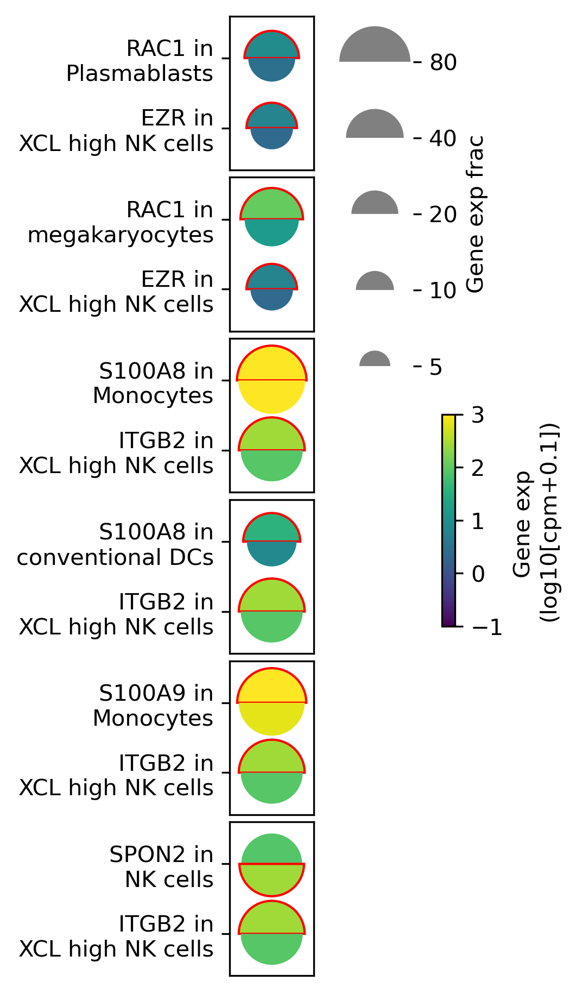

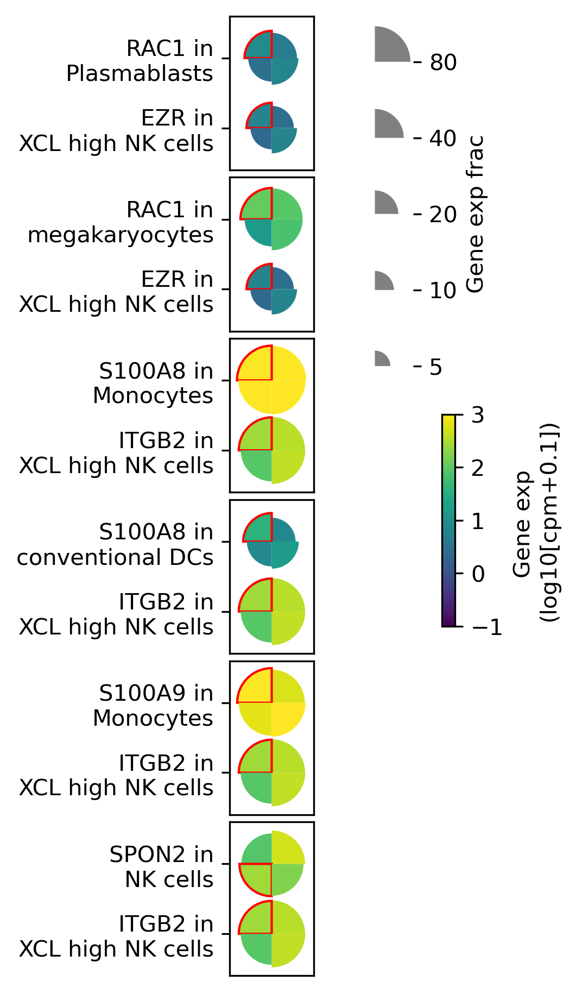

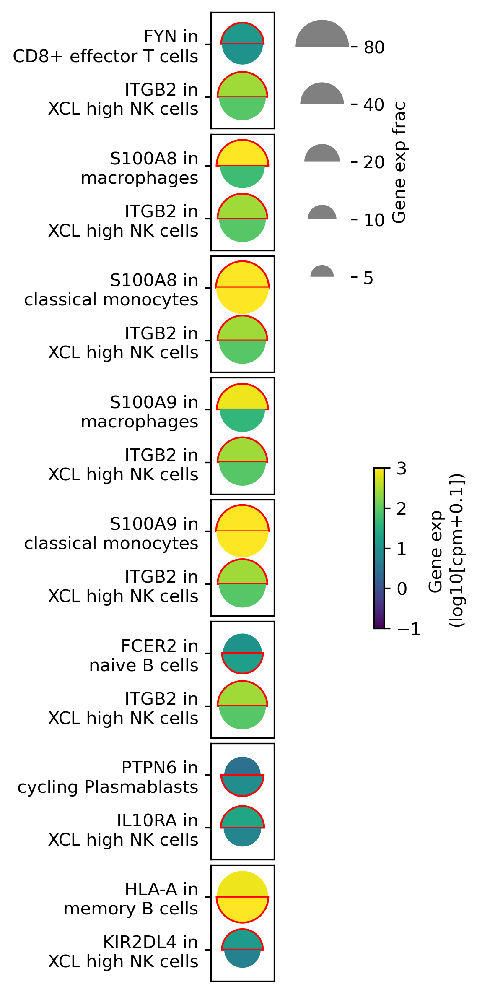

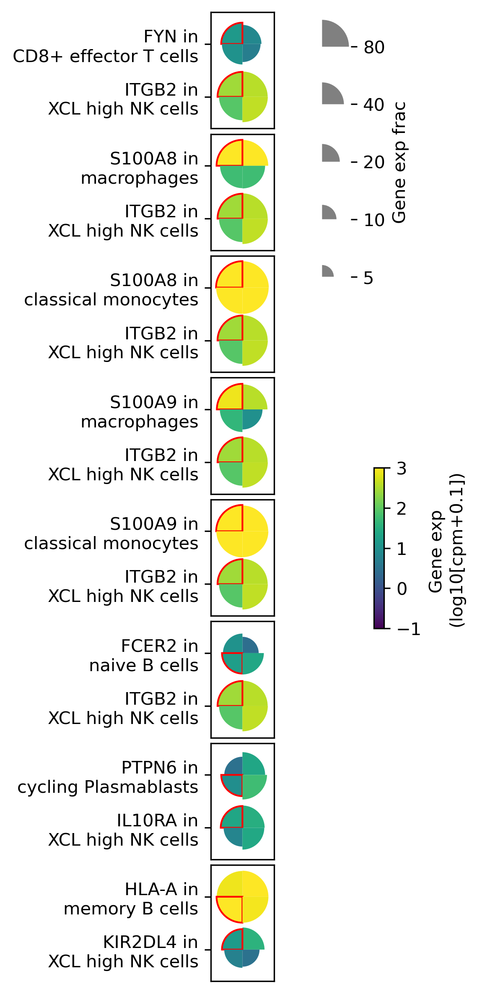

In [79]:
show_l_its = [{'HLA-DPA1': ['XCL_low NK cells'], 'LAG3': ['NK_cells']},
 {'HLA-DPB1': ['XCL_low NK cells'], 'LAG3': ['NK_cells']},
 {'HLA-DRB1': ['XCL_low NK cells'], 'LAG3': ['NK_cells']},
 {'LGALS3': ['XCL_low NK cells'], 'LAG3': ['NK_cells']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQA1': ['plasmacytoid DCs']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQA1': ['conventional DCs']},
 {'KLRB1': ['XCL_low NK cells'], 'CLEC2B': ['conventional DCs']},]

s_mushrooms(show_l_its)['figure'].savefig(save_figures + 'mushs/mush_NK_low_inters.png', bbox_inches = 'tight')
s_flowers(show_l_its)['figure'].savefig(save_figures + 'mushs/flow_NK_low_inters.png', bbox_inches = 'tight')

show_cst_l_its = [
 {'HLA-DPA1': ['XCL_low NK cells'], 'LAG3': ['XCL_low NK cells']},
 {'HLA-DPA1': ['XCL_low NK cells'], 'LAG3': ['CD8+ effector T cells']},
 {'HLA-DPB1': ['XCL_low NK cells'], 'LAG3': ['XCL_low NK cells']},
 {'HLA-DPB1': ['XCL_low NK cells'], 'LAG3': ['CD8+ effector T cells']},
 {'HLA-DRB1': ['XCL_low NK cells'], 'LAG3': ['XCL_low NK cells']},
 {'HLA-DRB1': ['XCL_low NK cells'], 'LAG3': ['CD8+ effector T cells']},
 {'LGALS3': ['XCL_low NK cells'], 'LAG3': ['XCL_low NK cells']},
 {'LGALS3': ['XCL_low NK cells'], 'LAG3': ['CD8+ effector T cells']},
 {'KLRB1': ['XCL_low NK cells'], 'CLEC2B': ['macrophages']},
 {'HLA-DPA1': ['XCL_low NK cells'], 'CD4': ['classical monocytes']},
 {'HLA-DPB1': ['XCL_low NK cells'], 'CD4': ['classical monocytes']},
 {'HLA-DRB1': ['XCL_low NK cells'], 'CD4': ['classical monocytes']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQA1': ['naive B cells']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQA1': ['macrophages']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQA1': ['classical monocytes']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQB1': ['non_classical monocytes']},
 {'LAG3': ['XCL_low NK cells'], 'HLA-DQB1': ['cycling Plasmablasts']},
 {'KLRB1': ['XCL_low NK cells'], 'CLEC2D': ['CD8+ effector T cells']},]

s_mushrooms(show_cst_l_its)['figure'].savefig(save_figures + 'mushs/mush_NK_low_cst_inters.png', bbox_inches = 'tight')
s_flowers(show_cst_l_its)['figure'].savefig(save_figures + 'mushs/flow_NK_low_cst_inters.png', bbox_inches = 'tight')

show_h_its = [{'EZR': ['XCL_high NK cells'], 'RAC1': ['Plasmablasts']},
 {'EZR': ['XCL_high NK cells'], 'RAC1': ['megakaryocytes']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A8': ['Monocytes']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A8': ['conventional DCs']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A9': ['Monocytes']},
 {'ITGB2': ['XCL_high NK cells'], 'SPON2': ['NK_cells']}]

s_mushrooms(show_h_its)['figure'].savefig(save_figures + 'mushs/mush_NK_high_inters.png', bbox_inches = 'tight')
s_flowers(show_h_its)['figure'].savefig(save_figures + 'mushs/flow_NK_high_inters.png', bbox_inches = 'tight')

show_cst_h_its = [{'ITGB2': ['XCL_high NK cells'], 'FYN': ['CD8+ effector T cells']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A8': ['macrophages']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A8': ['classical monocytes']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A9': ['macrophages']},
 {'ITGB2': ['XCL_high NK cells'], 'S100A9': ['classical monocytes']},
 {'ITGB2': ['XCL_high NK cells'], 'FCER2': ['naive B cells']},
 {'IL10RA': ['XCL_high NK cells'], 'PTPN6': ['cycling Plasmablasts']},

 {'KIR2DL4': ['XCL_high NK cells'], 'HLA-A': ['memory B cells']}]

s_mushrooms(show_cst_h_its)['figure'].savefig(save_figures + 'mushs/mush_NK_high_cst_inters.png', bbox_inches = 'tight')
s_flowers(show_cst_h_its)['figure'].savefig(save_figures + 'mushs/flow_NK_high_cst_inters.png', bbox_inches = 'tight')


In [117]:
cts = adata_kid.obs['cell_type_new'].unique().tolist()
cts.remove('doublets')
cts.remove('unknown')

csts = adata_kid.obs['cell_subtype_new'].unique().tolist()
csts.remove('doublets')
csts.remove('unknown')

def number_ct_bar(ran_inters, cts, title, name=False):
    ct_n = {ct: 0 for ct in cts}
    for inter in ran_inters:
        for ct in cts:
            if inter['ctb'] == ct:
                ct_n[ct] += 1

    sig_it_n = pd.DataFrame(ct_n.values(), columns=['Number of interactions'])
    sig_it_n['Cell type'] = [ct.replace('_', ' ') for ct in ct_n.keys()]
    sig_it_n.sort_values('Number of interactions', ascending=False, inplace=True)

    fig, ax = plt.subplots(figsize=[0.5 + 0.3 * len(cts), 2.25], dpi=300)
    ax = sns.barplot(data=sig_it_n, x='Cell type', y='Number of interactions')
    ax.set_xticklabels([ct.replace('_', ' ') for ct in sig_it_n['Cell type'].tolist()], rotation=90)
    ax.set_ylim(0, sig_it_n['Number of interactions'].max() + 1)
    ax.set_xlabel(None)
    ax.set_ylabel('Number of interactions')
    ax.set_title(title)
    if name is not False:
        fig.savefig(save_figures + 'n_inters_cts.png', bbox_inches='tight')
        
    return {'figure': fig, 'ax': ax}

In [118]:
low_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(low_inters['inter_type'], 
                                               low_inters['NK_gene'], 
                                               low_inters['im_ct'], 
                                               low_inters['im_gene'])
          ]

high_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(high_inters['inter_type'], 
                                               high_inters['NK_gene'], 
                                               high_inters['im_ct'], 
                                               high_inters['im_gene'])
          ]

cst_low_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_low_inters['inter_type'], 
                                               cst_low_inters['NK_gene'], 
                                               cst_low_inters['im_ct'], 
                                               cst_low_inters['im_gene'])
          ]

cst_high_its = [{'ga': NK_g, 
            'cta': ['XCL_low NK cells', 'XCL_high NK cells']['low' not in NK_ct], 
            'gb': im_g, 
            'ctb': im_ct}
           for NK_ct, NK_g, im_ct, im_g in zip(cst_high_inters['inter_type'], 
                                               cst_high_inters['NK_gene'], 
                                               cst_high_inters['im_ct'], 
                                               cst_high_inters['im_gene'])
          ]

{'figure': <Figure size 870x675 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'XCL low NK cells'}, ylabel='Number of interactions'>}

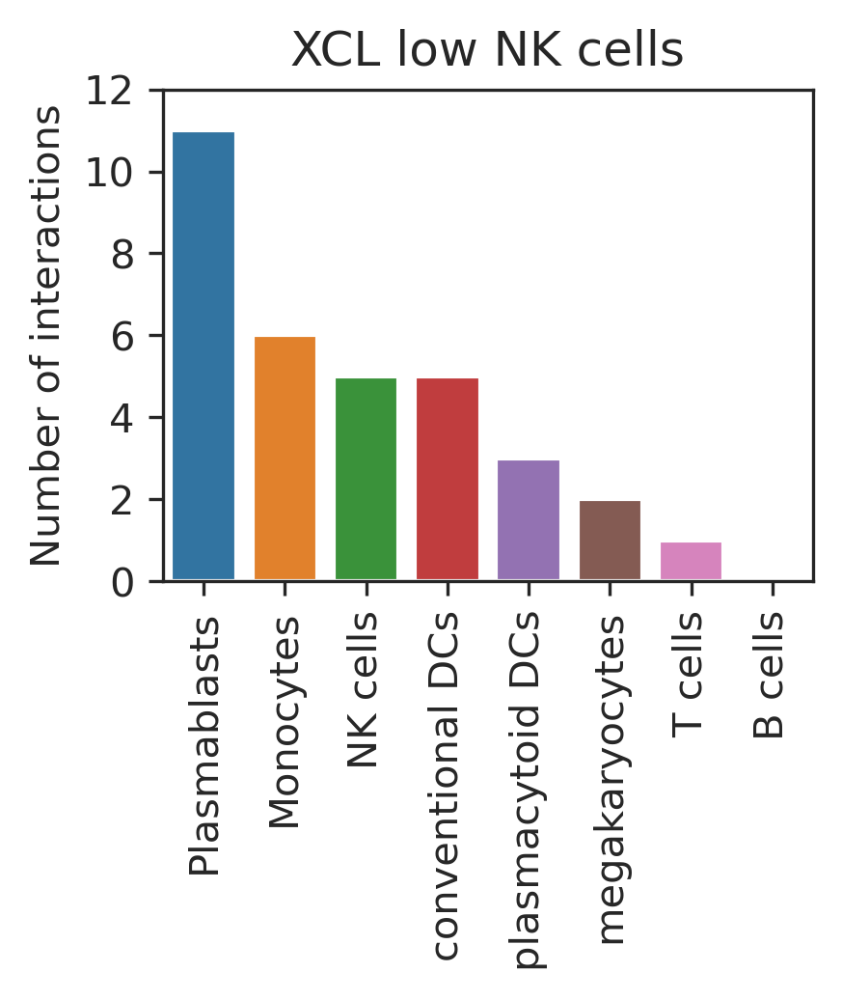

In [119]:
number_ct_bar(low_its, cts, 'XCL low NK cells', name=False)

{'figure': <Figure size 870x675 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'XCL high NK cells'}, ylabel='Number of interactions'>}

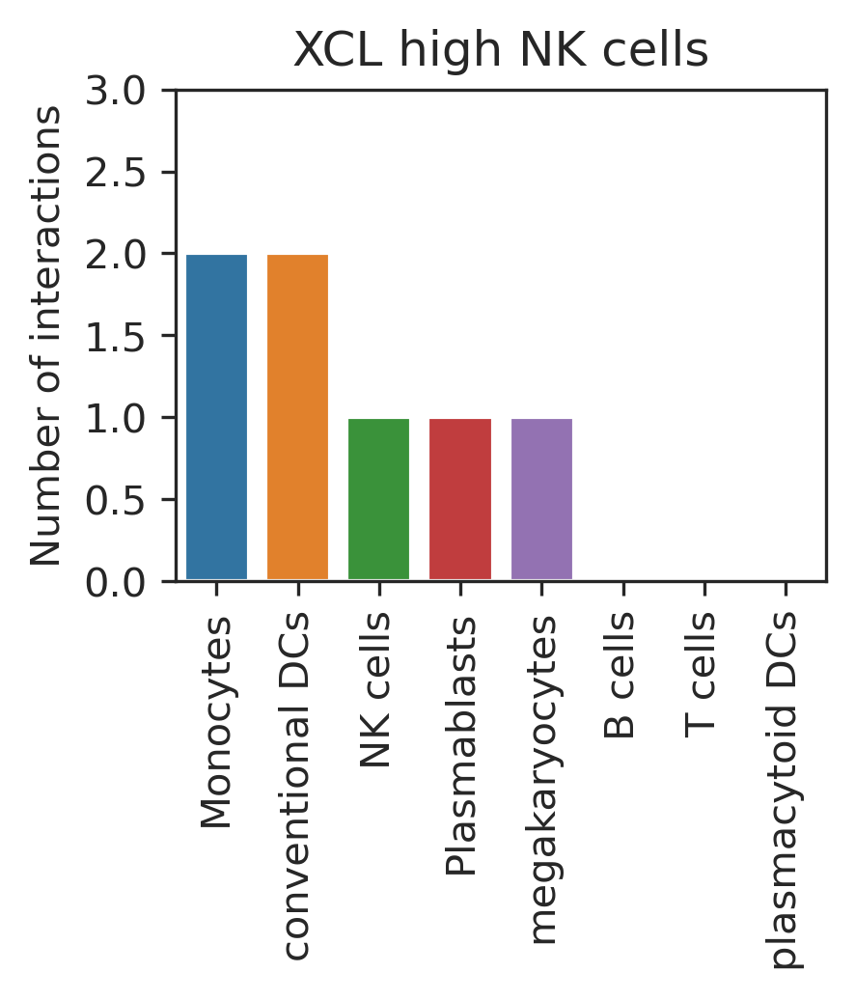

In [120]:
number_ct_bar(high_its, cts, 'XCL high NK cells', name=False)

{'figure': <Figure size 1590x675 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'XCL low NK cells'}, ylabel='Number of interactions'>}

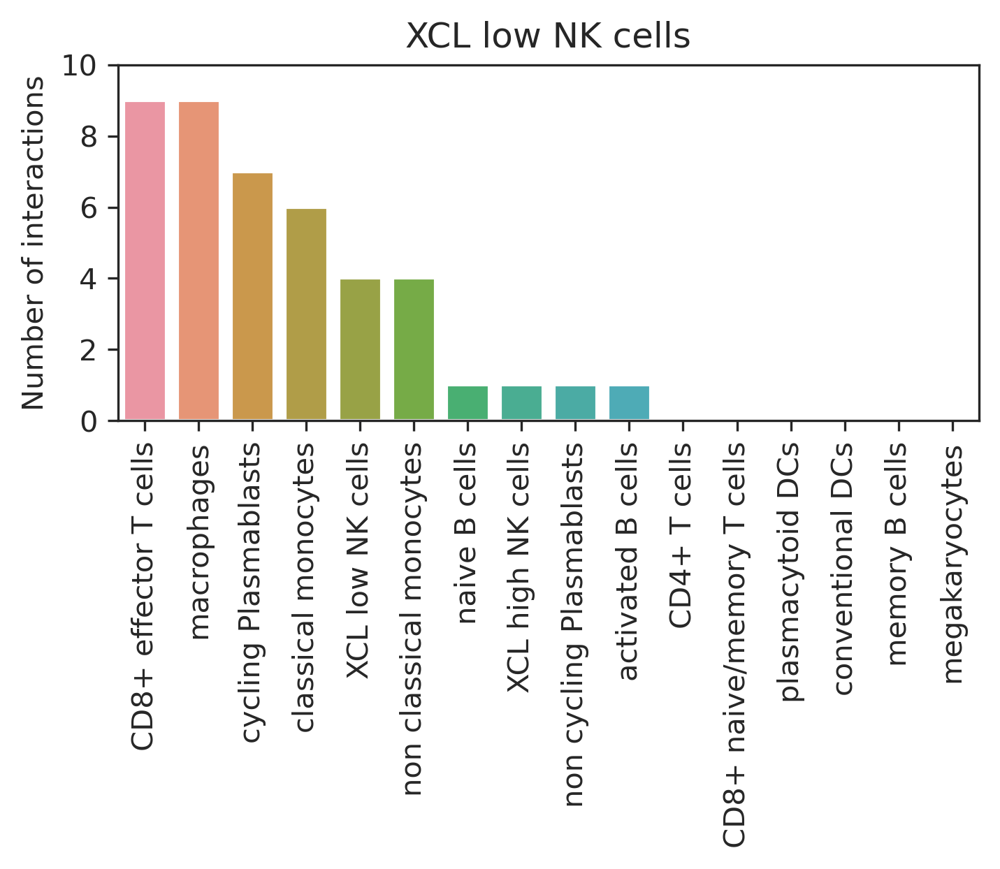

In [121]:
number_ct_bar(cst_low_its, csts, 'XCL low NK cells', name=False)

{'figure': <Figure size 1590x675 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'XCL high NK cells'}, ylabel='Number of interactions'>}

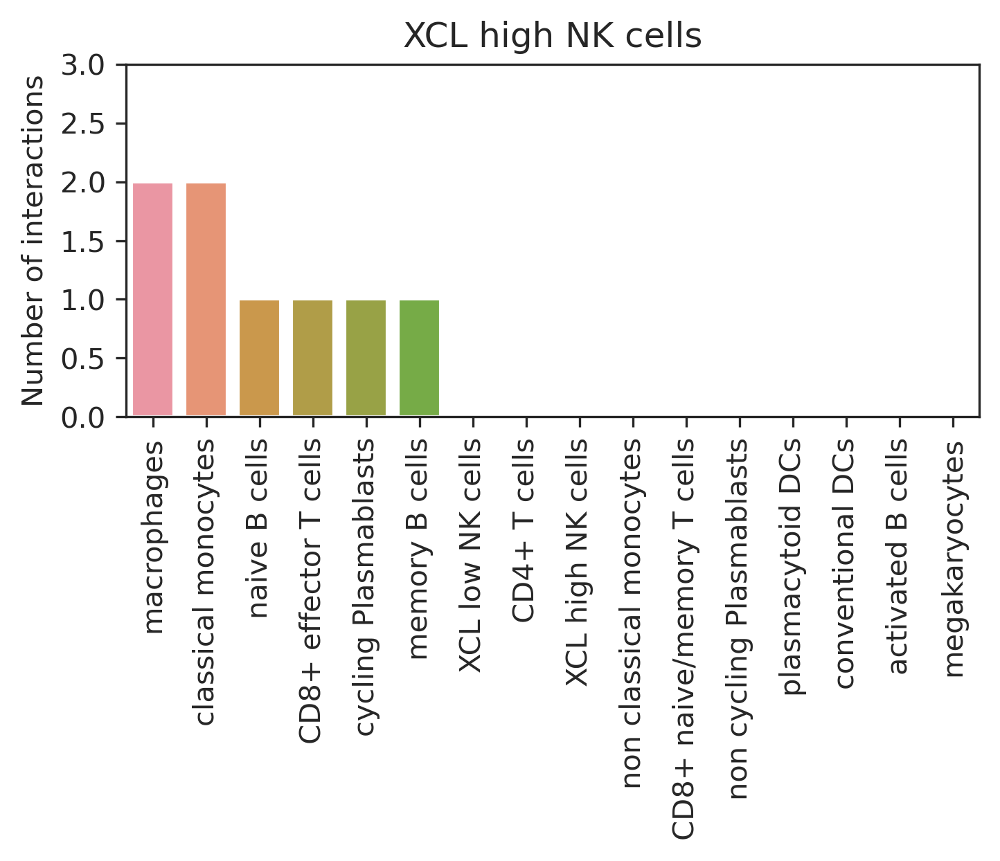

In [122]:
number_ct_bar(cst_high_its, csts, 'XCL high NK cells', name=False)

# Transcription factor

In [80]:
TF_fn = '/home/yike/phd/literature/human_transcription_factor/DatabaseExtract_v_1.01.csv'
TF = pd.read_csv(TF_fn, sep=',')
TF_genes = np.unique(TF['HGNC symbol'])

In [106]:
NK_data = pd.read_csv(save_tabels + 'data_SD_low_vs_high.tsv', sep='\t', index_col='gene')
NK_TF = NK_data.loc[[g for g in TF_genes if g in NK_data.index]]
marker_TF = {}
marker_TF['XCL_low NK cells'] = NK_TF[(NK_TF['DEGs'] == 'Yes') & (NK_TF['log2_fold_change'] > 0)].index.tolist()
marker_TF['XCL_high NK cells'] = NK_TF[(NK_TF['DEGs'] == 'Yes') & (NK_TF['log2_fold_change'] < 0)].index.tolist()

In [107]:
marker_TF

{'XCL_low NK cells': ['ASCL2',
  'DEK',
  'FLNA',
  'HLA-DRB1',
  'LYAR',
  'PLEK',
  'ZEB2'],
 'XCL_high NK cells': ['APEX1',
  'BHLHE40',
  'COMMD6',
  'CSRNP1',
  'CTNNBIP1',
  'EID1',
  'EIF3K',
  'FOS',
  'GATA3',
  'HIF1A',
  'HNRNPA1',
  'ID2',
  'JUN',
  'JUNB',
  'LEF1',
  'MPG',
  'NFKBIA',
  'NFKBIZ',
  'NME2',
  'NPM1',
  'PHB2',
  'POLR2L',
  'PRMT2',
  'RPL36A',
  'RPL7',
  'SATB1',
  'SOX4',
  'TCF7',
  'TNFAIP3',
  'TRAF5',
  'TSC22D3',
  'XCL1',
  'ZFP36',
  'ZFP36L2']}

In [108]:
df, r = pairwise_processing(cst_pair.loc['XCL_low NK cells'], cst_pair.loc['XCL_high NK cells'])

######################## filter to get DEGs
low_df = df[(df['outlier'].isin(['both', 'x_only'])) & 
            (((df['markers'].isin(['5']) & df['S_fra'] >= 0.1)) | 
             ((df['markers'].isin(['7']) & df['NS_fra'] >= 0.1)))]
high_df = df[(df['outlier'].isin(['both', 'y_only'])) & 
            (((df['markers'].isin(['6']) & df['S_fra'] >= 0.1)) | 
             ((df['markers'].isin(['8']) & df['NS_fra'] >= 0.1)))]
low_genes = low_df.index.tolist()
high_genes = high_df.index.tolist()

DE_TFs = {}
for cst, genes in zip(['XCL_low NK cells', 'XCL_high NK cells'], [low_genes, high_genes]):
    DE_TFs[cst] = [g for g in genes if g in TF_genes]

In [113]:
DE_TFs

{'XCL_low NK cells': ['FOS', 'HLA-DRB1', 'XCL1'],
 'XCL_high NK cells': ['BIN1',
  'FLI1',
  'GPBP1',
  'HIF1A',
  'HIST1H1D',
  'HNRNPK',
  'HNRNPU',
  'IQGAP1',
  'ITGB2',
  'KLF6',
  'MBNL1',
  'NONO',
  'RBL2',
  'STAT3',
  'ZC3HAV1']}

<ipython-input-29-cb787540275f>:594: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1650x1200 with 9 Axes>,
 'axs': [<AxesSubplot:title={'center':'IFNG'}>,
  <AxesSubplot:title={'center':'CD2'}>,
  <AxesSubplot:title={'center':'CD244'}>,
  <AxesSubplot:title={'center':'ITGB2'}>,
  <AxesSubplot:title={'center':'CD226'}>,
  <AxesSubplot:title={'center':'CXCR3'}>,
  <AxesSubplot:title={'center':'FLT3LG'}>,
  <AxesSubplot:ylabel='Gene exp frac'>]}

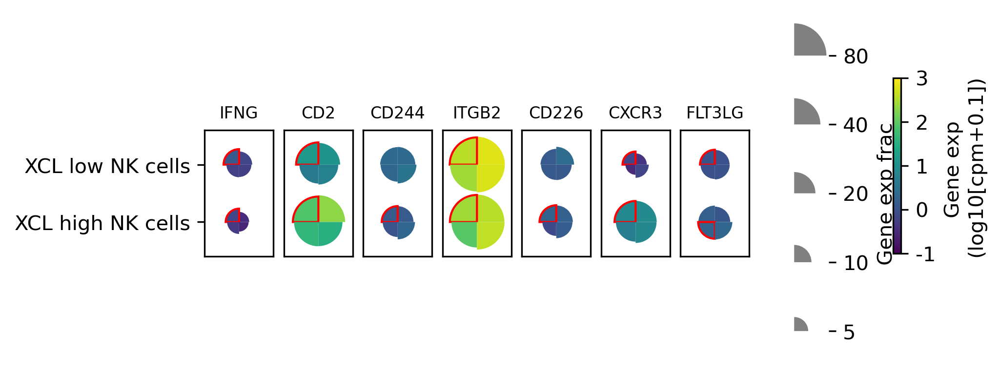

In [37]:
KIR_gs = ['IFNG', 'CD2', 'CD244', 'ITGB2', 'CD226', 'CXCR3', 'FLT3LG']
com_flowers(KIR_gs, ['XCL_high NK cells','XCL_low NK cells', ])

In [35]:
ct_pair.loc['NK_cells'].loc[['IFNG', 'CD2', 'CD244', 'ITGB2', 'CD226']]

,med_pair,fra_pair,neg_fra_pair,S_fra,NS_fra,S_avg,NS_avg,log2_fold_change,statistic,pvalue
gene,,,,,,,,,,
IFNG,0.218701,0.571429,0.428571,0.121897,0.064016,1.102071,0.489011,0.497457,0.057881,2.915870e-12
CD2,1.049671,0.803571,0.196429,0.454254,0.267607,17.895092,4.732133,1.720868,0.186647,2.903625e-124
CD244,0.125422,0.589286,0.410714,0.186192,0.172812,2.100666,1.955902,0.068979,0.020515,6.474292e-02
ITGB2,0.498147,0.660714,0.339286,0.837238,0.792134,365.006165,249.244095,0.548532,0.088763,2.821502e-28
CD226,0.087642,0.589286,0.410714,0.139331,0.119910,1.307752,1.113469,0.126875,0.019420,9.239511e-02


In [ ]:
# import anndataks

# #csts = ['CD4+ T cells', 'CD8+ effector T cells', 'CD8+ naive/memory T cells']
# conditions = ['Healthy', 'dengue', 'DWS', 'S_dengue']
# #adata_SD = adata_kid[adata_kid.obs['Condition'] == 'yes']

# results = {}
# for cd in conditions:
    
#     adata_cd = adata_kid[adata_kid.obs['Condition'] == cd]
        
#     adata_low = adata_cd[adata_cd.obs['cell_subtype_new'] == 'XCL_low NK cells']
#     adata_high = adata_cd[adata_cd.obs['cell_subtype_new'] == 'XCL_high NK cells']
#     # while calculating ks test pvalue, the adata is log1ped, so the argument log1p=2
#     results[cd] = anndataks.compare(adata_high, adata_low, log1p=2, mode='asymp') 
#     # log2_fold_change: adata_low vs adata_high

# ks_res = pd.DataFrame([])
# for cd in conditions:
#     results[cd]['condition'] = [cd] * results[cd].shape[0]
#     ks_res = pd.concat([ks_res, results[cd]])

# ks_res.set_index(['condition', ks_res.index], inplace=True)
# ks_res.to_csv(save_tabels + 'NK_cells/ks_pvalue_cd_low_vs_high.tsv', sep='\t')


############################################
# data = ks_res.loc['S_dengue']
# data['-log10[pvalue]'] = -np.log10(data['pvalue'])

# req = ((data['log2_fold_change'] > 1) | (data['log2_fold_change'] < -1)) & (data['-log10[pvalue]'] > 10)
# data.loc[(data['log2_fold_change'] > 1) & (data['-log10[pvalue]'] > 10), 'DEGs'] = 'Yes'
# data.loc[(data['log2_fold_change'] < -1) & (data['-log10[pvalue]'] > 10), 'DEGs'] = 'Yes'
# data.loc[~ req, 'DEGs'] = 'No'

# data['low_fra'] = cst_pair.loc['XCL_low NK cells'].loc[data.index]['S_fra']
# data['high_fra'] = cst_pair.loc['XCL_high NK cells'].loc[data.index]['S_fra']

# data['low_avg'] = cst_pair.loc['XCL_low NK cells'].loc[data.index]['S_avg']
# data['high_avg'] = cst_pair.loc['XCL_high NK cells'].loc[data.index]['S_avg']
# data.to_csv(save_tabels + 'data_SD_low_vs_high.tsv', sep='\t')

##############################################
# def scatter_plot(data, name, ylim=200, xlim=3, y_cut=10):
#     #from adjustText import adjust_text
#     data['-log10[pvalue]'] = -np.log10(data['pvalue'])
    
#     req = ((data['log2_fold_change'] > 1) | (data['log2_fold_change'] < -1)) & (data['-log10[pvalue]'] > y_cut)
#     data.loc[(data['log2_fold_change'] > 1) & (data['-log10[pvalue]'] > y_cut), 'DEGs'] = 'Yes'
#     data.loc[(data['log2_fold_change'] < -1) & (data['-log10[pvalue]'] > y_cut), 'DEGs'] = 'Yes'
#     data.loc[~ req, 'DEGs'] = 'No'
    
#     fig, ax = plt.subplots(figsize=(6,6), dpi=300)
#     sns.set_style('ticks')
#     sns.scatterplot(data=data, x='log2_fold_change', y='-log10[pvalue]', hue='DEGs', ax=ax, s=5, legend = False)

#     for x, y, gene in zip(data[req]['log2_fold_change'], data[req]['-log10[pvalue]'], data[req].index):
#         ax.text(x - 0.5, y, gene, c='black', fontsize=5)
    
#     ax.set(
#         xlim=(-xlim, xlim),
#         ylim=(-2, ylim),
#     )
    
#     ax.set_xlabel('log2 fold change', fontsize=10)
#     ax.set_ylabel('-log10P', fontsize=10)
#     ax.set_title('%s (XCL low NK cells vs XCL high NK cells)'%name.replace('_', ' '), fontsize=10)
    
#     ax.axvline(1, zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)
#     ax.axvline(-1, zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)
#     ax.axhline(y_cut, zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)
#     #handles, labels = ax.get_legend_handles_labels()
#     #ax.legend(handles=[], labels=None)
#     return {'fig': fig, 'ax': ax}

# dt = scatter_plot(ks_res.loc['S_dengue'], 'SD', ylim=260, xlim=7)
# dt['fig'].savefig(save_figures + 'volcano_SD_low_high.png')

In [9]:
fn_int = '/home/yike/phd/dengue/data/interaction_source_file/omni_DB_inters.tsv'
interactions = pd.read_csv(fn_int, sep='\t')[['genesymbol_intercell_source', 'genesymbol_intercell_target']]
genes = np.unique(interactions)
genes = [gene for gene in genes if gene in adata_kid.var_names]

In [29]:
it_ls = []

for g in ['ULBP1', 'ULBP2', 'ULBP5', 'ULBP6', 'MICA', 'MICB']:
    it_ls.append(['KLRK1', g])
    
it_ls.append(['NCR3', 'NCR3LG1'])
it_ls.append(['CD266', 'NECTIN1'])
it_ls.append(['CD266', 'NECTIN2'])
it_ls.append(['CD266', 'PVR'])

for ga in ['KIR2DS4', 'KIR2DL1', 'KIR2DS5', 'KIR2DL5', 'KIR3DL1', 'KIR2DL3', 'KLRA1P']:
    for gb in ['HLA-A', 'HLA-B', 'HLA-C']:
        it_ls.append([ga, gb])

for ga in ['KLRC1', 'KLRD1']:
    it_ls.append([ga, 'HLA-E'])
    
for gb in ['NECTIN1', 'PVR']:
    it_ls.append(['KLRD1', gb])
    
for gb in ['NECTIN1', 'PVR', 'NECTIN3']:
    it_ls.append(['TIGIT', gb])
    
for gb in ['CLEC4G', 'FGL1']:
    it_ls.append(['LAG3', gb])
    
it_ls.append(['TIM3', 'CEACAM1'])

it_ls.append(['FASLG', 'FAS'])

for gb in ['TNFRSF10A', 'TNFRSF10B', 'TNFRSF10C']:
    it_ls.append(['TNFSF10', gb])
    
it_df = pd.DataFrame(it_ls, columns = ['genesymbol_intercell_source', 'genesymbol_intercell_target'])

{'figure': <Figure size 900x510 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'Interacting genes\nin XCL high NK cells'}, xlabel='diff log2 fold change'>}

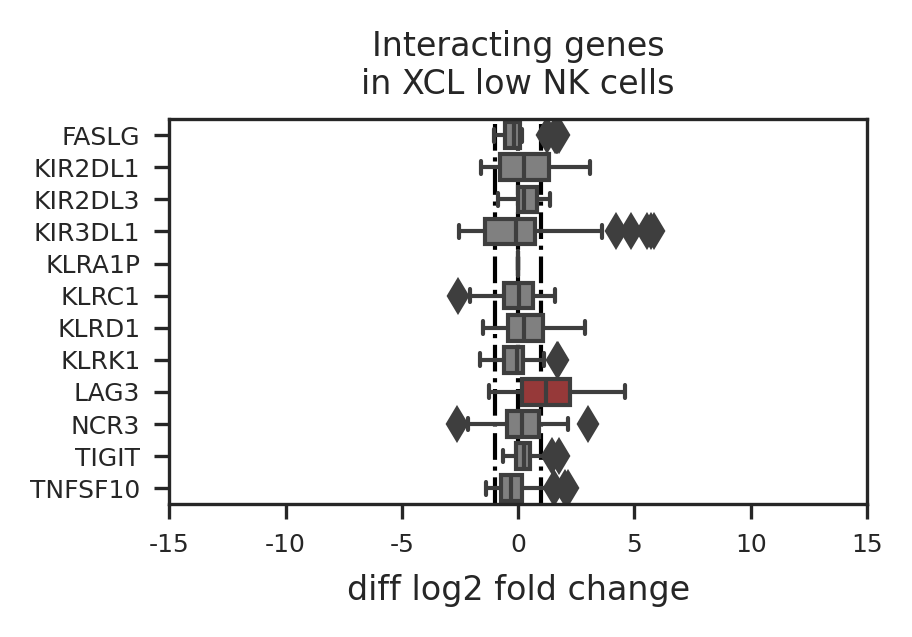

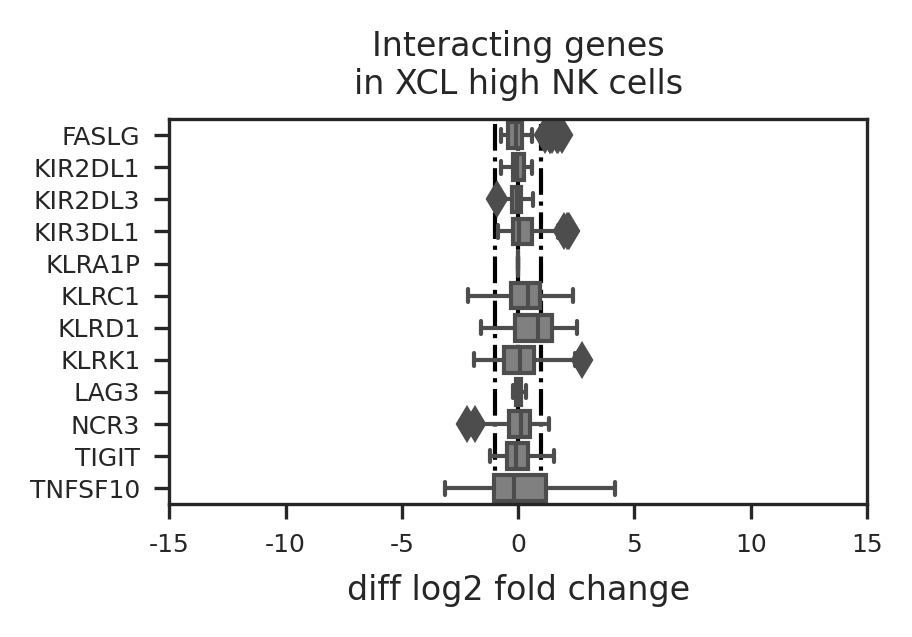

In [91]:
NK_gs = np.unique(it_df['genesymbol_intercell_source'])

NK_gs = [g for g in NK_gs if g in adata_kid.var_names]

pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], NK_gs, 'Interacting genes\nin XCL low NK cells', path=False)
pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], NK_gs, 'Interacting genes\nin XCL high NK cells', path=False)

# ######## mushroom plot/flower plot
# cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

# g = com_mushrooms(NK_gs, cst_plots)['figure']
# #g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

# g = com_flowers(NK_gs, cst_plots)['figure']
# #g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

# heatmap_cst(NK_gs, ['XCL_low NK cells', 'XCL_high NK cells'], 'Interacting genes', save_fd=False)

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 3000x2100 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Interacting ligands'}>}

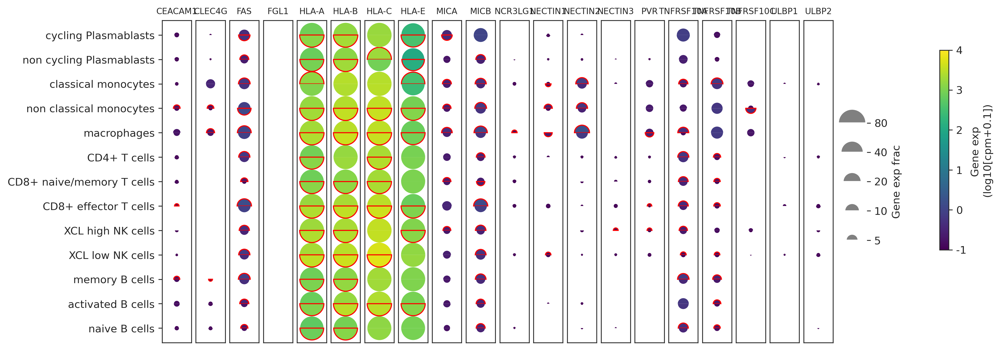

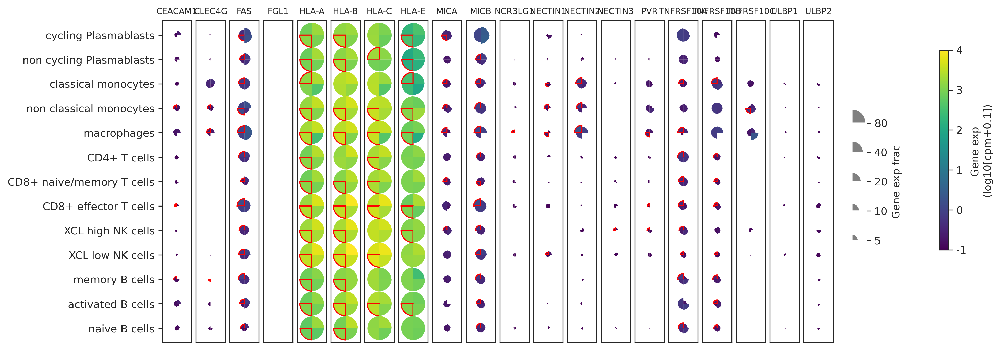

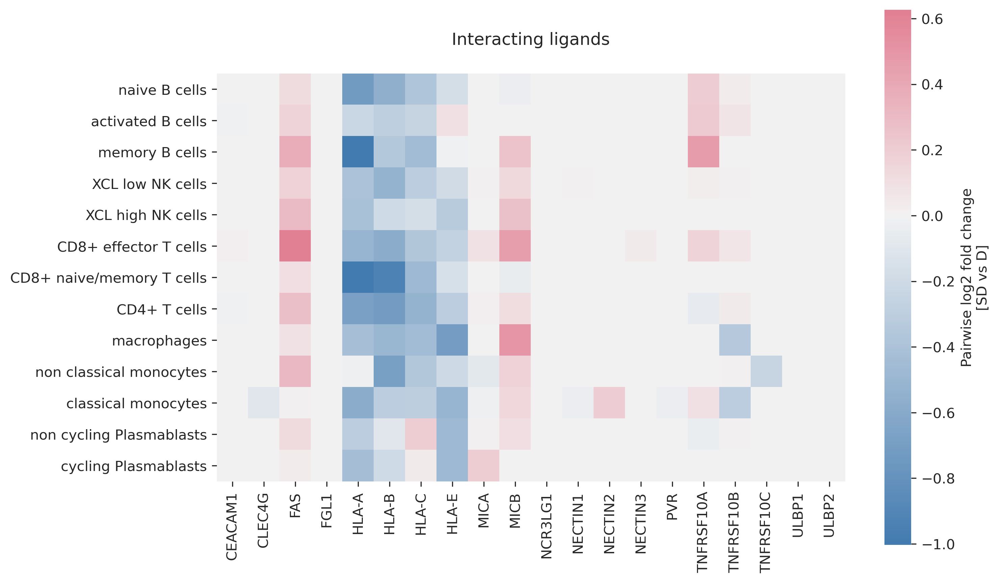

In [100]:
gs = np.unique(it_df['genesymbol_intercell_target'])

gs = [g for g in gs if g in adata_kid.var_names]

# pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], NK_gs, 'Interacting genes\nin XCL low NK cells', path=False)
# pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], NK_gs, 'Interacting genes\nin XCL high NK cells', path=False)

######## mushroom plot/flower plot
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(gs, csts, vmax=4)['figure']
#g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(gs, csts, vmax=4)['figure']
#g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(gs, csts, 'Interacting ligands', save_fd=False)

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 450x450 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Interacting ligands'}>}

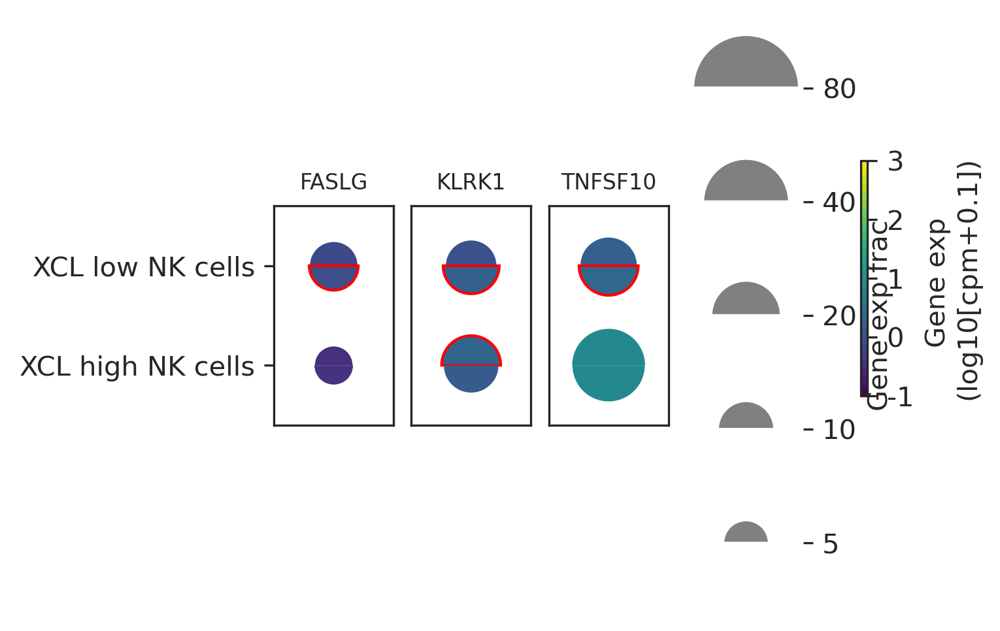

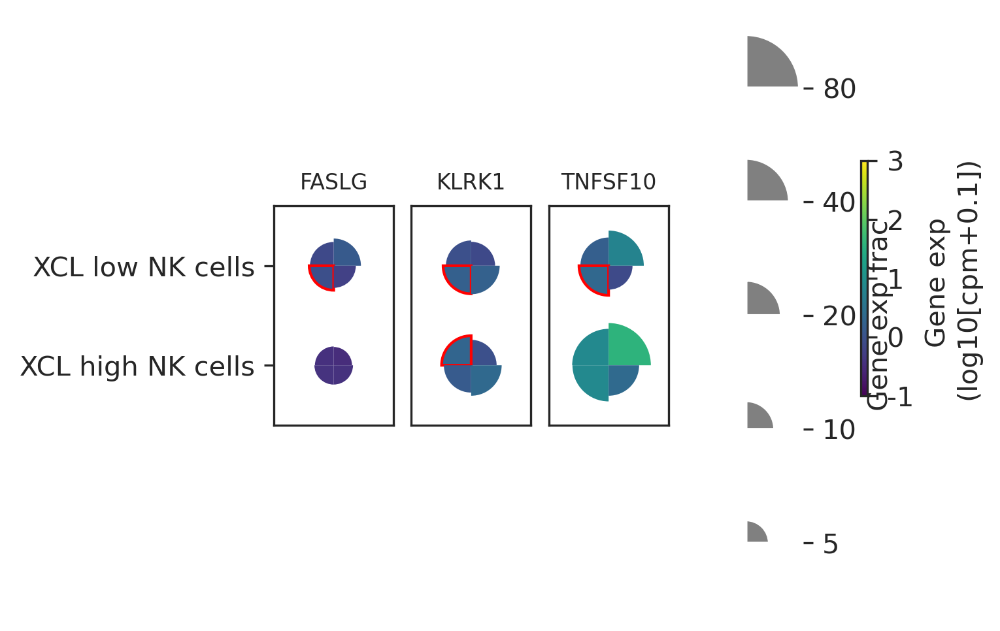

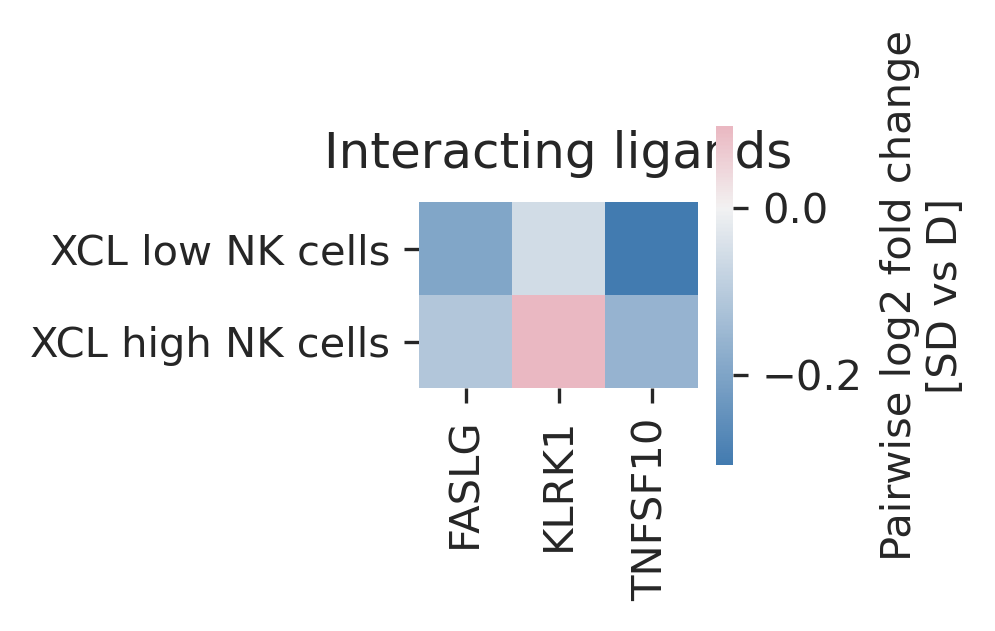

In [103]:
cst_plots = ['XCL_high NK cells', 'XCL_low NK cells',]

g = com_mushrooms(['FASLG', 'KLRK1', 'TNFSF10'], cst_plots)['figure']
#g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(['FASLG', 'KLRK1', 'TNFSF10'], cst_plots)['figure']
#g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(['FASLG', 'KLRK1', 'TNFSF10'], ['XCL_low NK cells', 'XCL_high NK cells',], 'Interacting ligands', save_fd=False)

{'figure': <Figure size 900x300 with 1 Axes>,
 'ax': <AxesSubplot:title={'center':'XCL high NK cells'}, xlabel='diff log2 fold change'>}

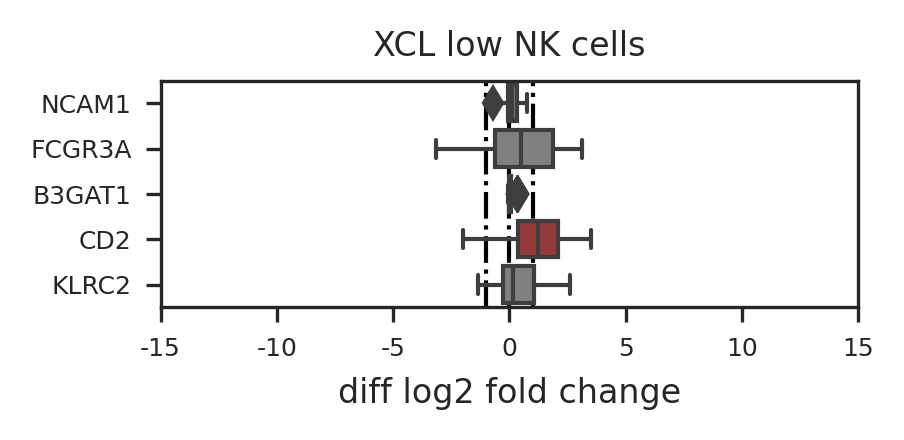

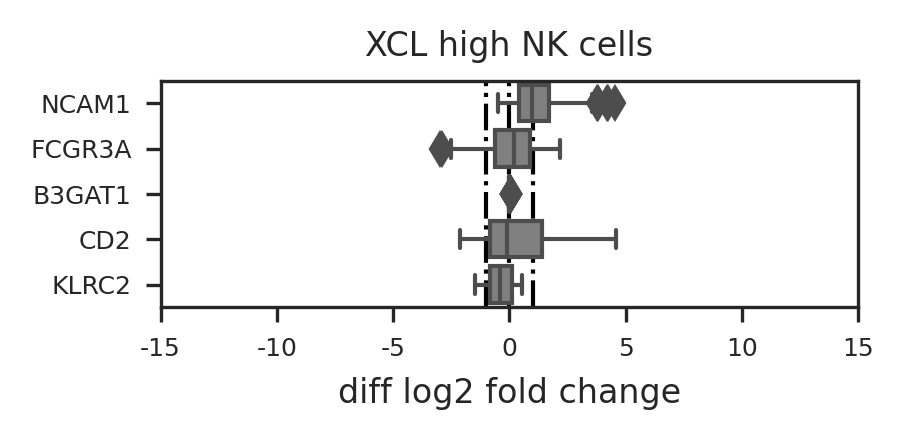

In [171]:
pairwise_boxplot(cst_log2FC.loc['XCL_low NK cells'], cst_pair.loc['XCL_low NK cells'], 
                 ['NCAM1', 'FCGR3A', 'B3GAT1', 'CD2', 'KLRC2'], 'XCL low NK cells', path=False)

pairwise_boxplot(cst_log2FC.loc['XCL_high NK cells'], cst_pair.loc['XCL_high NK cells'], 
                 ['NCAM1', 'FCGR3A', 'B3GAT1', 'CD2', 'KLRC2'], 'XCL high NK cells', path=False)


<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


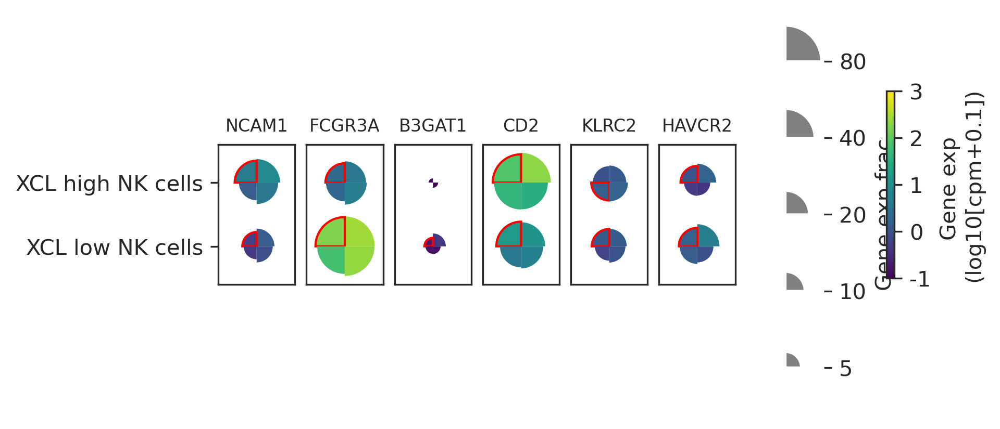

In [124]:
g = com_flowers(['NCAM1', 'FCGR3A', 'B3GAT1', 'CD2', 'KLRC2'],  ['XCL_low NK cells', 'XCL_high NK cells',])['figure']

<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


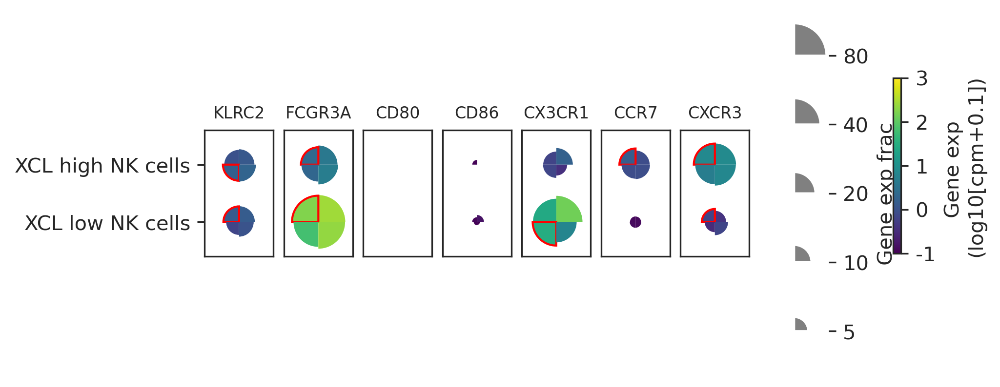

In [128]:
g = com_flowers(['KLRC2', 'FCGR3A', 'CD80', 'CD86', 'CX3CR1', 'CCR7', 'CXCR3'],  ['XCL_low NK cells', 'XCL_high NK cells',])['figure']

<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1500x1200 with 8 Axes>,
 'axs': [<AxesSubplot:title={'center':'GZMA'}>,
  <AxesSubplot:title={'center':'GZMB'}>,
  <AxesSubplot:title={'center':'GZMK'}>,
  <AxesSubplot:title={'center':'GZMH'}>,
  <AxesSubplot:title={'center':'PRF1'}>,
  <AxesSubplot:title={'center':'GNLY'}>,
  <AxesSubplot:ylabel='Gene exp frac'>]}

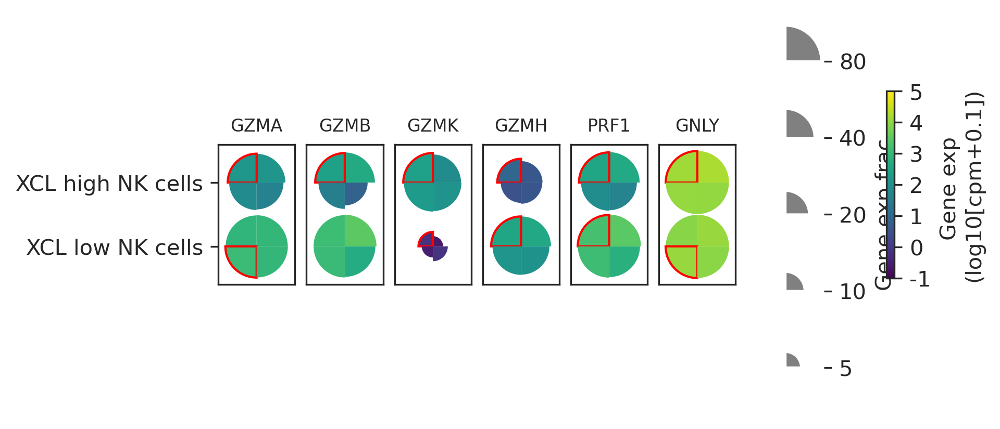

In [119]:
com_flowers(['GZMA', 'GZMB', 'GZMK', 'GZMH', 'PRF1', 'GNLY'],  ['XCL_low NK cells', 'XCL_high NK cells',], vmax=5
           )

In [111]:
cst_pair.loc[ ['XCL_low NK cells', 'XCL_high NK cells',]].reset_index().set_index('gene').loc[['NCAM1', 'FCGR3A']]

,cell_subtype,med_pair,fra_pair,neg_fra_pair,S_fra,NS_fra,S_avg,NS_avg,log2_fold_change,statistic,pvalue
gene,,,,,,,,,,,
NCAM1,XCL_low NK cells,0.100813,0.660714,0.339286,0.068944,0.049456,0.512143,0.359924,0.153069,0.019488,1.204048e-01
NCAM1,XCL_high NK cells,0.982762,0.875000,0.125000,0.286052,0.140481,4.430059,1.359195,1.202673,0.145571,1.444588e-06
FCGR3A,XCL_low NK cells,0.513424,0.589286,0.410714,0.751581,0.613884,177.329224,64.236755,1.450786,0.139685,3.878347e-63
FCGR3A,XCL_high NK cells,0.194100,0.589286,0.410714,0.187943,0.171904,2.156392,1.894807,0.124809,0.018554,9.997624e-01


In [41]:
def get_inters_fra_pair(sd_genes, cts, med_pair_cut_off, fra_pair_cut_off, fra_exp_cut_off):    
#    fn_int = '/home/yike/phd/dengue/data/interaction_source_file/omni_DB_inters.tsv'
    interactions = it_df
    genes = np.unique(interactions)
    genes = [gene for gene in genes if gene in adata_kid.var_names]

    #NK_data = pd.read_csv(save_tabels + 'data_SD_low_vs_high.tsv', sep='\t', index_col='gene')
    ct_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/ct_data_pair_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype', 'gene'])
    cst_pair = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_data_pair_gene_cut_0.tsv', 
                           sep='\t', index_col=['cell_subtype', 'gene'])
    
    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']
    
    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]
    
    res = []
    for _, row in interactions.iterrows():
        ga = row['genesymbol_intercell_source']
        gb = row['genesymbol_intercell_target']
        if (ga not in genes) | (gb not in genes):
            continue
        if (ga in sd_genes) | (gb in sd_genes):
            NK_g = ga
            ct_g = gb

            for ct in cts:
                data_ct = [ct_pair, cst_pair][ct not in cell_types]
                ct_med = {gene: data_ct.loc[ct, gene]['med_pair'] for gene in [ga, gb]}
                ct_fra_pair = {gene: data_ct.loc[ct, gene]['fra_pair'] for gene in [ga, gb]}
                ct_neg_fra_pair = {gene: data_ct.loc[ct, gene]['neg_fra_pair'] for gene in [ga, gb]}
                ct_fra = {(gene, cd): data_ct.loc[ct, gene][cd+'_fra'] for gene in [ga, gb] for cd in ['S', 'NS']}

                NK_inf = ([NK_g] +  
                          #NK_data.loc[NK_g][['log2_fold_change', 'low_fra', 'high_fra', 'low_avg', 'high_avg']].tolist() +
                cst_pair.loc['XCL_low NK cells', NK_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist() + 
                cst_pair.loc['XCL_high NK cells', NK_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist()
                         )
                ct_inf = [ct_g, ct] + data_ct.loc[ct, ct_g][['med_pair', 'fra_pair', 'neg_fra_pair', 'S_fra', 'NS_fra', 
                                                          'S_avg','NS_avg', 'log2_fold_change', 'pvalue']].tolist()

                if (((data_ct.loc[ct, ct_g]['med_pair'] >= med_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['fra_pair'] >= fra_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['S_fra'] >= fra_exp_cut_off)) |
                    ((data_ct.loc[ct, ct_g]['med_pair'] <= -med_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['neg_fra_pair'] >= fra_pair_cut_off) &
                     (data_ct.loc[ct, ct_g]['NS_fra'] >= fra_exp_cut_off))):

                    res.append(NK_inf + ct_inf)

    res = pd.DataFrame(res, columns=[
        'NK_gene', 
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_neg_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 'XCL_low_log2FC', 'XCL_low_pvalue',
        
        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_neg_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 'XCL_high_log2FC', 'XCL_high_pvalue',
        
        'im_gene', 'im_ct', 'im_med_pair', 'im_fra_pair','im_neg_fra_pair','im_SD_fra', 'im_D_fra',
        'im_SD_avg', 'im_D_avg', 'im_log2FC', 'im_pvalue']
                      )

    res.loc[(((res['XCL_low_med_pair'] >= med_pair_cut_off)) &
             (((res['XCL_high_med_pair'] < med_pair_cut_off) & (res['XCL_high_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_low_up'
    
    res.loc[(((res['XCL_low_med_pair'] <= -med_pair_cut_off)) &
             (((res['XCL_high_med_pair'] < med_pair_cut_off) & (res['XCL_high_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_low_down'
    
    res.loc[(((res['XCL_low_med_pair'] >= med_pair_cut_off)) &
             (((res['XCL_high_med_pair'] < med_pair_cut_off) & (res['XCL_high_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_low(up)_mix'
    
    res.loc[(((res['XCL_low_med_pair'] <= -med_pair_cut_off)) &
             (((res['XCL_high_med_pair'] < med_pair_cut_off) & (res['XCL_high_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_low(down)_mix'
    
    res.loc[(((res['XCL_high_med_pair'] >= med_pair_cut_off)) &
             (((res['XCL_low_med_pair'] < med_pair_cut_off) & (res['XCL_low_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_high_up'
    
    res.loc[(((res['XCL_high_med_pair'] <= -med_pair_cut_off)) &
             (((res['XCL_low_med_pair'] < med_pair_cut_off) & (res['XCL_low_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_high_down'
    
    res.loc[(((res['XCL_high_med_pair'] >= med_pair_cut_off)) &
             (((res['XCL_low_med_pair'] < med_pair_cut_off) & (res['XCL_low_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] < 0), 
            'inter_type'] = 'NK_high(up)_mix'
    
    res.loc[(((res['XCL_high_med_pair'] <= -med_pair_cut_off)) &
             (((res['XCL_low_med_pair'] < med_pair_cut_off) & (res['XCL_low_med_pair'] > -med_pair_cut_off)))) &
            (res['im_med_pair'] > 0), 
            'inter_type'] = 'NK_high(down)_mix'

    return res 

In [44]:

cts = ['B_cells', 'NK_cells', 'T_cells', 'Monocytes', 'Plasmablasts', 
       'plasmacytoid DCs', 'conventional DCs', 'megakaryocytes']

res = get_inters_fra_pair(['LAG3', 'KLRC1', 'KLRD1'], cts, med_pair_cut_off=0, fra_pair_cut_off=0, fra_exp_cut_off=0.02)
res = res[['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_med_pair', 'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]]
res.to_csv(save_tabels + 'Shirit_NK_inters.tsv', sep='\t', index=False)

cst_res = get_inters_fra_pair(['LAG3', 'KLRC1', 'KLRD1'], csts, med_pair_cut_off=0, fra_pair_cut_off=0, fra_exp_cut_off=0.02)
cst_res = cst_res[['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_med_pair', 'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_med_pair', 'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]]
cst_res.to_csv(save_tabels + 'Shirit_NK_cst_inters.tsv', sep='\t', index=False)

cols = ['NK_gene', 'im_gene', 'im_ct', 'inter_type', 
           
        'XCL_low_med_pair', 'XCL_high_med_pair', 'im_med_pair',
           
        'XCL_low_fra_pair', 'XCL_low_SD_fra', 'XCL_low_D_fra',
        'XCL_low_SD_avg', 'XCL_low_D_avg', 

        'XCL_high_fra_pair', 'XCL_high_SD_fra', 'XCL_high_D_fra',
        'XCL_high_SD_avg', 'XCL_high_D_avg', 

        'im_fra_pair','im_SD_fra', 'im_D_fra', 'im_SD_avg', 'im_D_avg',
       
        'XCL_low_neg_fra_pair', 'XCL_low_log2FC', 'XCL_low_pvalue',
           
        'XCL_high_neg_fra_pair', 'XCL_high_log2FC', 'XCL_high_pvalue',
           
        'im_neg_fra_pair', 'im_log2FC', 'im_pvalue', 
       ]
res = res[cols]
cst_res = cst_res[cols]

In [45]:
res

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
0,KLRC1,HLA-E,B_cells,NaN,0.028761,0.422011,-0.053945,0.500000,0.224858,0.218013,...,1033.222534,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.535714,-0.097972,2.448200e-04
1,KLRC1,HLA-E,NK_cells,NaN,0.028761,0.422011,-0.173116,0.500000,0.224858,0.218013,...,1587.294434,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.785714,-0.153753,2.602592e-20
2,KLRC1,HLA-E,T_cells,NaN,0.028761,0.422011,-0.344128,0.500000,0.224858,0.218013,...,1054.245239,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.767857,-0.265175,5.136739e-27
3,KLRC1,HLA-E,Monocytes,NaN,0.028761,0.422011,-0.551099,0.500000,0.224858,0.218013,...,405.555328,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.642857,-0.064962,7.550990e-12
4,KLRC1,HLA-E,Plasmablasts,NaN,0.028761,0.422011,-0.534900,0.500000,0.224858,0.218013,...,153.057022,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.656250,-0.249445,5.007887e-53
5,KLRC1,HLA-E,plasmacytoid DCs,NaN,0.028761,0.422011,-0.770884,0.500000,0.224858,0.218013,...,285.004303,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.625000,-0.477636,8.501504e-03
6,KLRC1,HLA-E,conventional DCs,NaN,0.028761,0.422011,-0.226880,0.500000,0.224858,0.218013,...,185.524765,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.555556,0.154200,2.298127e-01
7,KLRC1,HLA-E,megakaryocytes,NaN,0.028761,0.422011,0.150866,0.500000,0.224858,0.218013,...,2748.207275,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.416667,0.622261,4.458019e-01
8,KLRD1,HLA-E,B_cells,NaN,0.231537,0.866355,-0.053945,0.571429,0.854997,0.820894,...,1033.222534,0.428571,0.430130,4.956815e-14,0.267857,0.816657,0.000940,0.535714,-0.097972,2.448200e-04
9,KLRD1,HLA-E,NK_cells,NaN,0.231537,0.866355,-0.173116,0.571429,0.854997,0.820894,...,1587.294434,0.428571,0.430130,4.956815e-14,0.267857,0.816657,0.000940,0.785714,-0.153753,2.602592e-20


In [46]:
cst_res

,NK_gene,im_gene,im_ct,inter_type,XCL_low_med_pair,XCL_high_med_pair,im_med_pair,XCL_low_fra_pair,XCL_low_SD_fra,XCL_low_D_fra,...,im_D_avg,XCL_low_neg_fra_pair,XCL_low_log2FC,XCL_low_pvalue,XCL_high_neg_fra_pair,XCL_high_log2FC,XCL_high_pvalue,im_neg_fra_pair,im_log2FC,im_pvalue
0,KLRC1,HLA-E,naive B cells,NaN,0.028761,0.422011,-0.168337,0.500000,0.224858,0.218013,...,936.785767,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.607143,0.027830,9.039076e-01
1,KLRC1,HLA-E,activated B cells,NaN,0.028761,0.422011,0.095119,0.500000,0.224858,0.218013,...,1261.686157,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.464286,-0.406727,4.146579e-11
2,KLRC1,HLA-E,memory B cells,NaN,0.028761,0.422011,-0.011470,0.500000,0.224858,0.218013,...,1078.648804,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.500000,0.065624,6.086105e-01
3,KLRC1,HLA-E,XCL_low NK cells,NaN,0.028761,0.422011,-0.188994,0.500000,0.224858,0.218013,...,1607.062500,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.678571,-0.122923,3.310264e-14
4,KLRC1,HLA-E,XCL_high NK cells,NaN,0.028761,0.422011,-0.323715,0.500000,0.224858,0.218013,...,1297.952515,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.696429,-0.227354,4.785166e-03
5,KLRC1,HLA-E,CD8+ effector T cells,NaN,0.028761,0.422011,-0.264831,0.500000,0.224858,0.218013,...,1078.177124,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.687500,-0.597125,7.671850e-18
6,KLRC1,HLA-E,CD8+ naive/memory T cells,NaN,0.028761,0.422011,-0.154872,0.500000,0.224858,0.218013,...,1037.823486,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.589286,0.001403,1.386316e-05
7,KLRC1,HLA-E,CD4+ T cells,NaN,0.028761,0.422011,-0.314219,0.500000,0.224858,0.218013,...,1049.263184,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.696429,-0.142545,2.185361e-11
8,KLRC1,HLA-E,macrophages,NaN,0.028761,0.422011,-0.705880,0.500000,0.224858,0.218013,...,863.447937,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.693878,-0.276152,6.506875e-06
9,KLRC1,HLA-E,non_classical monocytes,NaN,0.028761,0.422011,-0.206055,0.500000,0.224858,0.218013,...,1160.647949,0.500000,0.038440,6.476469e-01,0.339286,0.487554,0.221549,0.583333,-0.375165,1.444218e-02


In [60]:
it_df[it_df['genesymbol_intercell_source'] == 'KLRD1']

,genesymbol_intercell_source,genesymbol_intercell_target
32,KLRD1,HLA-E
33,KLRD1,NECTIN1
34,KLRD1,PVR


<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 300x2100 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Ligands of LAG3'}>}

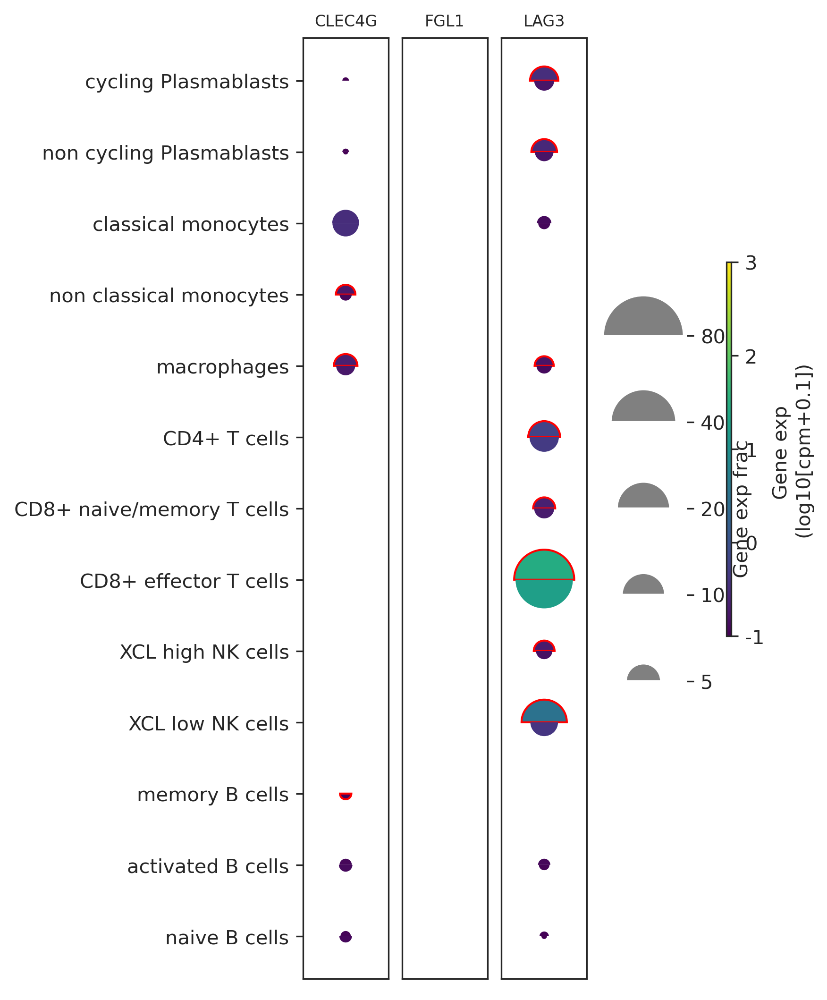

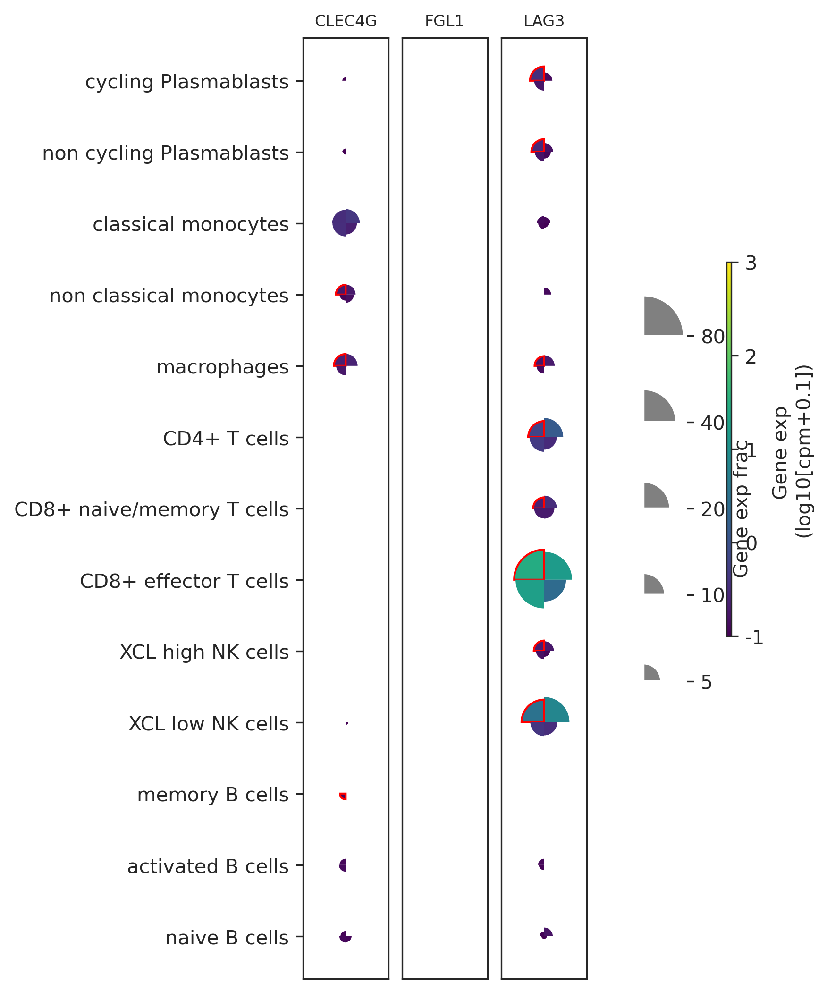

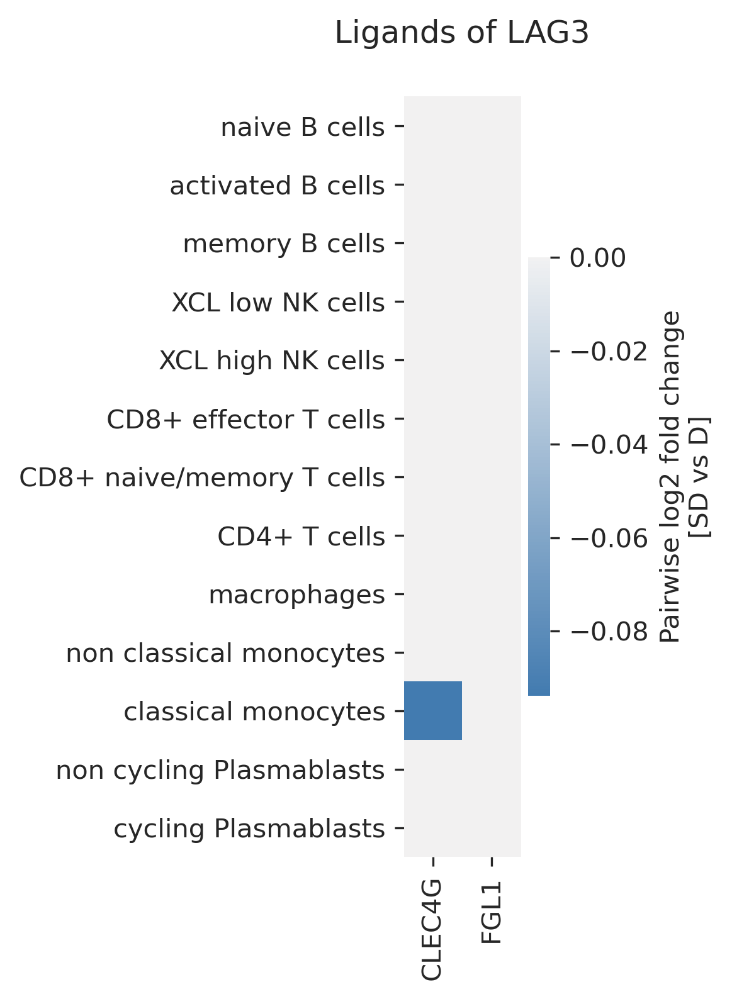

In [52]:
g = com_mushrooms(['CLEC4G', 'FGL1', 'LAG3'], csts)['figure']
#g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(['CLEC4G', 'FGL1', 'LAG3'], csts)['figure']
#g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(['CLEC4G', 'FGL1'], csts, 'Ligands of LAG3', save_fd=False)

<ipython-input-7-936347eedb58>:456: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
<ipython-input-7-936347eedb58>:619: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 750x2100 with 2 Axes>,
 'ax': <AxesSubplot:title={'center':'Ligands of KLRs'}>}

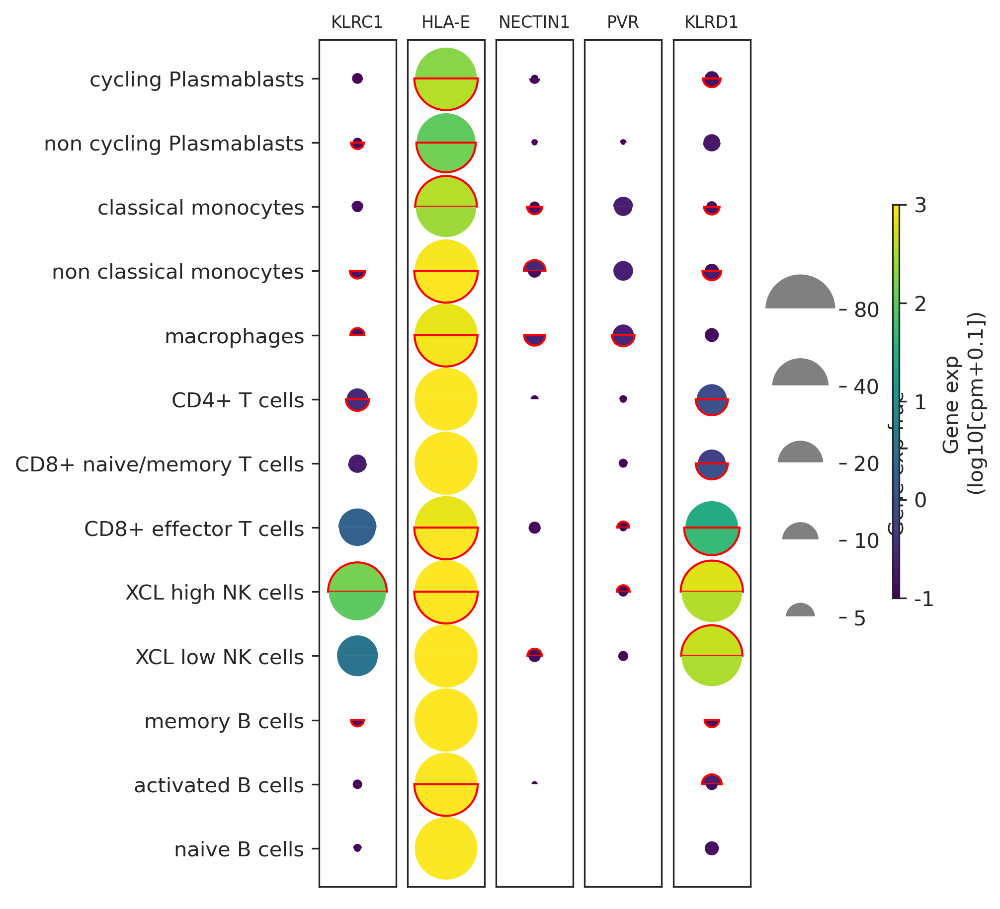

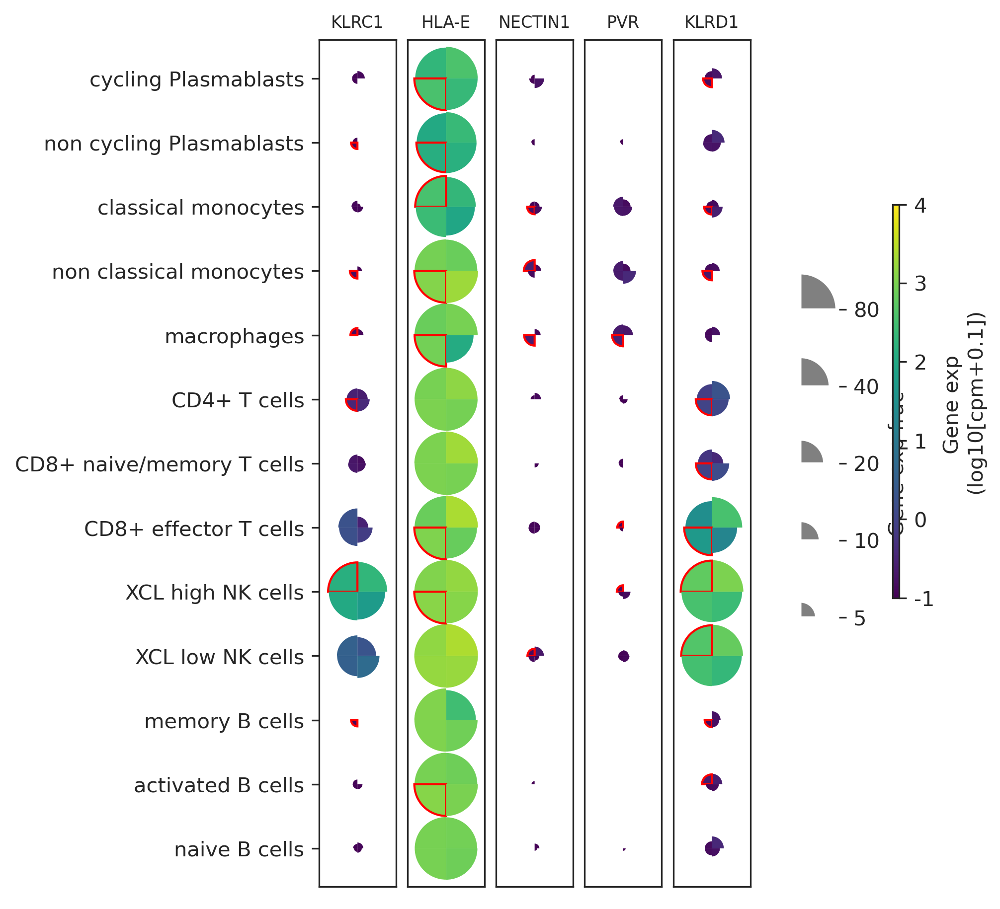

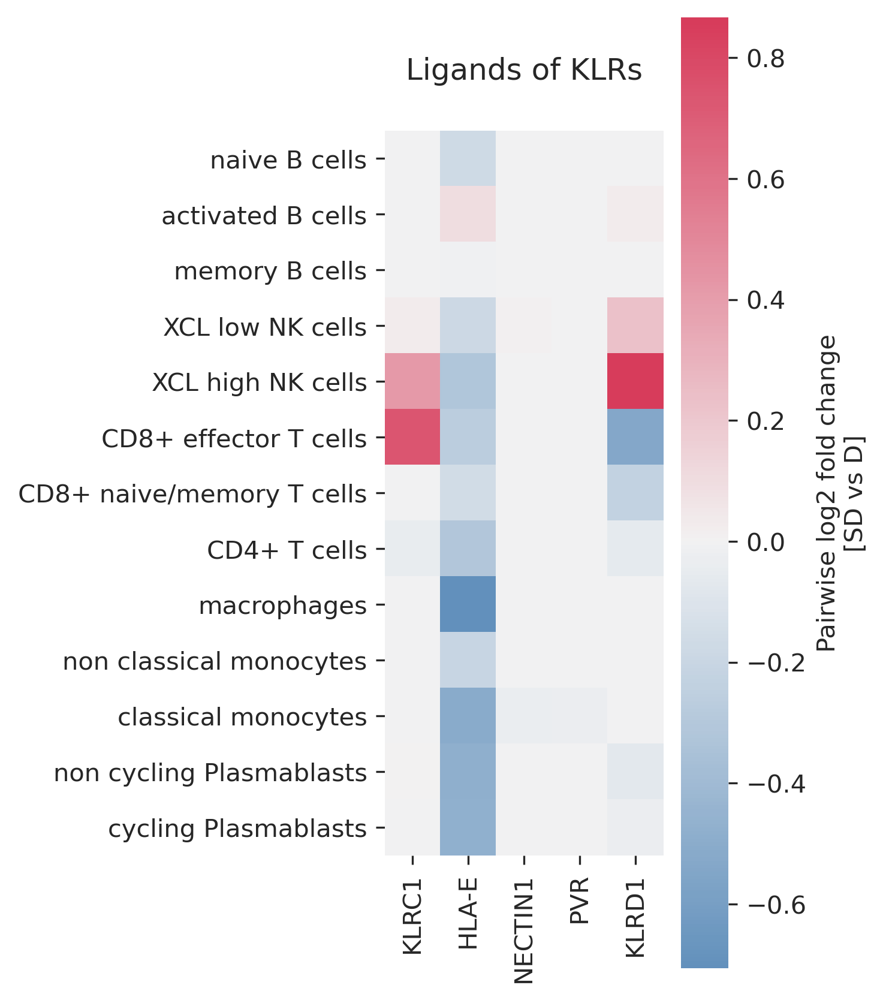

In [64]:
g = com_mushrooms(['KLRC1', 'HLA-E', 'NECTIN1', 'PVR', 'KLRD1'], csts)['figure']
#g.savefig(save_figures + 'interacting_genes/mush_up_DEGs_high.png', bbox_inches='tight')

g = com_flowers(['KLRC1', 'HLA-E', 'NECTIN1', 'PVR', 'KLRD1'], csts, vmax=4)['figure']
#g.savefig(save_figures + 'interacting_genes/flow_up_DEGs_high.png', bbox_inches='tight')

heatmap_cst(['KLRC1', 'HLA-E', 'NECTIN1', 'PVR', 'KLRD1'], csts, 'Ligands of KLRs', save_fd=False)

# MHC class I

In [40]:
def pizza_plot(genes, cst_plots, vmax=3):

    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin = 2
    # vmax = 3
    #threshold = 0.05

    #save_tabels = '/home/yike/phd/dengue/data/tables/dataset_20211001/'
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_fra_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'ct_avg_gene_cut_0.tsv', 
                         sep='\t', index_col=['cell_type_new', 'condition', 'gene'], squeeze=True)

    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_fra_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/dataset_20211001/' + 'cst_avg_gene_cut_0.tsv', 
                          sep='\t', index_col=['cell_subtype_new', 'condition', 'gene'], squeeze=True)

    if len(cst_plots) < 5:
        length = 5
    else:
        length = len(cst_plots)

    fig = plt.figure(figsize=(2 + 0.5 * len(genes), 1 + length * 0.6), dpi=300)
    grid = plt.GridSpec(1 , len(genes), wspace=0.15, hspace=0.1)

    cell_types = ['B_cells',
                 'T_cells',
                 'NK_cells',
                 'Monocytes',
                 'Plasmablasts',
                 'plasmacytoid DCs',
                 'conventional DCs',
                 'megakaryocytes']

    cell_subtypes = ['naive B cells',
                     'activated B cells',
                     'memory B cells',
                     'XCL_low NK cells',
                     'XCL_high NK cells',
                     'CD8+ effector T cells',
                     'CD8+ naive/memory T cells',
                     'CD4+ T cells',
                     'macrophages',
                     'non_classical monocytes',
                     'classical monocytes',
                     'non_cycling Plasmablasts',
                     'cycling Plasmablasts',
                     ]
    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[0: len(cst_plots), i: i+1]))

    #axs.append(plt.subplot(grid[0: 5, len(genes): len(genes) + 1])) # size_bar
    #axs.append(plt.subplot(grid[0: 2, len(genes) + 1: len(genes) + 2])) # color_bar

    for gene, ax in zip(genes, axs):
        datap = []
        yticklabels = []
        for cst in cst_plots:
            avgs = []
            yticklabels.append(cst.replace('_', ' '))
            for k, cond in enumerate(['S_dengue', 'dengue', 'Healthy']): 
                #fr = [frac_cst, frac_ct][cst in cell_types].loc[(cst, cond, gene)]
                av = np.log10([avg_cst, avg_ct][cst in cell_types].loc[(cst, cond, gene)] + 0.1)
   
                avgs.append(av)   
                #r = 0.5 * fr ** 0.3
                color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                theta0, theta1 = 120 * k, 120 * (k + 1)
                datap.append({
                #    'r': r,
                    'facecolor': color,
                    'center': (0, len(yticklabels)-1),
                    'theta': (theta0, theta1),
                    'ax': ax,
                    'edgecolor': 'none'
                }) 

            if max(avgs) == avgs[0]:
                datap[-3]['edgecolor'] = 'red'
                for kk in [-1, -2]:
                    datap[kk]['edgecolor'] = 'none'
            elif max(avgs) == avgs[1]:
                datap[-2]['edgecolor'] = 'red'
                for kk in [-3, -1]:
                    datap[kk]['edgecolor'] = 'none'
            else:
                datap[-1]['edgecolor'] = 'red'
                for kk in [-3, -2]:
                    datap[kk]['edgecolor'] = 'none'

        ax.set_title(gene, fontsize=8)

        if ax == axs[0]:
            ax.set_yticks(np.arange(len(cst_plots)))
            ax.set_yticklabels(yticklabels, fontsize=10)
        else:
            ax.set_yticks([])
            ax.set_yticklabels([])

        ax.set_ylim(-0.6, len(cst_plots) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

        for datum in datap:
            ax = datum['ax']
            # r = datum['r']
            color = datum['facecolor']
            center = datum['center']
            theta0, theta1 = datum['theta']
            ec = datum['edgecolor']

            h = Wedge(
                center, 0.45, theta0, theta1, facecolor=color, edgecolor=ec
            )
            ax.add_artist(h)
            ax.set_aspect(1)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.98, 0.4, 0.01, 0.3]) 
    # The dimensions [left, bottom, width, height] of the new Axes.
    # All quantities are in fractions of figure width and height.
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[-1], cax=position, 
                        label='Gene exp \n(log10[cpm+0.1])')
    cbar.set_ticks(range(-1, vmax+1))
    cbar.set_ticklabels(range(-1, vmax+1))

    fig.tight_layout()
    
    return {'figure': fig, 'axs': axs}

<ipython-input-40-764524e572b8>:139: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'figure': <Figure size 1200x3000 with 5 Axes>,
 'axs': [<AxesSubplot:title={'center':'HLA-A'}>,
  <AxesSubplot:title={'center':'HLA-B'}>,
  <AxesSubplot:title={'center':'HLA-C'}>,
  <AxesSubplot:title={'center':'HLA-E'}>]}

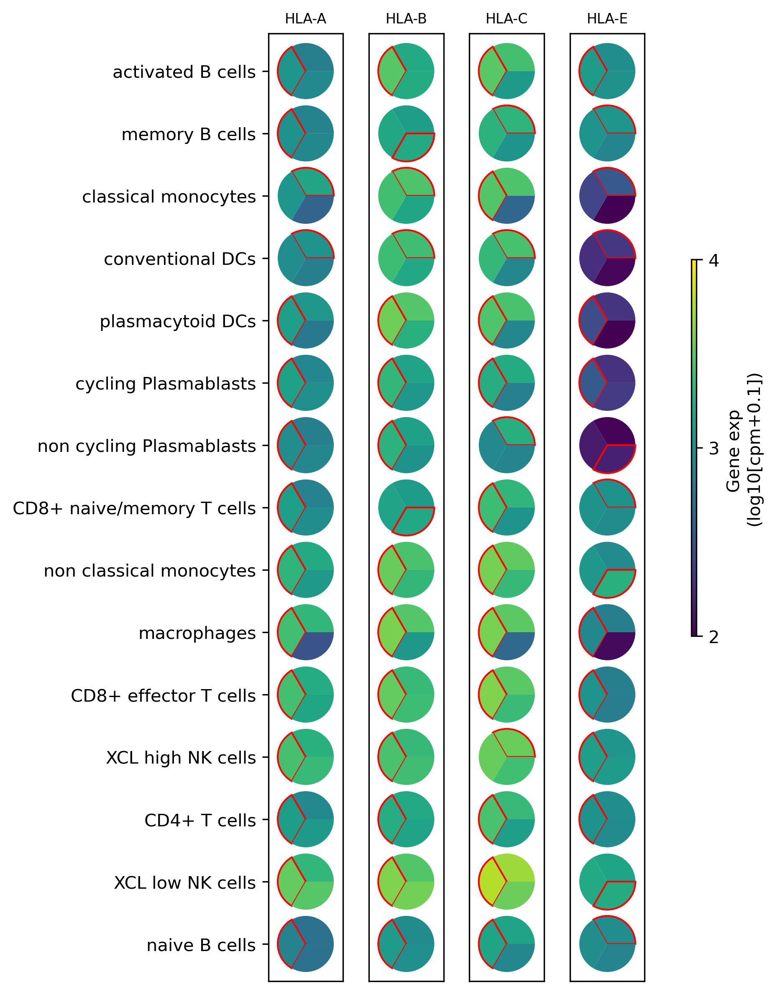

In [41]:
cst_plots = adata_kid.obs['cell_subtype_new'].unique().tolist()
cst_plots.remove('megakaryocytes')
cst_plots.remove('unknown')
cst_plots.remove('doublets')
pizza_plot(['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E'], cst_plots, vmax=4)